In [1]:
!nvidia-smi

Mon Sep  9 16:57:39 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.147.05   Driver Version: 525.147.05   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A5000    Off  | 00000000:17:00.0 Off |                  Off |
| 30%   34C    P8    25W / 230W |      6MiB / 24564MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA RTX A5000    Off  | 00000000:65:00.0 Off |                  Off |
| 30%   

In [2]:
import tensorflow as tf

RESTRICT_GPU = False

if RESTRICT_GPU:
    gpus = tf.config.list_physical_devices('GPU')

    if gpus:
        # Restrict TensorFlow to only use a chosen GPU
        try:
            tf.config.set_visible_devices(gpus[1], 'GPU') # NB: I (Ferdinand) only use gpus[0], so gpus[1] should be free
            logical_gpus = tf.config.list_logical_devices('GPU')
            print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPU")
        except RuntimeError as e:
            # Visible devices must be set before GPUs have been initialized
            print(e)

2024-09-09 16:57:40.108350: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-09 16:57:40.143653: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-09 16:57:40.143684: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-09 16:57:40.143714: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-09 16:57:40.150856: I tensorflow/core/platform/cpu_feature_g

2 Physical GPUs, 1 Logical GPU


2024-09-09 16:57:42.176937: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1886] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22282 MB memory:  -> device: 1, name: NVIDIA RTX A5000, pci bus id: 0000:65:00.0, compute capability: 8.6


In [1]:
# From the git
import sys
sys.path.append('.')
sys.path.append('..')

In [2]:
import math
import matplotlib.pyplot as plt
import numpy as np
import scipy

import tensorflow as tf
import tensorflow_addons as tfa
from tensorflow import keras
from tensorflow.keras import layers, losses
from tensorflow.keras.models import Model
from keras import layers

from data.load_data import load_data
from utils.visualisation import get_color_map

/usr/local/lib/python3.8/dist-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Data

In [3]:
# Useful constants

nb_categories = 4
image_size = (64, 128)

cmap, norm = get_color_map(number_of_categories=nb_categories)

facies_names = np.array(["Sand, Channel lag", "Sand, Point bar", "Silts, Levee", "Shale, Overbank"])

In [4]:
x = load_data(image_size[0], image_size[1], "../data/horizontal/dataFlumyHoriz.csv")
print(x.shape)

x_train = tf.cast(x[:2760], dtype=tf.float64)
x_test = tf.cast(x[2760:], dtype=tf.float64)

print(x_train.dtype)

(3000, 64, 128, 4)
<dtype: 'float64'>


## Q Matrix & Forward process Imports and Tests

In [5]:
from noising_markov_jump_process.noising_process import *

In [6]:
input_diffusion_times = np.ones((x_test.shape[0], 1, 1, 1), dtype=np.float64) * 0.999

def apply_forward(x0, t):
    return forward_process(x0, t, nb_categories)

modified_batch, _ = tf.map_fn(lambda x: apply_forward(x[0], x[1]), (x_test, input_diffusion_times))

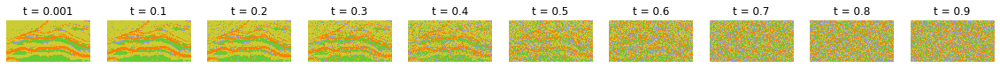

In [7]:
steps = [0.001, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

plt.figure(figsize=(20, 40))
for i, t in enumerate(steps):
    
    xt, _ = forward_process(x_test[5], tf.ones((1), dtype=tf.dtypes.float64) * t, nb_categories)

    plt.subplot(1, len(steps), i+1)
    plt.title("t = {}".format(t))
    plt.imshow(np.argmax(xt.numpy(), axis=-1).reshape((64, 128)),
                interpolation='nearest', cmap=cmap, norm=norm)
    plt.axis('off')
    
plt.show()

## Models

In [ ]:
from models.conditional_mkj.diffusion_model import DiffusionModel

In [48]:
# create and compile the model
model = DiffusionModel(image_size, widths, block_depth, categories_nb=categories_nb, large_model=True)

learning_rate = 1e-5


model.compile(
    optimizer=tf.keras.optimizers.Adam(
        learning_rate=learning_rate
    ),
    loss= tf.keras.losses.CategoricalCrossentropy(),

)

In [49]:
if False:
    model.network.load_weights("unet_discrete_jump_markov_weights_conditional/cp-unet_discrete_jump_markov.ckpt")
    model.load_weights("ddm_discrete_jump_markov_weights_conditional/cp-ddm_discrete_jump_markov.ckpt")
    

In [50]:
t_epochs_nb=650
 
history = model.fit(x_train, batch_size=batch_size, shuffle=True, epochs=t_epochs_nb, validation_data=(x_test,))

Epoch 1/500


2024-09-09 17:04:51.563927: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inunet/ResBlock-Down-0-0-Dropout1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2024-09-09 17:04:59.390974: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8700
2024-09-09 17:05:02.563186: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7efb6c01b490 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-09-09 17:05:02.563219: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA RTX A5000, Compute Capability 8.6
2024-09-09 17:05:02.570747: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-09-09 17:05:02.685780: I ./tensorflow/compiler/jit/device_compiler.h:186

92/92 [==============================] - 178s 911ms/step - i_loss: 1.1789 - post_loss: 0.3579 - val_i_loss: 0.7189 - val_post_loss: 0.2093
Epoch 2/500
92/92 [==============================] - 72s 778ms/step - i_loss: 0.6416 - post_loss: 0.1974 - val_i_loss: 0.5917 - val_post_loss: 0.1656
Epoch 3/500
92/92 [==============================] - 72s 782ms/step - i_loss: 0.5835 - post_loss: 0.1722 - val_i_loss: 0.5675 - val_post_loss: 0.1793
Epoch 4/500
92/92 [==============================] - 72s 784ms/step - i_loss: 0.5602 - post_loss: 0.1663 - val_i_loss: 0.5428 - val_post_loss: 0.1705
Epoch 5/500
92/92 [==============================] - 72s 782ms/step - i_loss: 0.5435 - post_loss: 0.1556 - val_i_loss: 0.5390 - val_post_loss: 0.1581
Epoch 6/500
92/92 [==============================] - 72s 780ms/step - i_loss: 0.5312 - post_loss: 0.1569 - val_i_loss: 0.5374 - val_post_loss: 0.1621
Epoch 7/500
92/92 [==============================] - 72s 782ms/step - i_loss: 0.5271 - post_loss: 0.1531 - val_

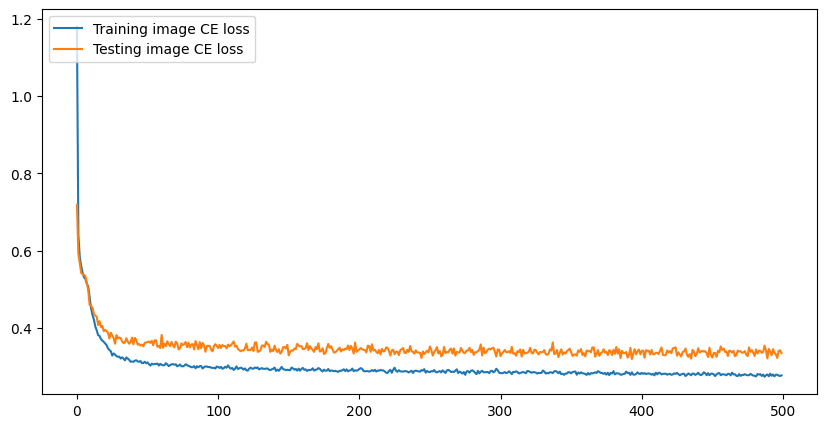

In [51]:
x_axis = np.arange(t_epochs_nb)
plt.figure(figsize=(10, 5))
plt.plot(x_axis, history.history["i_loss"], label="Training image CE loss")
plt.plot(x_axis, history.history["val_i_loss"], label="Testing image CE loss")
plt.legend(loc="upper left")
plt.show()

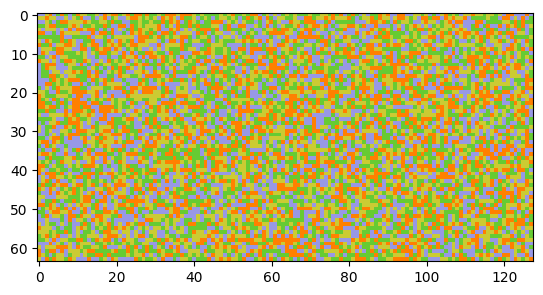

i: 0, step: 0.98


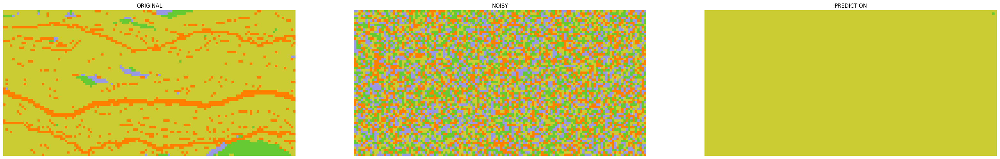

tf.Tensor([[[[0.98]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.97]]]]
pxt:  tf.Tensor([0.16514289 0.16529667 0.5044275  0.16513294], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 1, step: 0.97


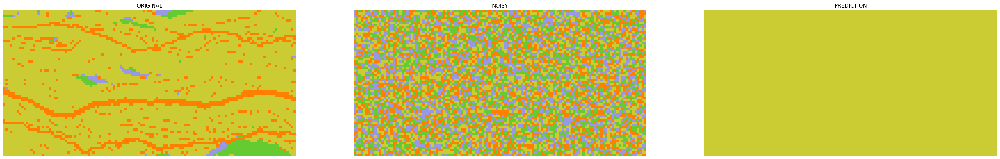

tf.Tensor([[[[0.97]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.96]]]]
pxt:  tf.Tensor([0.13382296 0.13405368 0.59832928 0.13379408], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 2, step: 0.96


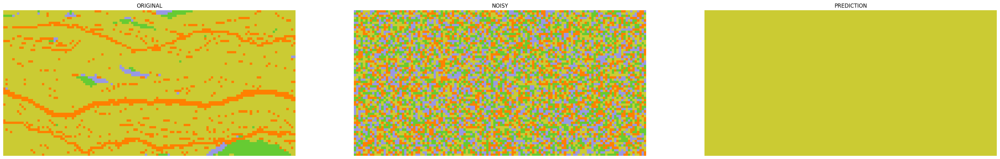

tf.Tensor([[[[0.96]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.95]]]]
pxt:  tf.Tensor([0.11196777 0.11235636 0.66373619 0.11193968], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 3, step: 0.9500000000000001


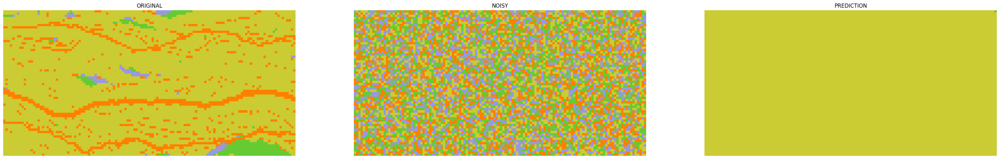

tf.Tensor([[[[0.95]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.94]]]]
pxt:  tf.Tensor([0.09605538 0.0966287  0.71129249 0.09602343], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 4, step: 0.9400000000000001


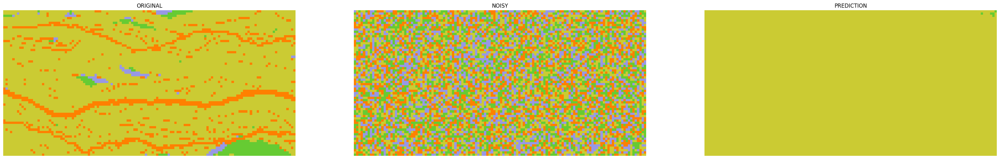

tf.Tensor([[[[0.94]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.93]]]]
pxt:  tf.Tensor([0.0840335  0.08474746 0.74724894 0.08397011], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 5, step: 0.93


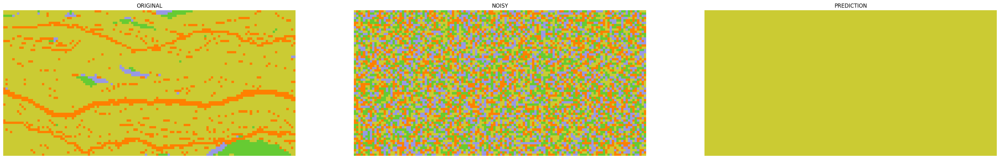

tf.Tensor([[[[0.93]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.92]]]]
pxt:  tf.Tensor([0.07401979 0.77815076 0.07389779 0.07393167], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([1. 0. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 6, step: 0.92


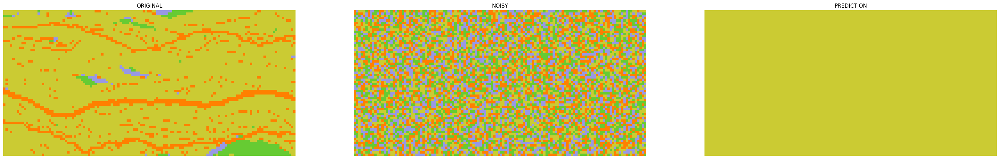

tf.Tensor([[[[0.92]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.91]]]]
pxt:  tf.Tensor([0.7982601  0.06801399 0.06685297 0.06687294], shape=(4,), dtype=float64)
xt:  tf.Tensor([1. 0. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 7, step: 0.91


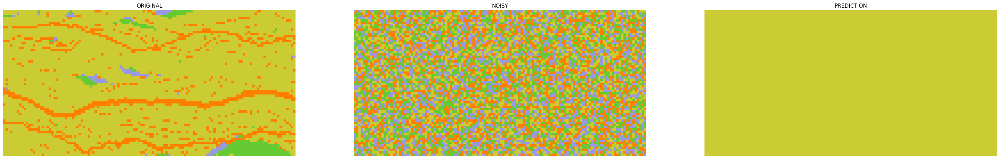

tf.Tensor([[[[0.91]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.9]]]]
pxt:  tf.Tensor([0.06096191 0.06206608 0.81616043 0.06081158], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 8, step: 0.9


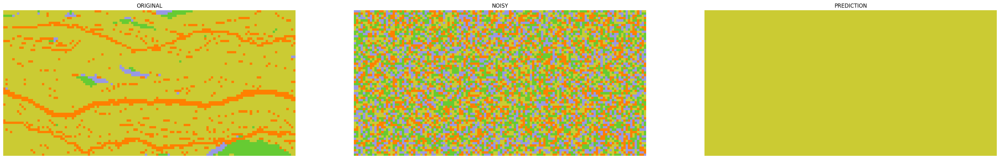

tf.Tensor([[[[0.9]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.89]]]]
pxt:  tf.Tensor([0.05577302 0.0571714  0.83145368 0.0556019 ], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 9, step: 0.89


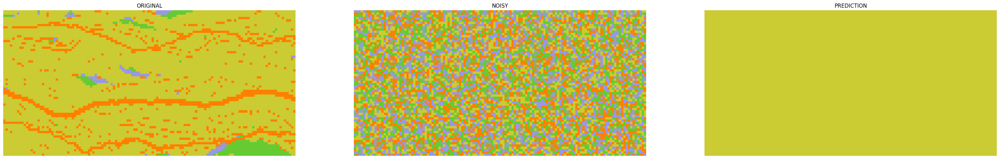

tf.Tensor([[[[0.89]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.88]]]]
pxt:  tf.Tensor([0.05140944 0.05298166 0.84437748 0.05123142], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 10, step: 0.88


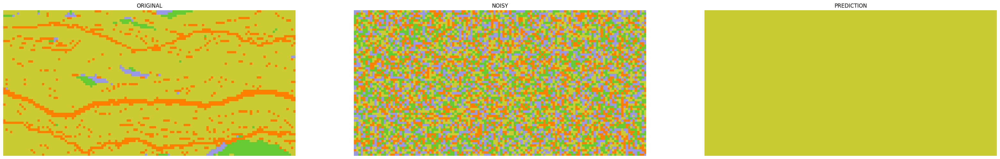

tf.Tensor([[[[0.88]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.87]]]]
pxt:  tf.Tensor([0.04763675 0.04948581 0.85542165 0.0474558 ], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 11, step: 0.87


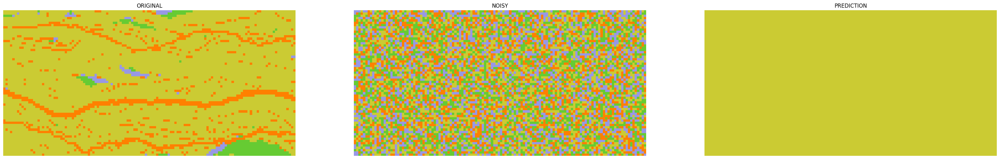

tf.Tensor([[[[0.87]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.86]]]]
pxt:  tf.Tensor([0.04435687 0.04661941 0.86486224 0.04416148], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 12, step: 0.86


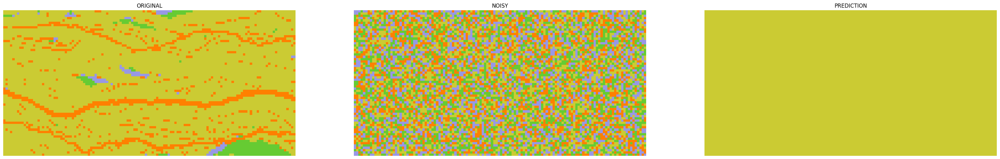

tf.Tensor([[[[0.86]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.85]]]]
pxt:  tf.Tensor([0.04147747 0.04404796 0.87318013 0.04129444], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 1. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 13, step: 0.85


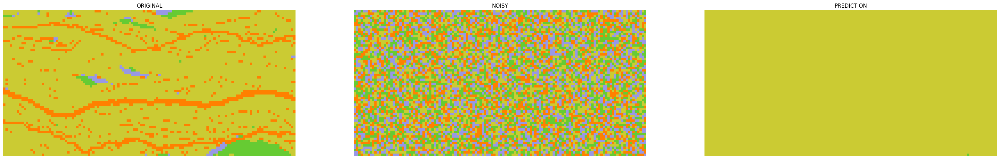

tf.Tensor([[[[0.85]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.84]]]]
pxt:  tf.Tensor([0.03889116 0.04177642 0.0386109  0.88072152], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 14, step: 0.84


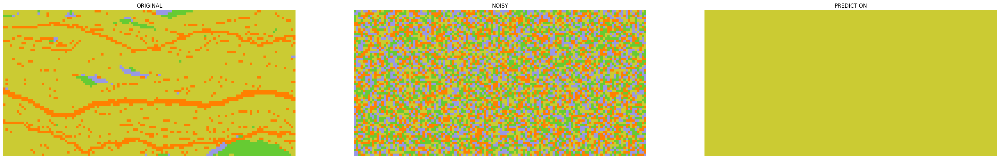

tf.Tensor([[[[0.84]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.83]]]]
pxt:  tf.Tensor([0.03669956 0.03996494 0.03635705 0.88697846], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 15, step: 0.8300000000000001


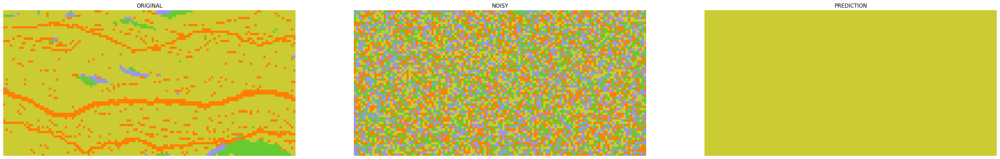

tf.Tensor([[[[0.83]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.82]]]]
pxt:  tf.Tensor([0.03469752 0.03830533 0.03431327 0.89268388], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 16, step: 0.8200000000000001


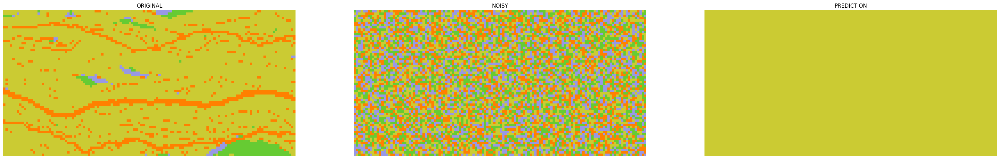

tf.Tensor([[[[0.82]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.81]]]]
pxt:  tf.Tensor([0.03289348 0.03699301 0.03247909 0.89763442], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 17, step: 0.81


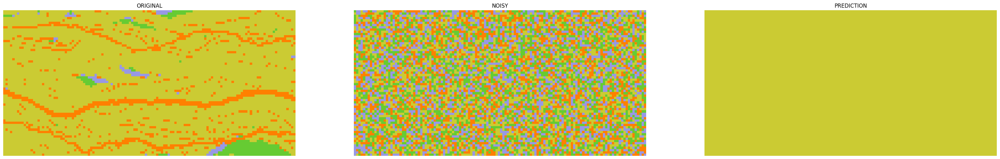

tf.Tensor([[[[0.81]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.8]]]]
pxt:  tf.Tensor([0.03130119 0.03561446 0.03080997 0.90227437], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 18, step: 0.8


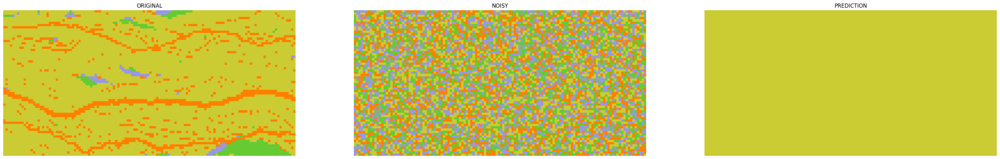

tf.Tensor([[[[0.8]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.79]]]]
pxt:  tf.Tensor([0.02984898 0.03443812 0.02930889 0.90640401], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 19, step: 0.79


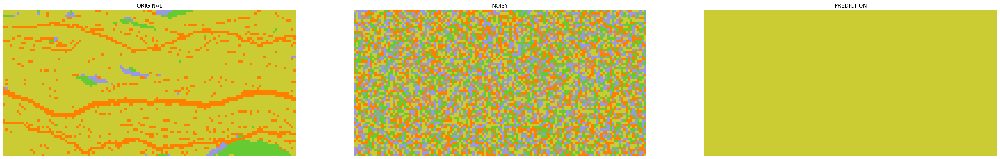

tf.Tensor([[[[0.79]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.78]]]]
pxt:  tf.Tensor([0.02413596 0.92842048 0.02369957 0.02374398], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 20, step: 0.78


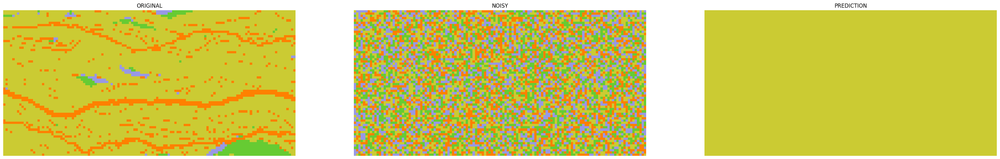

tf.Tensor([[[[0.78]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.77]]]]
pxt:  tf.Tensor([0.0224735  0.93336807 0.02206178 0.02209665], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 21, step: 0.77


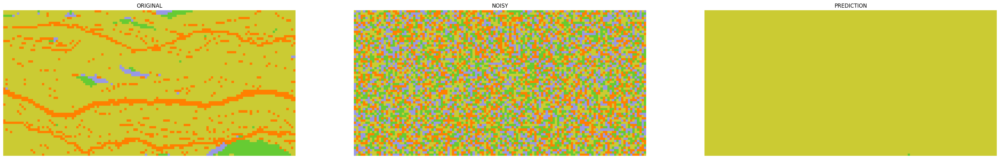

tf.Tensor([[[[0.77]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.76]]]]
pxt:  tf.Tensor([0.02088214 0.93807762 0.02050056 0.02053968], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 22, step: 0.76


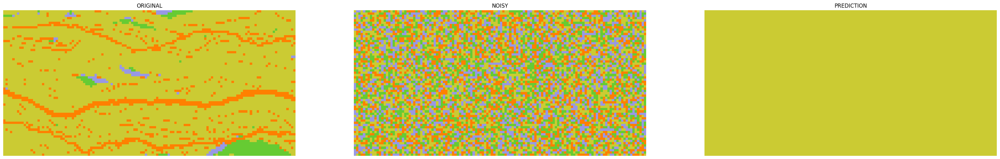

tf.Tensor([[[[0.76]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.75]]]]
pxt:  tf.Tensor([0.01954485 0.94207903 0.01916402 0.01921211], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 23, step: 0.75


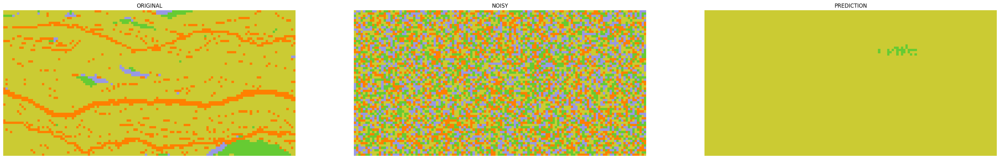

tf.Tensor([[[[0.75]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.74]]]]
pxt:  tf.Tensor([0.01829345 0.94586117 0.01789999 0.01794539], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 24, step: 0.74


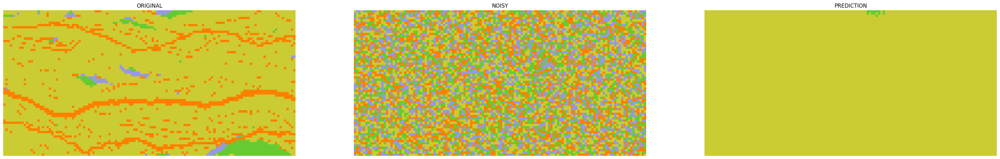

tf.Tensor([[[[0.74]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.73]]]]
pxt:  tf.Tensor([0.01719176 0.94921535 0.01676534 0.01682755], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 25, step: 0.73


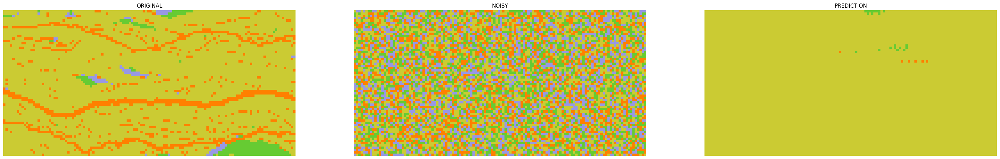

tf.Tensor([[[[0.73]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.72]]]]
pxt:  tf.Tensor([0.0162157  0.9522943  0.01571183 0.01577817], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 26, step: 0.72


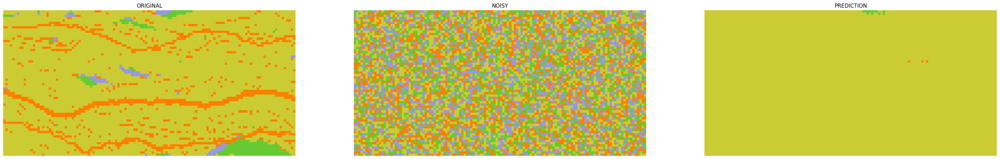

tf.Tensor([[[[0.72]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.71]]]]
pxt:  tf.Tensor([0.02136702 0.03003157 0.02062711 0.9279743 ], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 27, step: 0.71


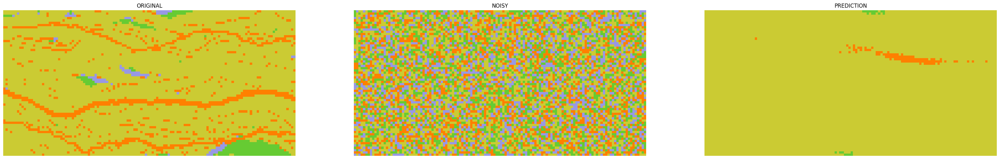

tf.Tensor([[[[0.71]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.7]]]]
pxt:  tf.Tensor([0.02061161 0.02979901 0.01983965 0.92974973], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 28, step: 0.7000000000000001


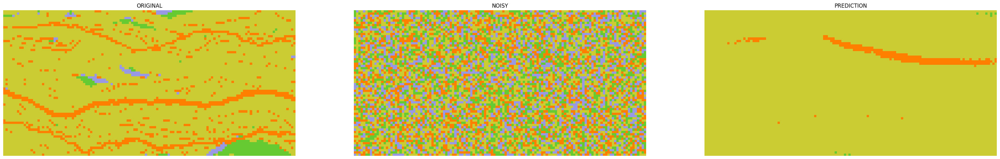

tf.Tensor([[[[0.7]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.69]]]]
pxt:  tf.Tensor([0.01985914 0.02959311 0.01908802 0.93145973], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 29, step: 0.6900000000000001


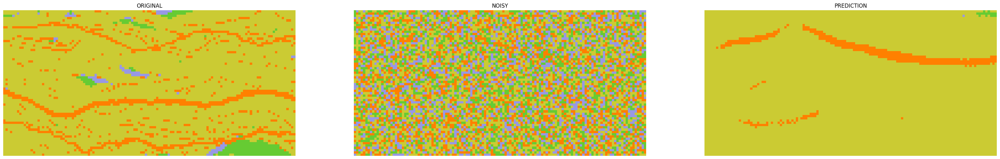

tf.Tensor([[[[0.69]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.68]]]]
pxt:  tf.Tensor([0.01936617 0.02917933 0.01837362 0.93308088], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 30, step: 0.68


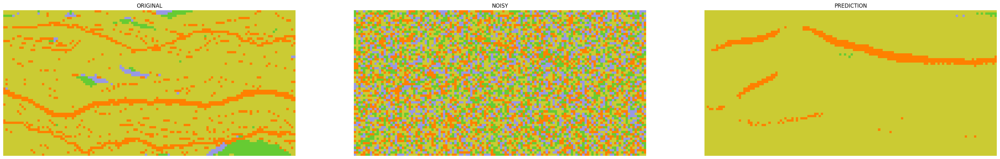

tf.Tensor([[[[0.68]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.67]]]]
pxt:  tf.Tensor([0.01868224 0.02913023 0.01770449 0.93448303], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 31, step: 0.67


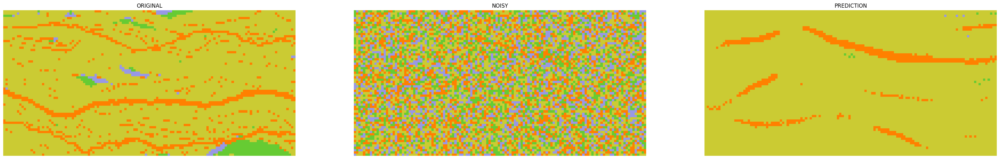

tf.Tensor([[[[0.67]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.66]]]]
pxt:  tf.Tensor([0.01841718 0.02868501 0.01706715 0.93583067], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 0. 0. 1.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 32, step: 0.66


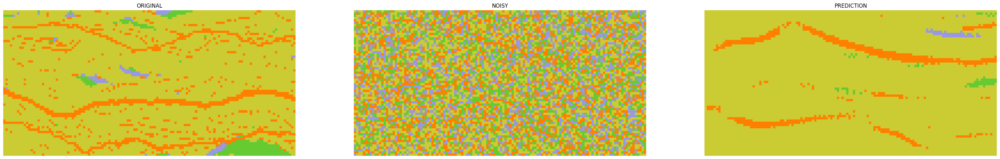

tf.Tensor([[[[0.66]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.65]]]]
pxt:  tf.Tensor([0.01064444 0.96958789 0.00983799 0.00992968], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 33, step: 0.65


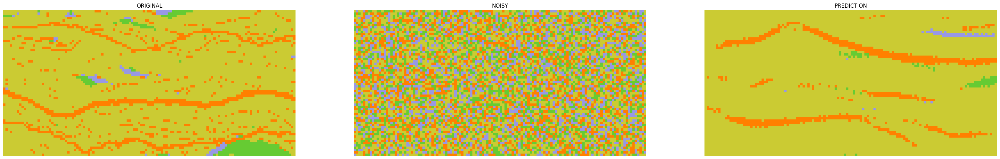

tf.Tensor([[[[0.65]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.64]]]]
pxt:  tf.Tensor([0.01000689 0.97154413 0.00917808 0.0092709 ], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 34, step: 0.64


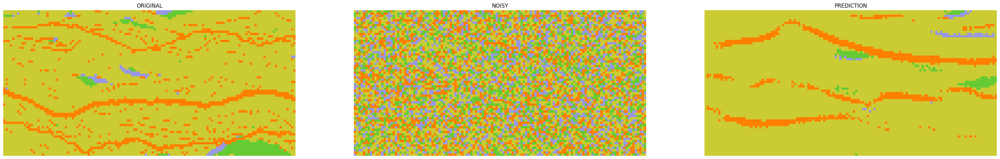

tf.Tensor([[[[0.64]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.63]]]]
pxt:  tf.Tensor([0.00949657 0.97314051 0.00861757 0.00874535], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 35, step: 0.63


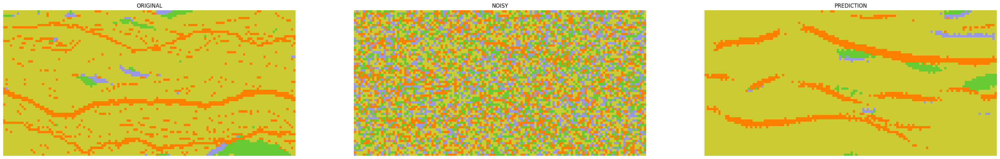

tf.Tensor([[[[0.63]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.62]]]]
pxt:  tf.Tensor([0.00896839 0.97474853 0.00806463 0.00821845], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 36, step: 0.62


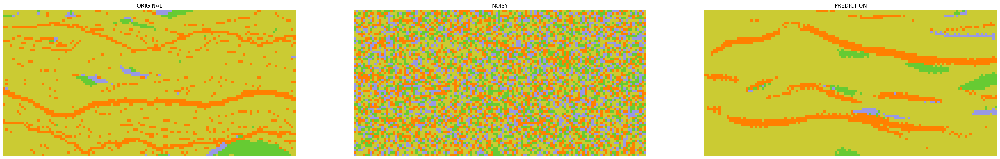

tf.Tensor([[[[0.62]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.61]]]]
pxt:  tf.Tensor([0.00827269 0.97666661 0.00745643 0.00760427], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 37, step: 0.61


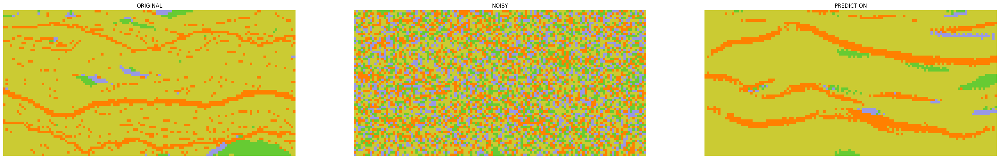

tf.Tensor([[[[0.61]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.6]]]]
pxt:  tf.Tensor([0.00790615 0.97784267 0.00702736 0.00722382], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 38, step: 0.6


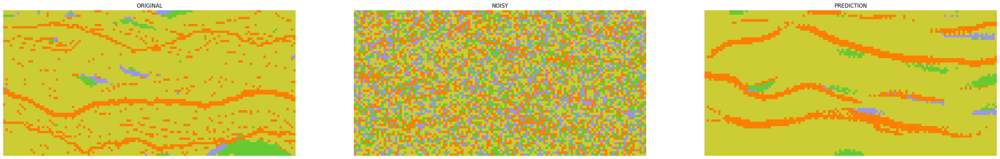

tf.Tensor([[[[0.6]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.59]]]]
pxt:  tf.Tensor([0.00775352 0.97837056 0.00681035 0.00706557], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 39, step: 0.59


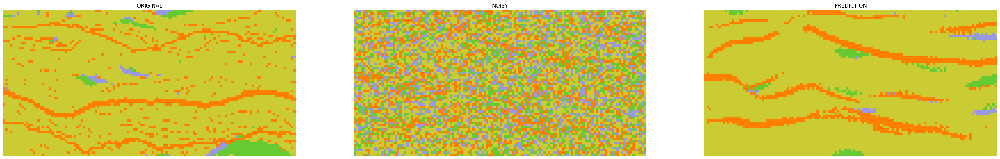

tf.Tensor([[[[0.59]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.58]]]]
pxt:  tf.Tensor([0.00712989 0.9801047  0.00626582 0.00649959], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 40, step: 0.58


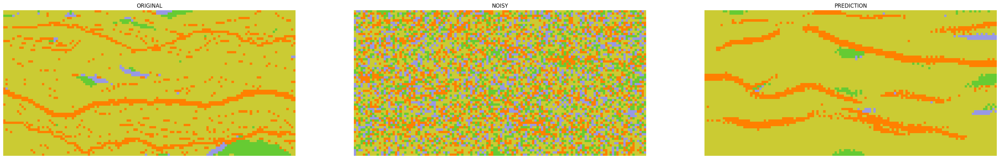

tf.Tensor([[[[0.58]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.57]]]]
pxt:  tf.Tensor([0.00690476 0.98101686 0.00591404 0.00616433], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 41, step: 0.5700000000000001


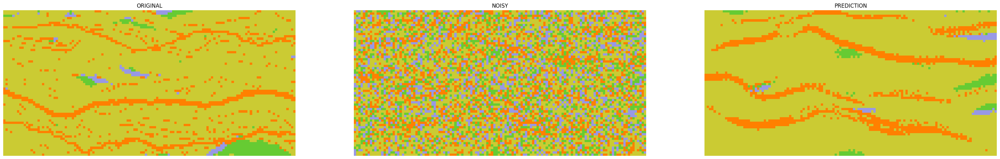

tf.Tensor([[[[0.57]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.56]]]]
pxt:  tf.Tensor([0.00629539 0.9825509  0.00543592 0.0057178 ], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 42, step: 0.56


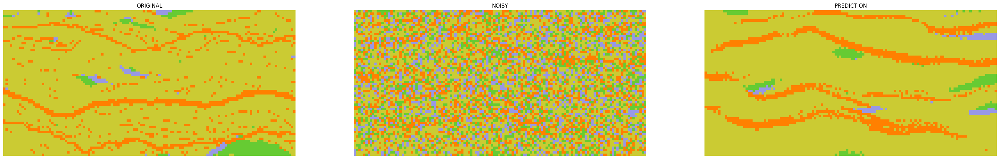

tf.Tensor([[[[0.56]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.55]]]]
pxt:  tf.Tensor([0.00619507 0.98315865 0.00510744 0.00553884], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 43, step: 0.55


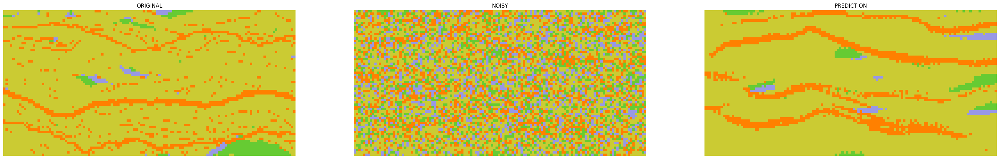

tf.Tensor([[[[0.55]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.54]]]]
pxt:  tf.Tensor([0.00630809 0.9831482  0.00497102 0.00557269], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 44, step: 0.54


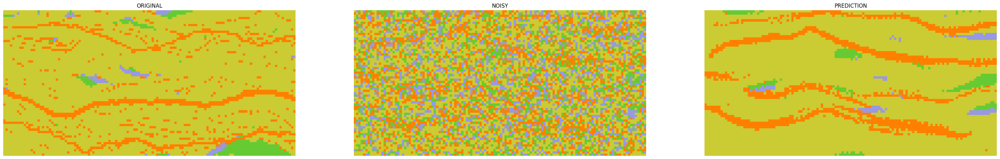

tf.Tensor([[[[0.54]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.53]]]]
pxt:  tf.Tensor([0.00584687 0.98422887 0.00463218 0.00529208], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 45, step: 0.53


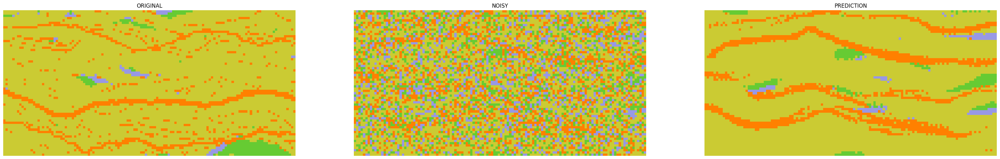

tf.Tensor([[[[0.53]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.52]]]]
pxt:  tf.Tensor([0.0054774  0.98530744 0.00428392 0.00493124], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 46, step: 0.52


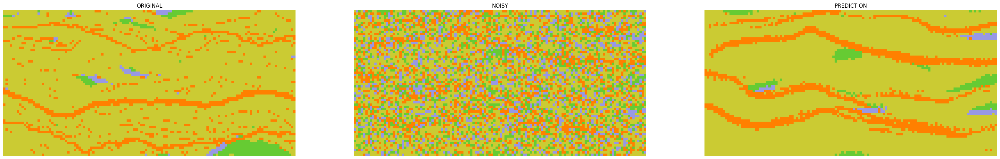

tf.Tensor([[[[0.52]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.51]]]]
pxt:  tf.Tensor([0.00527326 0.98595727 0.00404382 0.00472565], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 47, step: 0.51


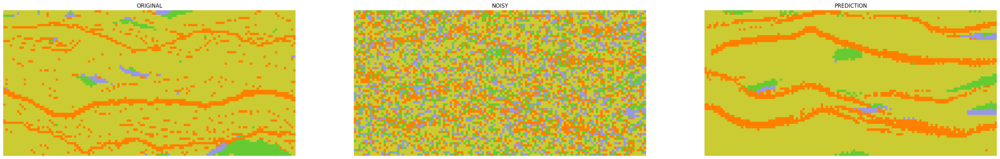

tf.Tensor([[[[0.51]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.5]]]]
pxt:  tf.Tensor([0.0050539  0.98669638 0.00377841 0.00447132], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 48, step: 0.5


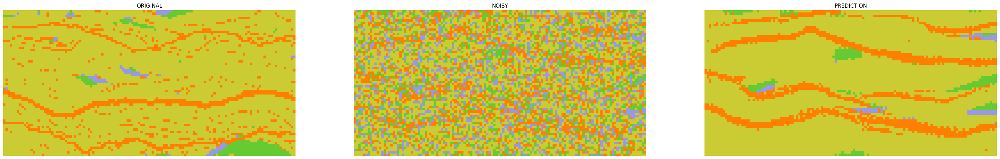

tf.Tensor([[[[0.5]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.49]]]]
pxt:  tf.Tensor([0.00415372 0.98853416 0.00333317 0.00397894], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 49, step: 0.49


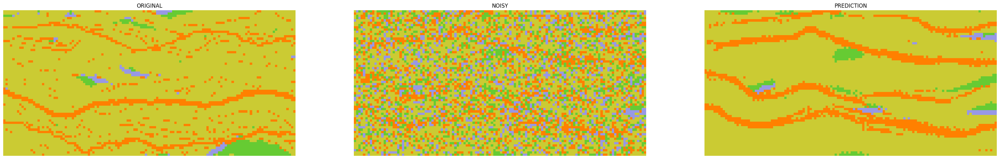

tf.Tensor([[[[0.49]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.48]]]]
pxt:  tf.Tensor([0.00406153 0.98877816 0.00318148 0.00397884], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 50, step: 0.48


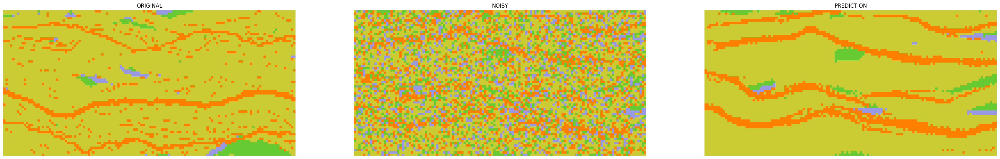

tf.Tensor([[[[0.48]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.47]]]]
pxt:  tf.Tensor([0.00383132 0.98931545 0.00298672 0.00386652], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 51, step: 0.47000000000000003


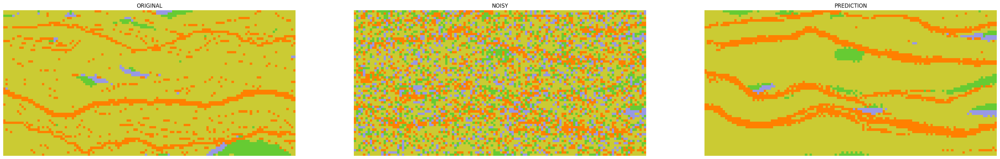

tf.Tensor([[[[0.47]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.46]]]]
pxt:  tf.Tensor([0.00337243 0.9903129  0.00269319 0.00362148], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 52, step: 0.46


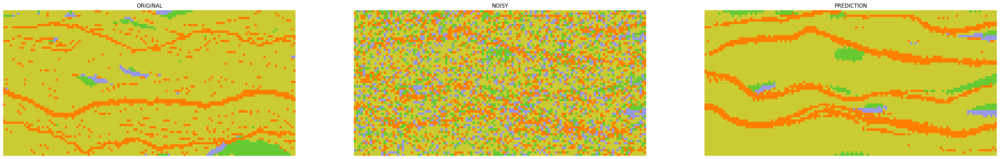

tf.Tensor([[[[0.46]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.45]]]]
pxt:  tf.Tensor([0.00315634 0.99048152 0.00258166 0.00378049], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 53, step: 0.45


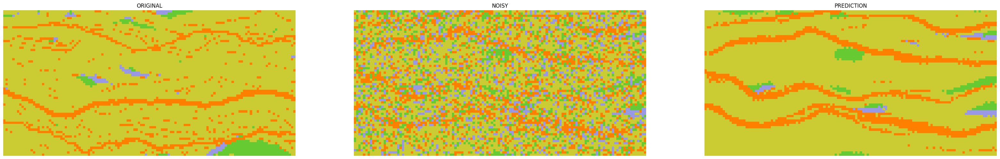

tf.Tensor([[[[0.45]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.44]]]]
pxt:  tf.Tensor([0.00296397 0.99086865 0.00243401 0.00373336], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 54, step: 0.44


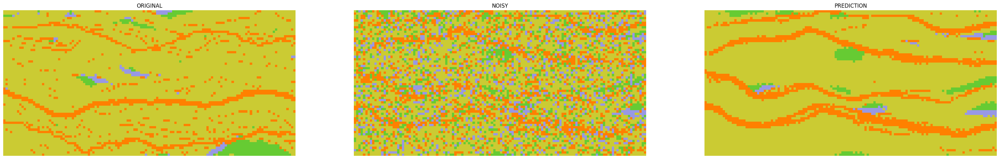

tf.Tensor([[[[0.44]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.43]]]]
pxt:  tf.Tensor([0.0027764  0.99126311 0.0022846  0.00367589], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 55, step: 0.43


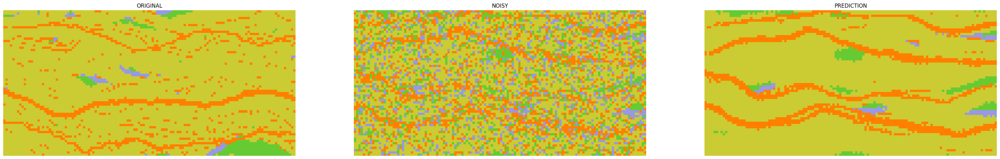

tf.Tensor([[[[0.43]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.42]]]]
pxt:  tf.Tensor([0.00255133 0.99197572 0.00208539 0.00338756], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 56, step: 0.42


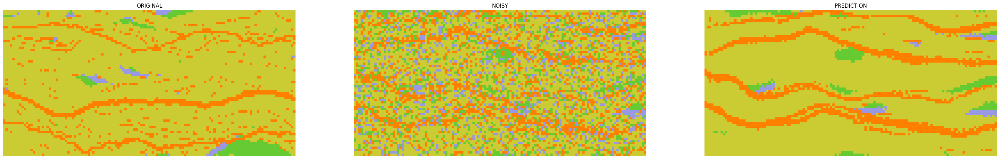

tf.Tensor([[[[0.42]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.41]]]]
pxt:  tf.Tensor([0.00244503 0.99287605 0.00185264 0.00282627], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 57, step: 0.41000000000000003


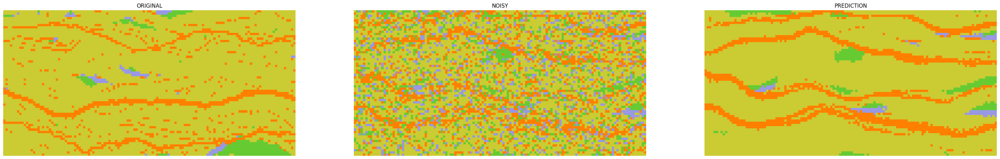

tf.Tensor([[[[0.41]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.4]]]]
pxt:  tf.Tensor([0.00233541 0.99308367 0.00175093 0.00282998], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 58, step: 0.4


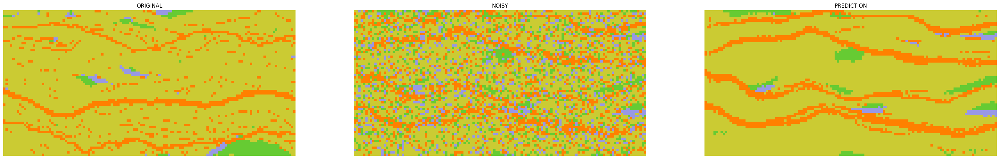

tf.Tensor([[[[0.4]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.39]]]]
pxt:  tf.Tensor([0.00180411 0.99531166 0.0013265  0.00155773], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 59, step: 0.39


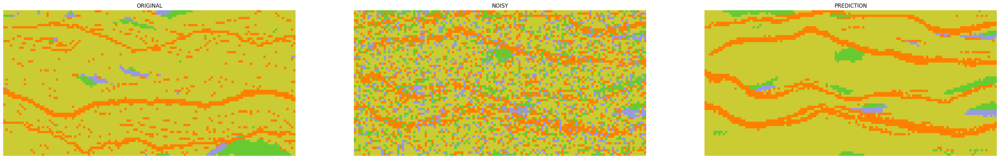

tf.Tensor([[[[0.39]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.38]]]]
pxt:  tf.Tensor([0.00171302 0.99565137 0.00120813 0.00142748], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 60, step: 0.38


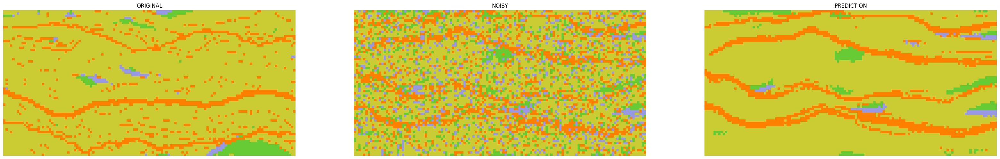

tf.Tensor([[[[0.38]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.37]]]]
pxt:  tf.Tensor([0.00158936 0.99597634 0.00110598 0.00132832], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 61, step: 0.37


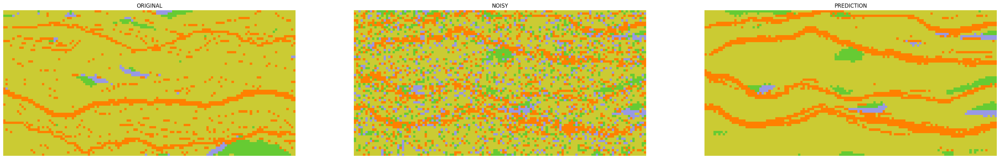

tf.Tensor([[[[0.37]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.36]]]]
pxt:  tf.Tensor([1.45990482e-03 9.96449149e-01 9.73214961e-04 1.11773085e-03], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 62, step: 0.36


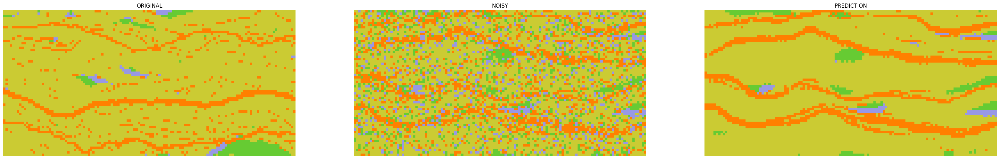

tf.Tensor([[[[0.36]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.35]]]]
pxt:  tf.Tensor([1.36993527e-03 9.96711609e-01 8.88531444e-04 1.02992456e-03], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 63, step: 0.35000000000000003


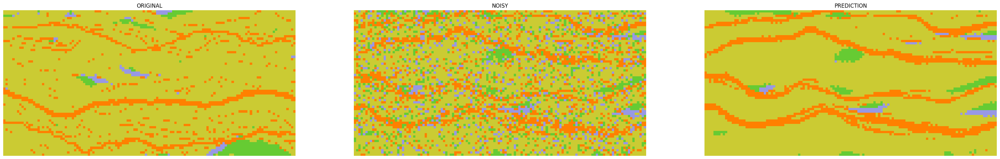

tf.Tensor([[[[0.35]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.34]]]]
pxt:  tf.Tensor([1.26900761e-03 9.96962784e-01 8.11488343e-04 9.56720457e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 64, step: 0.34


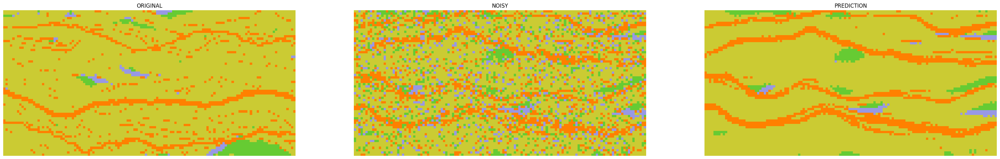

tf.Tensor([[[[0.34]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.33]]]]
pxt:  tf.Tensor([1.16748301e-03 9.97194919e-01 7.38031371e-04 8.99566734e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 65, step: 0.33


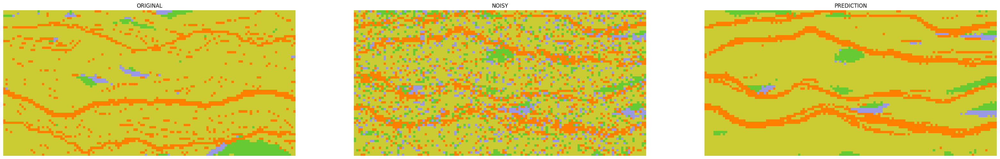

tf.Tensor([[[[0.33]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.32]]]]
pxt:  tf.Tensor([1.07602020e-03 9.97419265e-01 6.70211309e-04 8.34503978e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 66, step: 0.32


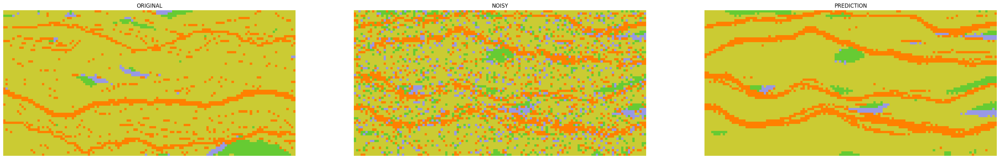

tf.Tensor([[[[0.32]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.31]]]]
pxt:  tf.Tensor([9.29023329e-04 9.97801489e-01 5.81537737e-04 6.87950409e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 67, step: 0.31


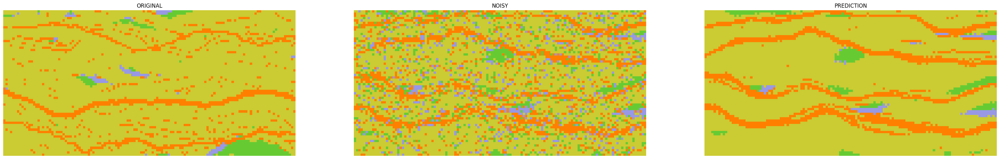

tf.Tensor([[[[0.31]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.3]]]]
pxt:  tf.Tensor([8.46405544e-04 9.98002061e-01 5.23316997e-04 6.28216161e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 68, step: 0.3


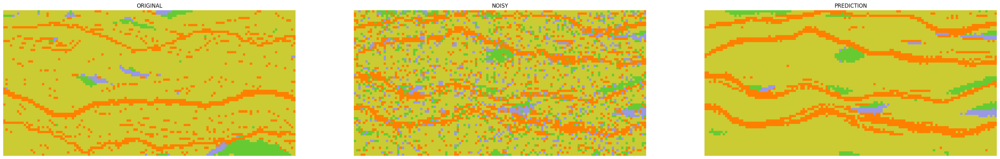

tf.Tensor([[[[0.3]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.29]]]]
pxt:  tf.Tensor([7.74960791e-04 9.98191541e-01 4.69706947e-04 5.63791295e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 69, step: 0.29


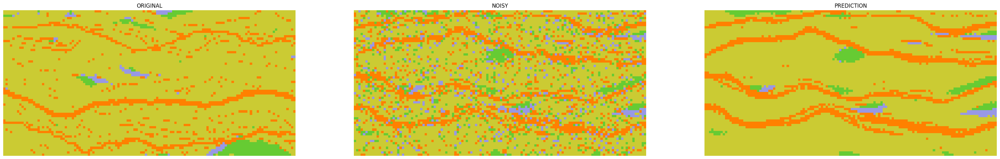

tf.Tensor([[[[0.29]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.28]]]]
pxt:  tf.Tensor([7.04646405e-04 9.98374121e-01 4.19004608e-04 5.02228385e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 70, step: 0.28


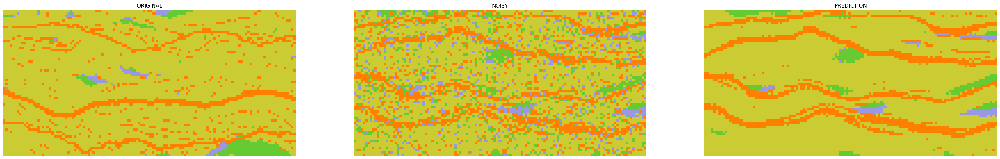

tf.Tensor([[[[0.28]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.27]]]]
pxt:  tf.Tensor([6.59488415e-04 9.98510906e-01 3.75062462e-04 4.54543041e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 71, step: 0.27


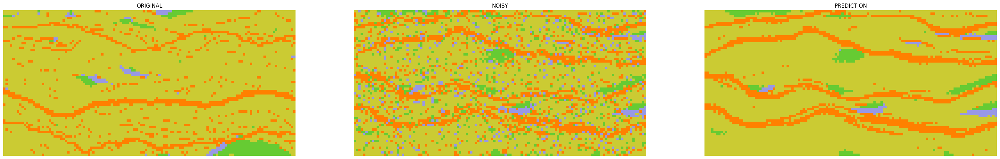

tf.Tensor([[[[0.27]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.26]]]]
pxt:  tf.Tensor([6.09751741e-04 9.98650379e-01 3.33436568e-04 4.06432614e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 72, step: 0.26


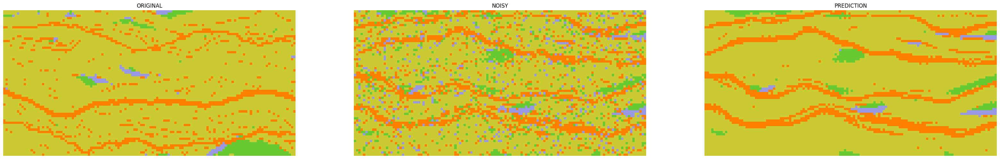

tf.Tensor([[[[0.26]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.25]]]]
pxt:  tf.Tensor([5.68651139e-04 9.98760576e-01 2.97408779e-04 3.73364044e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 73, step: 0.25


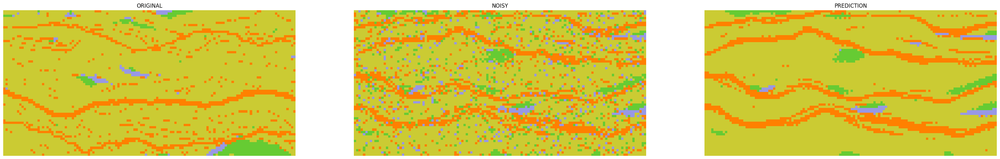

tf.Tensor([[[[0.25]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.24]]]]
pxt:  tf.Tensor([5.29436606e-04 9.98870855e-01 2.63239064e-04 3.36469109e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 74, step: 0.24


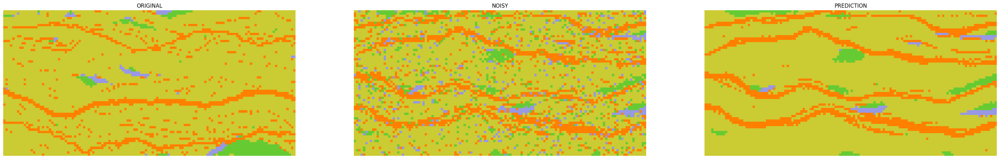

tf.Tensor([[[[0.24]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.23]]]]
pxt:  tf.Tensor([4.93697529e-04 9.98962661e-01 2.32300746e-04 3.11340791e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 75, step: 0.23


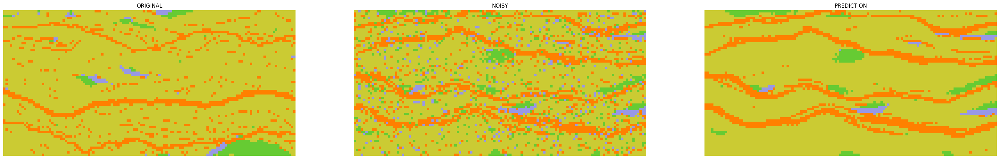

tf.Tensor([[[[0.23]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.22]]]]
pxt:  tf.Tensor([4.63348859e-04 9.99041535e-01 2.07437653e-04 2.87678981e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 76, step: 0.22


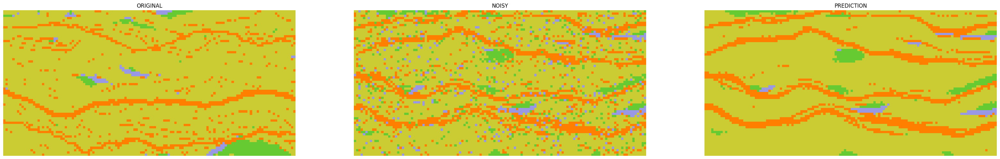

tf.Tensor([[[[0.22]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.21]]]]
pxt:  tf.Tensor([4.35585938e-04 9.99117510e-01 1.82998906e-04 2.63905510e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 77, step: 0.21


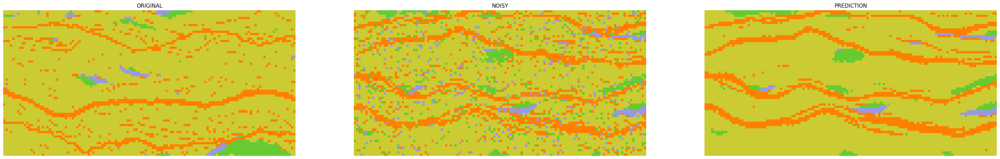

tf.Tensor([[[[0.21]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.2]]]]
pxt:  tf.Tensor([3.71812535e-04 9.99271650e-01 1.44906608e-04 2.11630665e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 78, step: 0.2


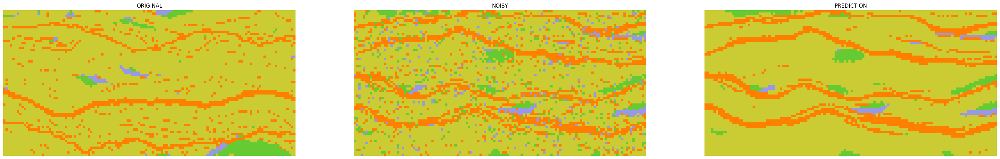

tf.Tensor([[[[0.2]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.19]]]]
pxt:  tf.Tensor([3.62949616e-04 9.99300650e-01 1.29058739e-04 2.07341881e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 79, step: 0.19


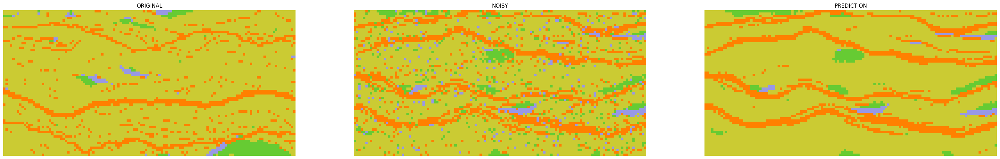

tf.Tensor([[[[0.19]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.18]]]]
pxt:  tf.Tensor([3.29552267e-04 9.99368045e-01 1.12267662e-04 1.90134633e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 80, step: 0.18


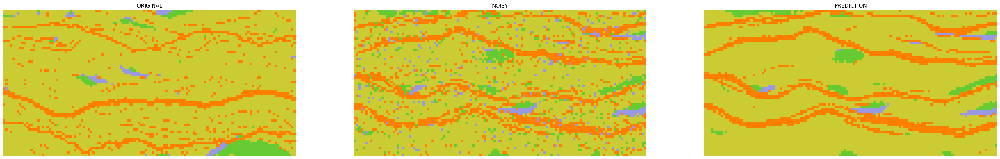

tf.Tensor([[[[0.18]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.17]]]]
pxt:  tf.Tensor([3.11197576e-04 9.99417973e-01 9.68214053e-05 1.74008314e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 81, step: 0.17


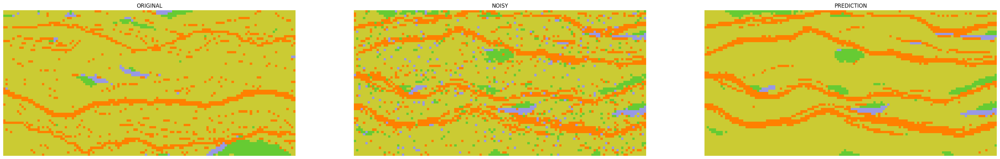

tf.Tensor([[[[0.17]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.16]]]]
pxt:  tf.Tensor([2.90739506e-04 9.99469718e-01 8.26852743e-05 1.56857414e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 82, step: 0.16


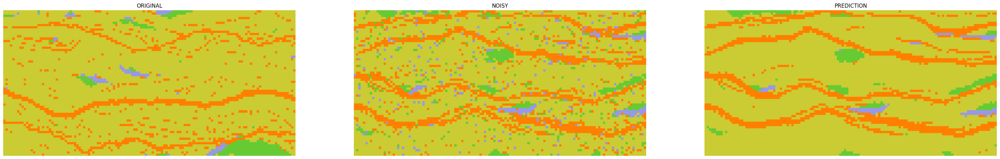

tf.Tensor([[[[0.16]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.15]]]]
pxt:  tf.Tensor([2.65440380e-04 9.99526365e-01 6.97381111e-05 1.38456167e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 83, step: 0.15


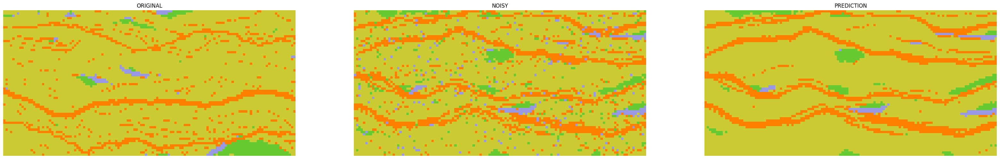

tf.Tensor([[[[0.15]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.14]]]]
pxt:  tf.Tensor([2.37979200e-04 9.99577037e-01 5.83291803e-05 1.26654380e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 84, step: 0.14


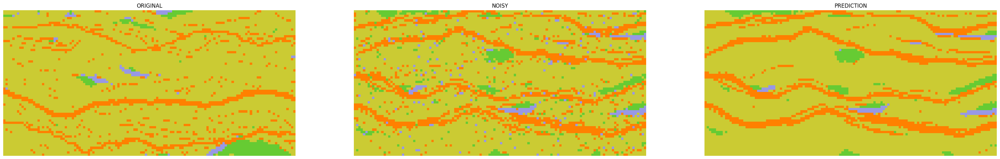

tf.Tensor([[[[0.14]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.13]]]]
pxt:  tf.Tensor([2.15909500e-04 9.99625834e-01 4.82600290e-05 1.09996964e-04], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 85, step: 0.13


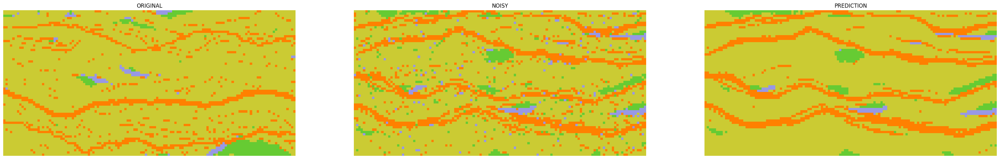

tf.Tensor([[[[0.13]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.12]]]]
pxt:  tf.Tensor([1.98139380e-04 9.99663088e-01 3.99673844e-05 9.88053904e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 86, step: 0.12


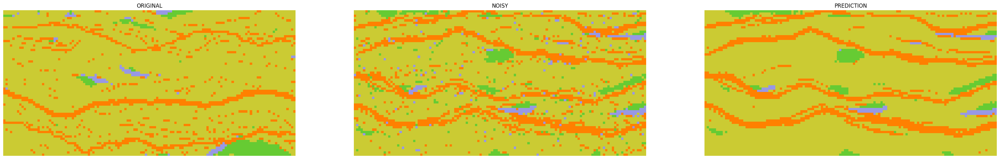

tf.Tensor([[[[0.12]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.11]]]]
pxt:  tf.Tensor([1.17407603e-04 9.99804307e-01 2.63483323e-05 5.19368351e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 87, step: 0.11


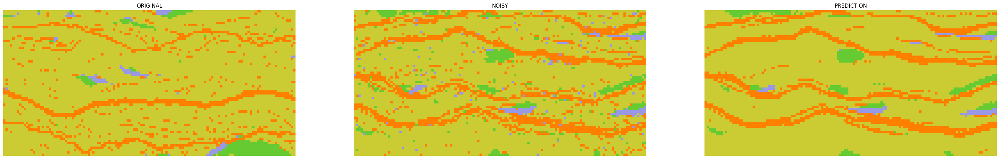

tf.Tensor([[[[0.11]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.1]]]]
pxt:  tf.Tensor([1.06760235e-04 9.99827497e-01 2.10375359e-05 4.47049779e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 88, step: 0.1


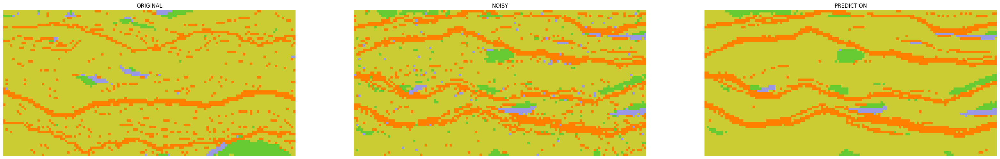

tf.Tensor([[[[0.1]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.09]]]]
pxt:  tf.Tensor([9.44101141e-05 9.99851246e-01 1.63548184e-05 3.79892636e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 89, step: 0.09


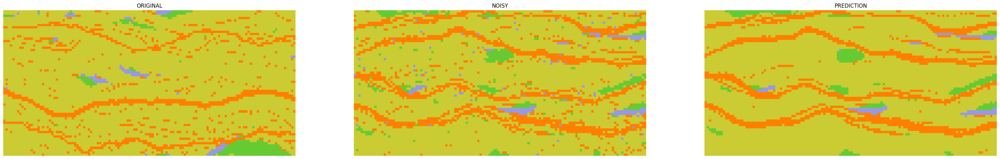

tf.Tensor([[[[0.09]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.08]]]]
pxt:  tf.Tensor([8.70430650e-05 9.99869847e-01 1.24290097e-05 3.06809529e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 90, step: 0.08


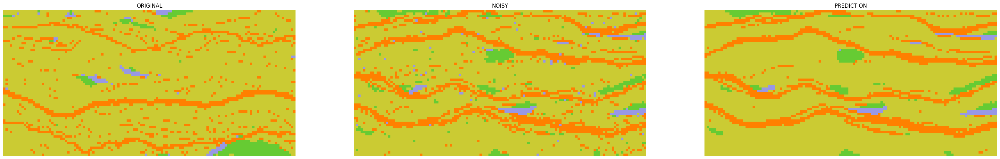

tf.Tensor([[[[0.08]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.07]]]]
pxt:  tf.Tensor([7.56891102e-05 9.99889103e-01 9.33408337e-06 2.58736549e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 91, step: 0.07


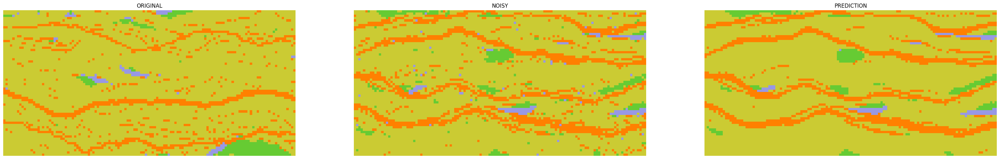

tf.Tensor([[[[0.07]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.06]]]]
pxt:  tf.Tensor([6.49771164e-05 9.99906828e-01 6.85357097e-06 2.13410232e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 92, step: 0.06


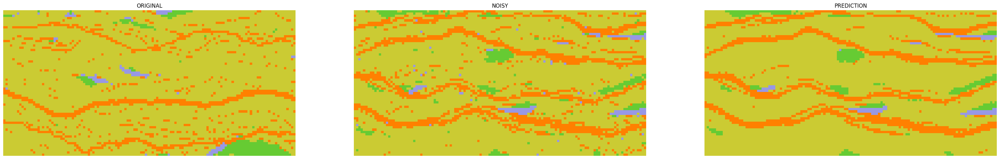

tf.Tensor([[[[0.06]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.05]]]]
pxt:  tf.Tensor([5.45183296e-05 9.99922985e-01 4.95211774e-06 1.75443474e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 93, step: 0.05


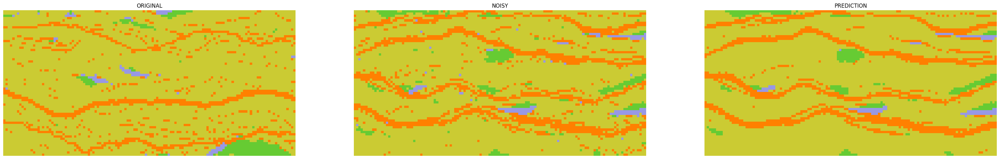

tf.Tensor([[[[0.05]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.04]]]]
pxt:  tf.Tensor([4.45135593e-05 9.99937950e-01 3.51196735e-06 1.40245794e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 94, step: 0.04


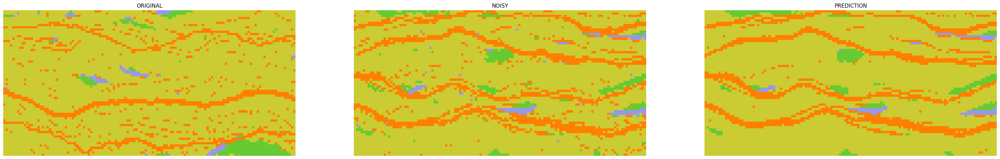

tf.Tensor([[[[0.04]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.03]]]]
pxt:  tf.Tensor([3.41097546e-05 9.99952885e-01 2.36728074e-06 1.06382020e-05], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 95, step: 0.03


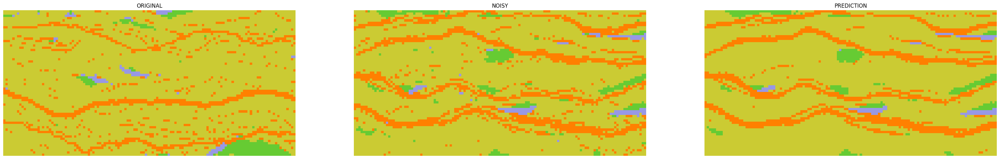

tf.Tensor([[[[0.03]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.02]]]]
pxt:  tf.Tensor([2.45982536e-05 9.99966204e-01 1.53864181e-06 7.65938248e-06], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 96, step: 0.02


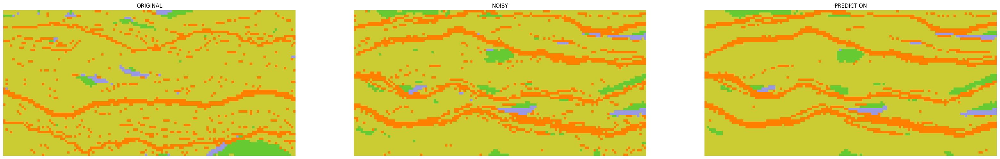

tf.Tensor([[[[0.02]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.01]]]]
pxt:  tf.Tensor([1.51251580e-05 9.99979336e-01 8.76857754e-07 4.66158190e-06], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 97, step: 0.01


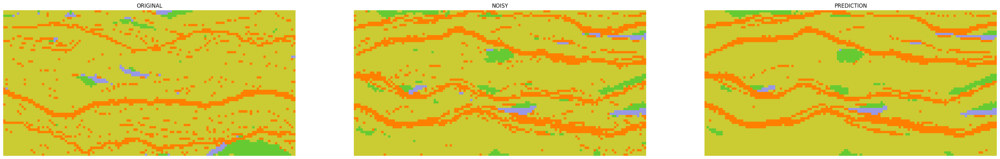

tf.Tensor([[[[0.01]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.]]]]
pxt:  tf.Tensor([5.65799744e-06 9.99992277e-01 3.19090825e-07 1.74572424e-06], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------

i: 98, step: 0.0


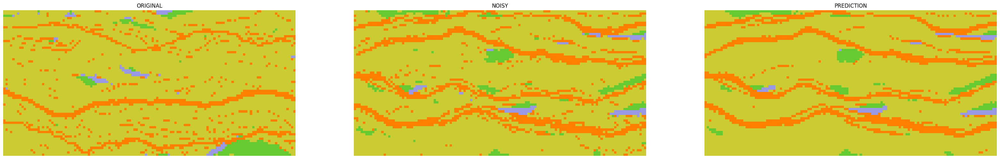

tf.Tensor([[[[0.]]]], shape=(1, 1, 1, 1), dtype=float64) [[[[0.99]]]]
pxt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
new xt:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
x0:  tf.Tensor([0. 1. 0. 0.], shape=(4,), dtype=float64)
---------------------



In [53]:
step_size = 0.01
steps = np.arange(0, 1, step_size, dtype=np.float64)
len(steps)

init_x = tf.random.uniform((1, 64, 128), 0, 4, dtype=tf.dtypes.int32)
init_x = keras.utils.to_categorical(init_x)
initial_noise, _ = forward_process(x_train[5], tf.reshape(steps[99], (1, 1, 1, 1)), 4) #init_x
plt.imshow(np.argmax(initial_noise, axis=-1).reshape((64, 128)),
            interpolation='nearest', cmap=cmap, norm=norm)
plt.show()
num_images = initial_noise.shape[0]

# important line:
# at the first sampling step, the "noisy image" is pure noise
# but its signal rate is assumed to be nonzero (min_signal_rate)
next_noisy_images = tf.expand_dims(initial_noise, axis=0)

for i, step in enumerate(np.flip(steps[:99])):
    noisy_images = next_noisy_images

    # separate the current noisy image to its components
    input_diffusion_times = tf.reshape(steps[98 - i], (1, 1, 1, 1))

    pred_images = model.denoise(
        noisy_images, input_diffusion_times, training=False
    )
    for j in range(1):
        plt.figure(figsize=(40, 40))
        plt.subplot(1, 2, 1)
        plt.title('NOISY')
        plt.imshow(np.argmax(noisy_images[j].numpy(), axis=-1), interpolation='nearest', cmap=cmap, norm=norm)
        plt.axis("off")
        plt.subplot(1, 2, 2)
        plt.title('PREDICTION')
        plt.imshow(np.argmax(pred_images[j].numpy(), axis=-1), interpolation='nearest', cmap=cmap, norm=norm)
        plt.axis("off")
        plt.show()

        
    next_diffusion_times = np.reshape(steps[98 - (i + 1)], (1, 1, 1, 1))
    pxt, _, _, _ = tf.map_fn(lambda x: model.conditional_reverse_probability(x[0], x[1], x[2], x[3], sample=False),
                                           (pred_images, noisy_images, input_diffusion_times, next_diffusion_times))
    next_noisy_images, _, _, _ = tf.map_fn(lambda x: model.conditional_reverse_probability(x[0], x[1], x[2], x[3], sample=True),
                                           (pred_images, noisy_images, input_diffusion_times, next_diffusion_times))

/tmp/ipykernel_4033325/3727694295.py:1: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm


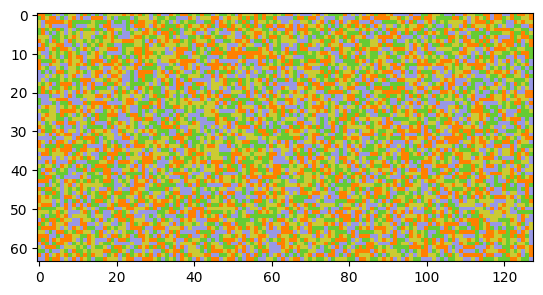

  0%|                                                   | 0/499 [00:00<?, ?it/s]

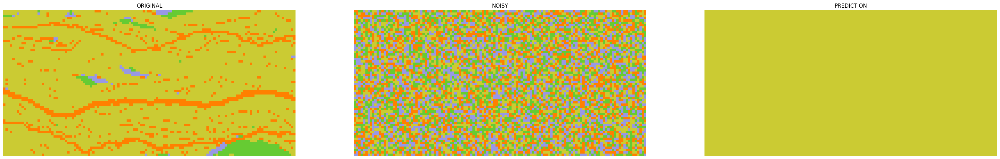

  0%|                                         | 1/499 [00:22<3:05:45, 22.38s/it]

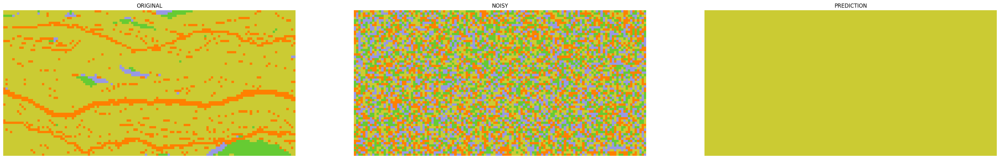

  0%|▏                                        | 2/499 [00:31<2:00:23, 14.54s/it]

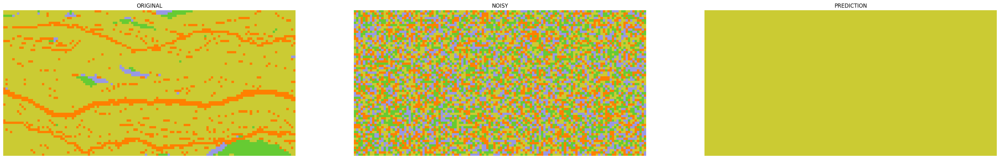

  1%|▏                                        | 3/499 [00:40<1:39:23, 12.02s/it]

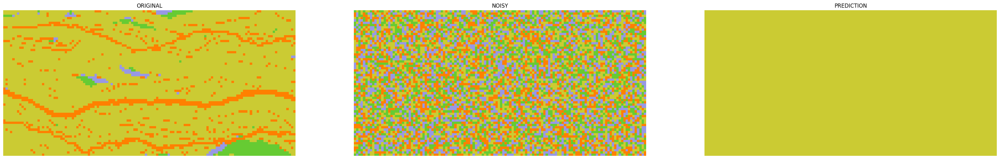

  1%|▎                                        | 4/499 [00:49<1:29:26, 10.84s/it]

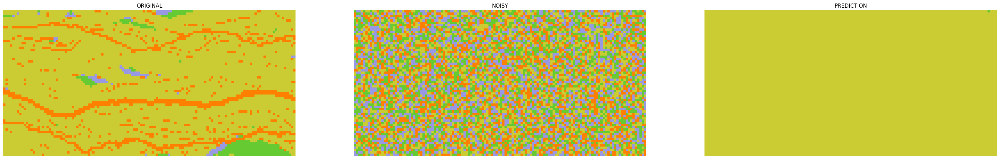

  1%|▍                                        | 5/499 [00:58<1:24:03, 10.21s/it]

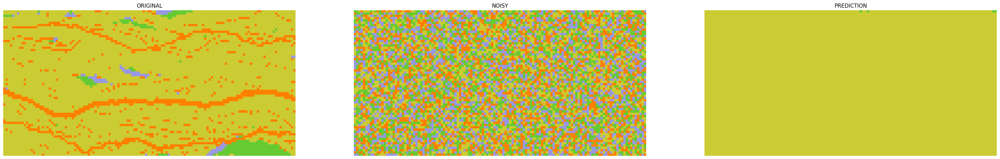

  1%|▍                                        | 6/499 [01:07<1:20:41,  9.82s/it]

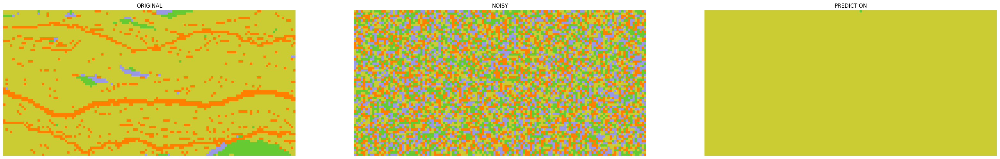

  1%|▌                                        | 7/499 [01:16<1:18:27,  9.57s/it]

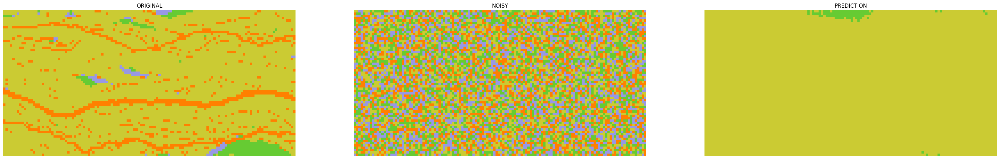

  2%|▋                                        | 8/499 [01:25<1:17:01,  9.41s/it]

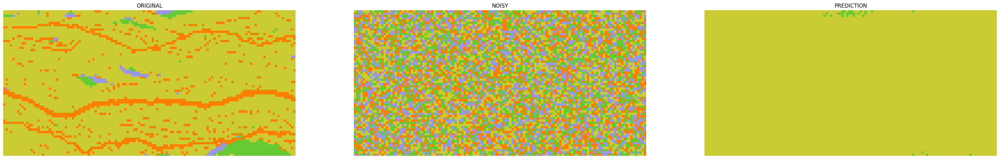

  2%|▋                                        | 9/499 [01:34<1:15:54,  9.29s/it]

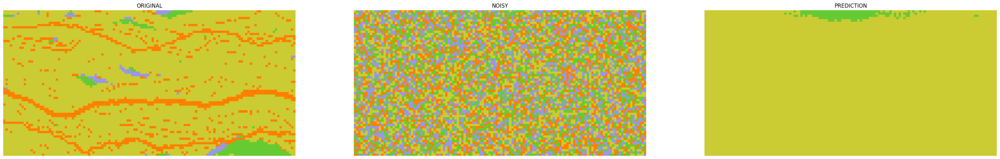

  2%|▊                                       | 10/499 [01:43<1:15:07,  9.22s/it]

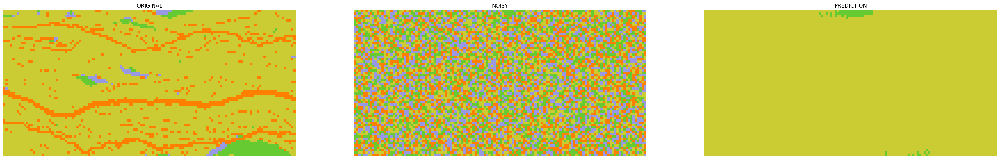

  2%|▉                                       | 11/499 [01:52<1:14:35,  9.17s/it]

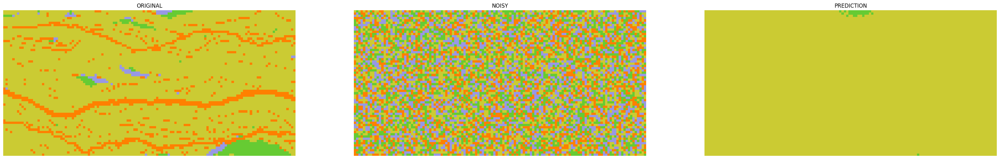

  2%|▉                                       | 12/499 [02:02<1:14:14,  9.15s/it]

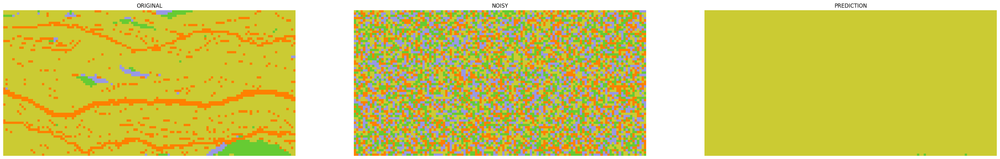

  3%|█                                       | 13/499 [02:11<1:13:55,  9.13s/it]

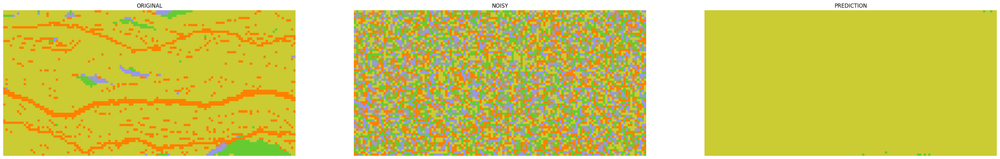

  3%|█                                       | 14/499 [02:20<1:13:43,  9.12s/it]

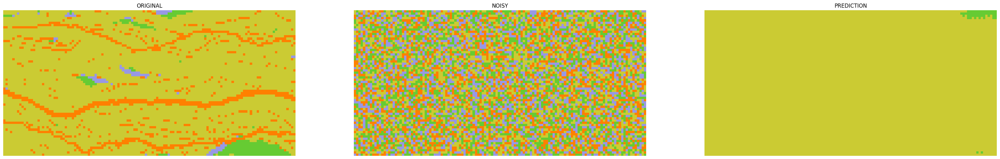

  3%|█▏                                      | 15/499 [02:30<1:16:13,  9.45s/it]

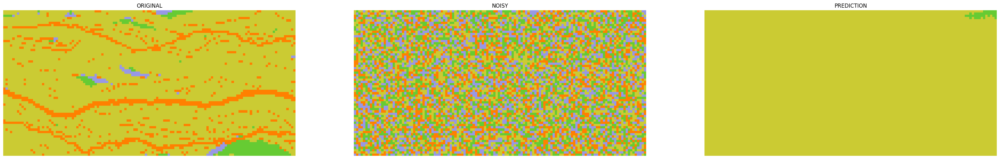

  3%|█▎                                      | 16/499 [02:39<1:15:12,  9.34s/it]

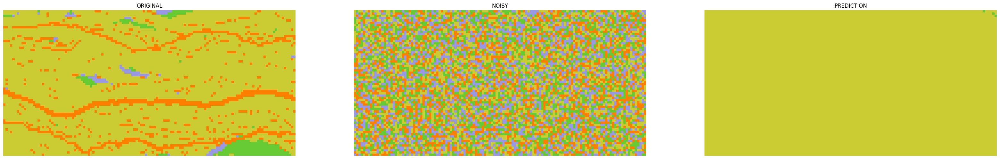

  3%|█▎                                      | 17/499 [02:48<1:14:25,  9.26s/it]

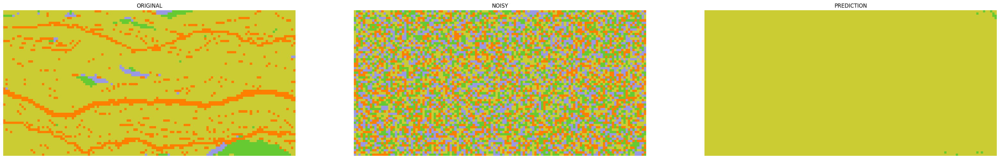

  4%|█▍                                      | 18/499 [02:57<1:13:52,  9.22s/it]

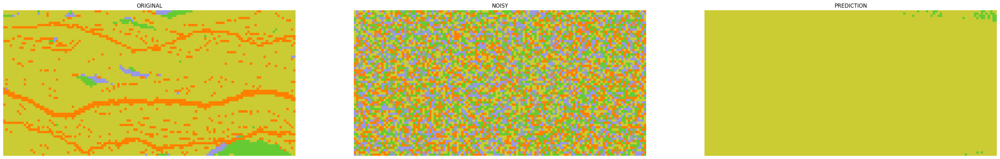

  4%|█▌                                      | 19/499 [03:06<1:13:24,  9.18s/it]

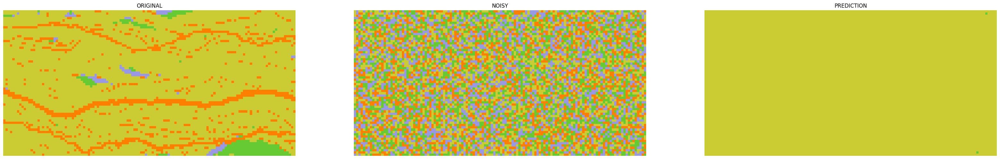

  4%|█▌                                      | 20/499 [03:15<1:12:50,  9.12s/it]

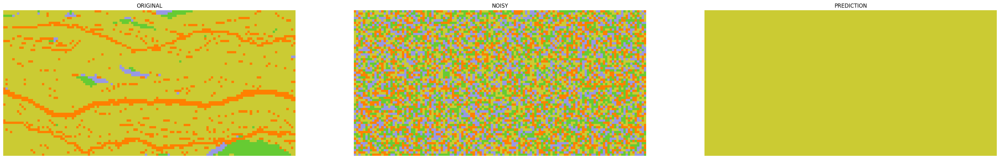

  4%|█▋                                      | 21/499 [03:24<1:12:17,  9.07s/it]

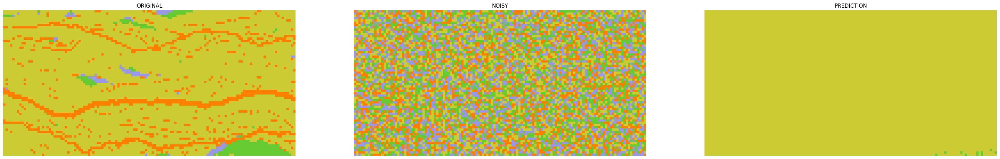

  4%|█▊                                      | 22/499 [03:33<1:11:48,  9.03s/it]

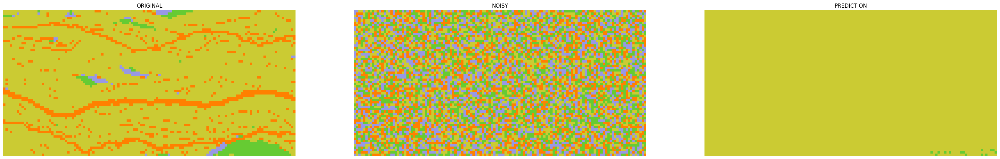

  5%|█▊                                      | 23/499 [03:42<1:11:21,  9.00s/it]

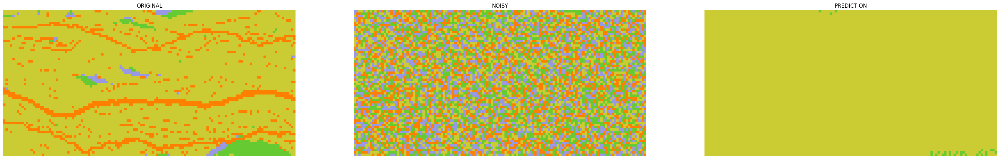

  5%|█▉                                      | 24/499 [03:51<1:11:06,  8.98s/it]

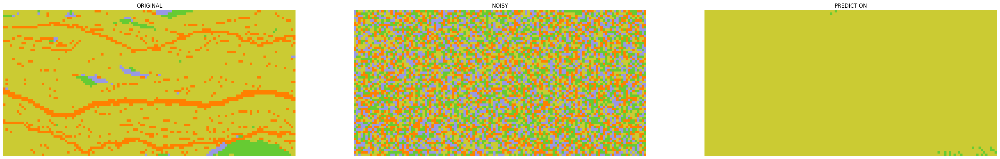

  5%|██                                      | 25/499 [04:00<1:10:50,  8.97s/it]

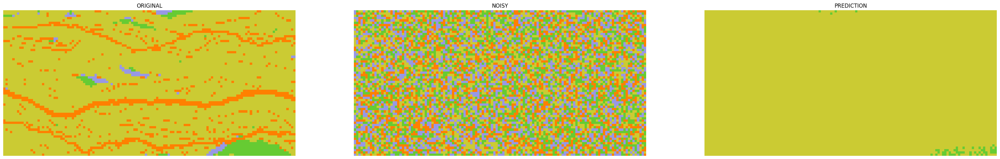

  5%|██                                      | 26/499 [04:09<1:10:30,  8.94s/it]

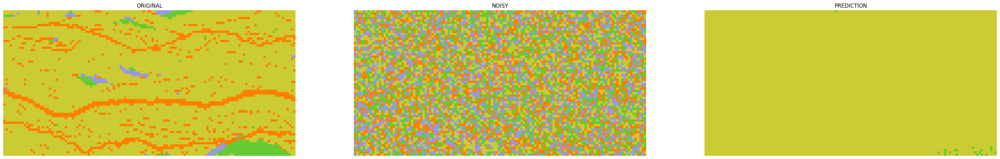

  5%|██▏                                     | 27/499 [04:18<1:10:26,  8.95s/it]

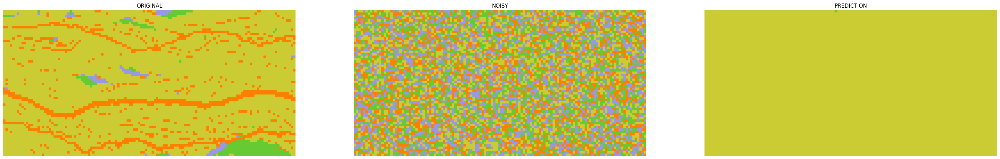

  6%|██▏                                     | 28/499 [04:27<1:10:11,  8.94s/it]

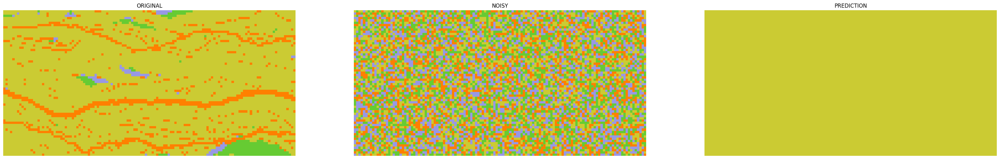

  6%|██▎                                     | 29/499 [04:36<1:10:00,  8.94s/it]

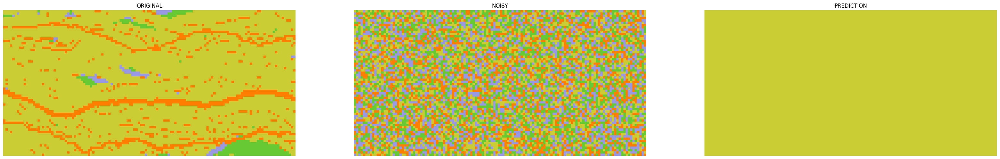

  6%|██▍                                     | 30/499 [04:45<1:09:46,  8.93s/it]

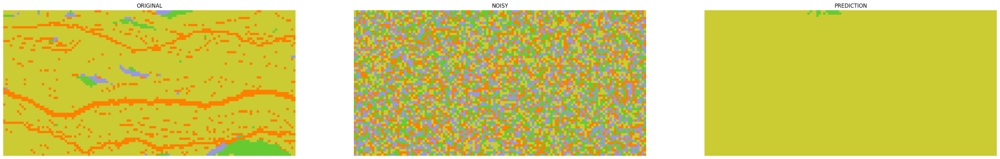

  6%|██▍                                     | 31/499 [04:54<1:09:41,  8.93s/it]

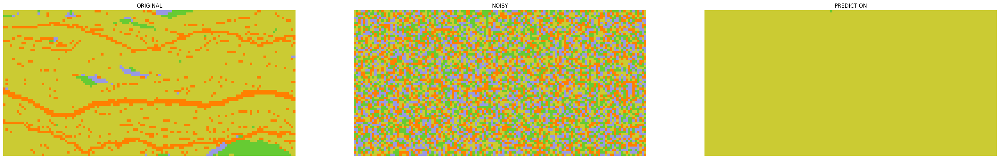

  6%|██▌                                     | 32/499 [05:03<1:09:40,  8.95s/it]

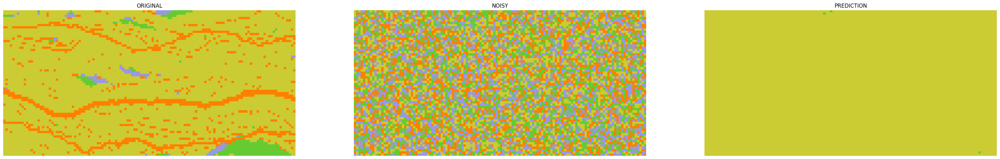

  7%|██▋                                     | 33/499 [05:11<1:09:27,  8.94s/it]

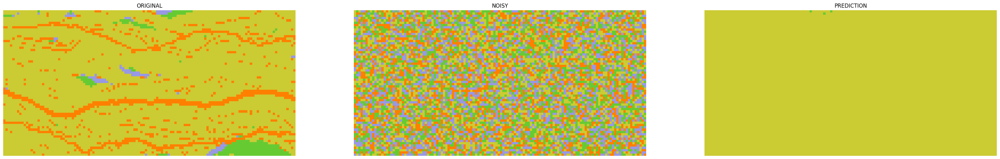

  7%|██▋                                     | 34/499 [05:20<1:09:20,  8.95s/it]

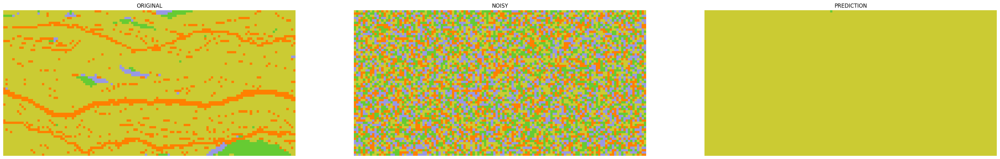

  7%|██▊                                     | 35/499 [05:29<1:09:05,  8.93s/it]

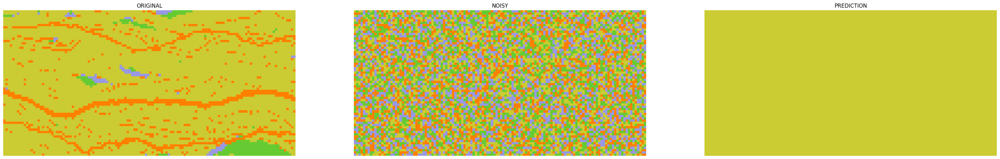

  7%|██▉                                     | 36/499 [05:38<1:08:59,  8.94s/it]

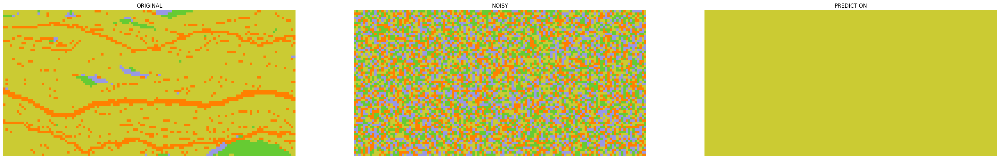

  7%|██▉                                     | 37/499 [05:47<1:08:46,  8.93s/it]

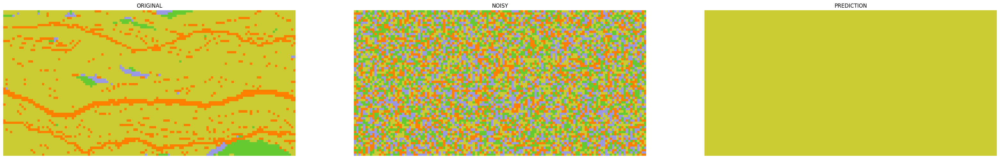

  8%|███                                     | 38/499 [05:56<1:08:36,  8.93s/it]

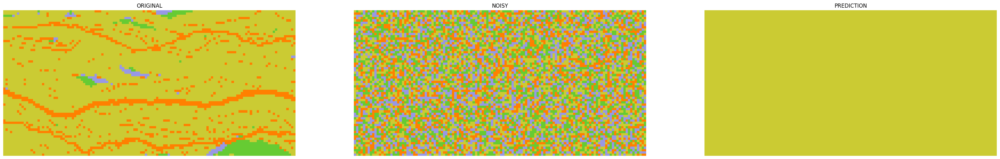

  8%|███▏                                    | 39/499 [06:05<1:08:27,  8.93s/it]

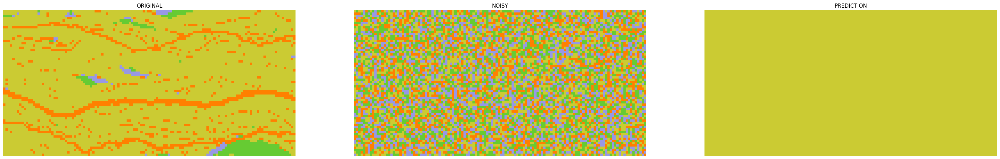

  8%|███▏                                    | 40/499 [06:14<1:08:15,  8.92s/it]

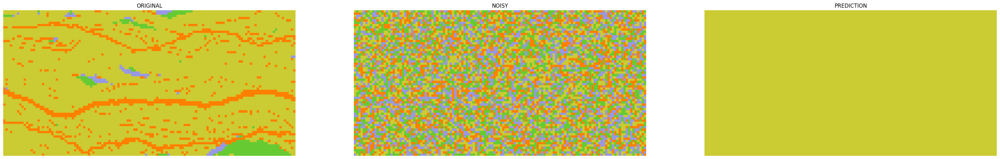

  8%|███▎                                    | 41/499 [06:23<1:08:11,  8.93s/it]

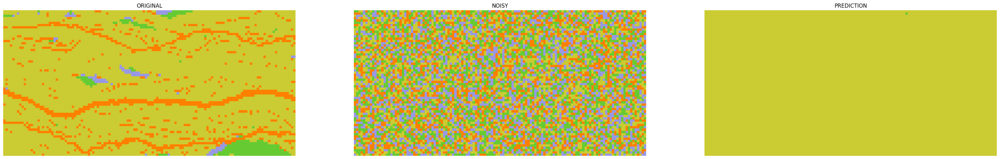

  8%|███▎                                    | 42/499 [06:32<1:08:00,  8.93s/it]

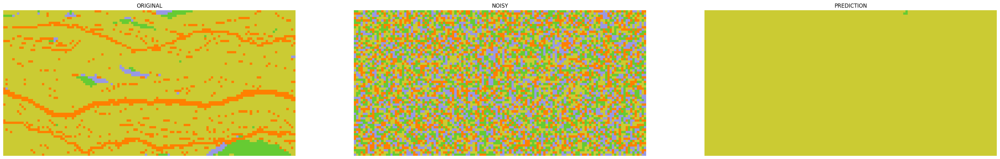

  9%|███▍                                    | 43/499 [06:41<1:07:54,  8.93s/it]

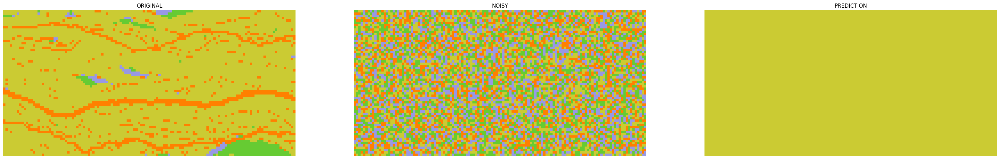

  9%|███▌                                    | 44/499 [06:50<1:07:48,  8.94s/it]

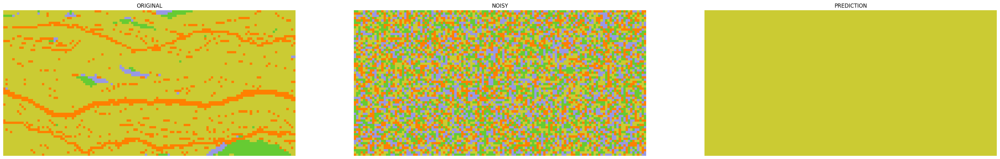

  9%|███▌                                    | 45/499 [06:59<1:07:36,  8.94s/it]

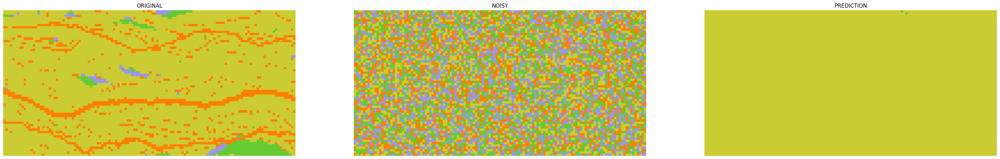

  9%|███▋                                    | 46/499 [07:08<1:07:29,  8.94s/it]

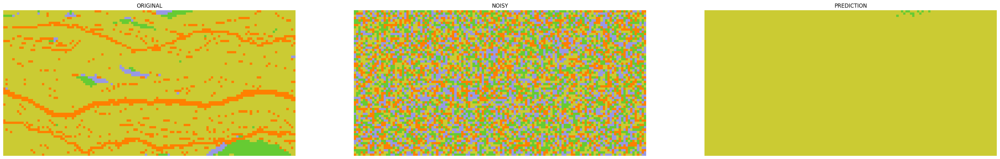

  9%|███▊                                    | 47/499 [07:16<1:07:19,  8.94s/it]

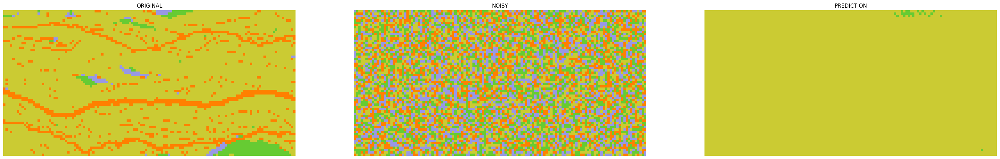

 10%|███▊                                    | 48/499 [07:25<1:07:12,  8.94s/it]

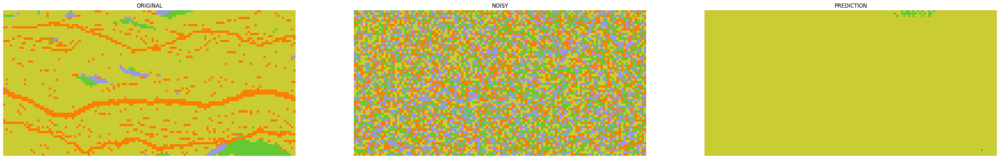

 10%|███▉                                    | 49/499 [07:34<1:06:59,  8.93s/it]

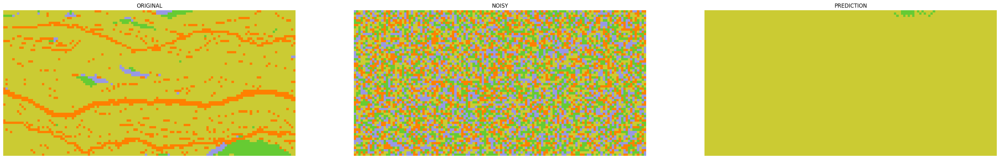

 10%|████                                    | 50/499 [07:44<1:08:57,  9.22s/it]

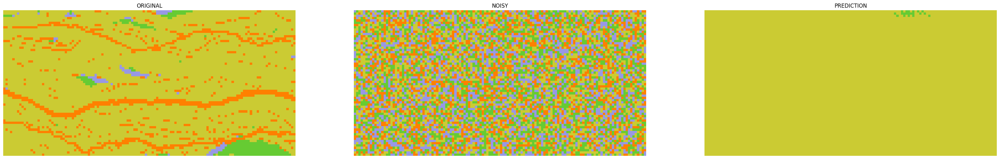

 10%|████                                    | 51/499 [07:53<1:08:08,  9.13s/it]

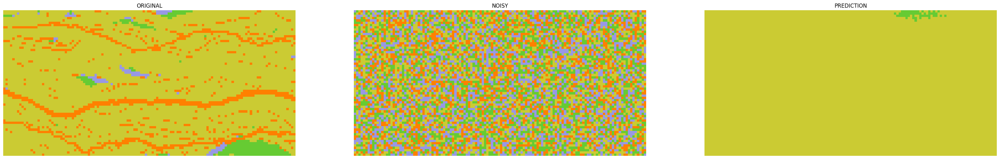

 10%|████▏                                   | 52/499 [08:02<1:07:44,  9.09s/it]

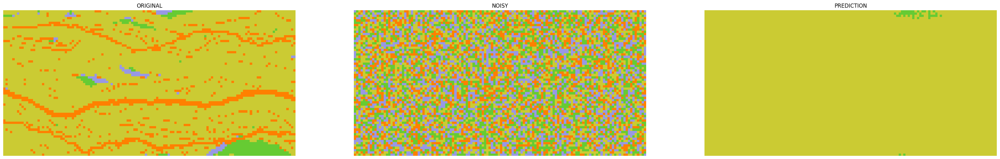

 11%|████▏                                   | 53/499 [08:11<1:07:12,  9.04s/it]

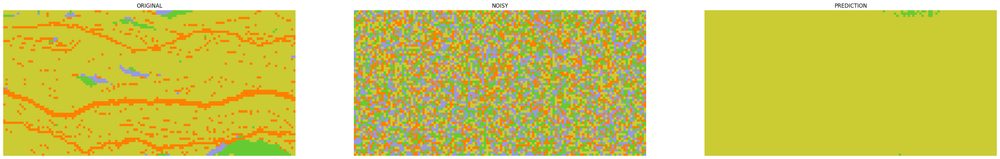

 11%|████▎                                   | 54/499 [08:20<1:06:53,  9.02s/it]

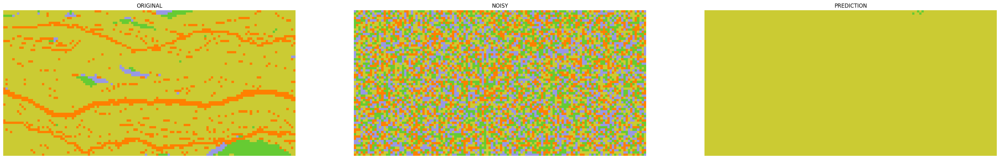

 11%|████▍                                   | 55/499 [08:29<1:06:39,  9.01s/it]

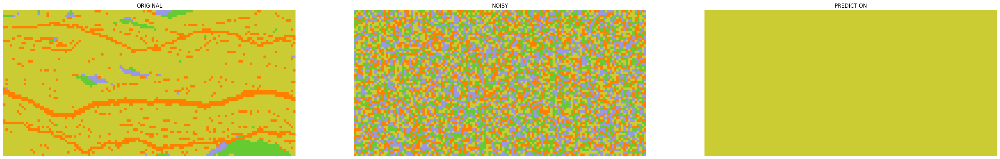

 11%|████▍                                   | 56/499 [08:38<1:06:21,  8.99s/it]

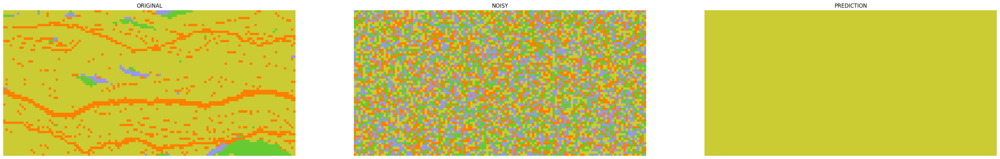

 11%|████▌                                   | 57/499 [08:47<1:06:05,  8.97s/it]

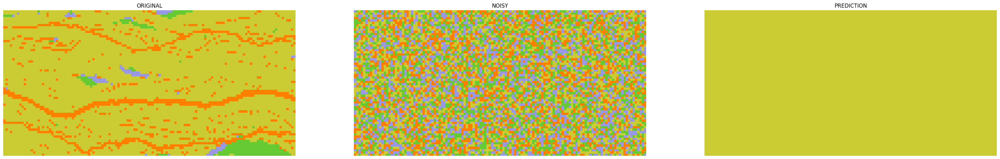

 12%|████▋                                   | 58/499 [08:56<1:05:50,  8.96s/it]

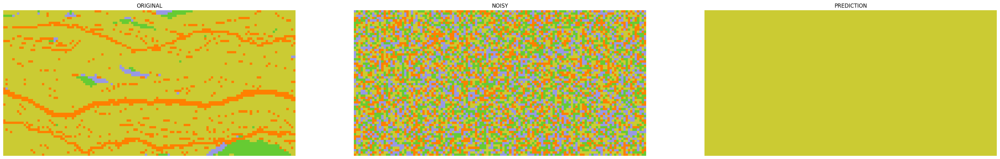

 12%|████▋                                   | 59/499 [09:05<1:05:38,  8.95s/it]

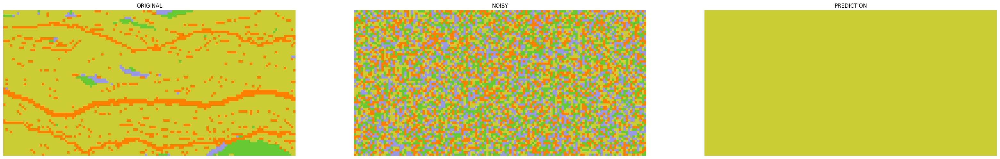

 12%|████▊                                   | 60/499 [09:14<1:05:34,  8.96s/it]

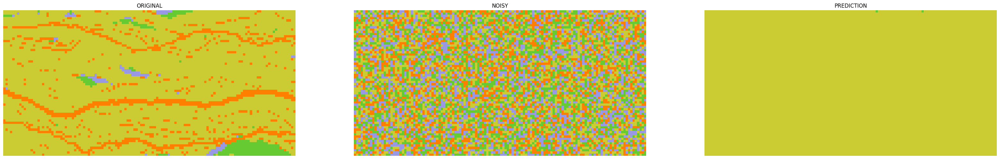

 12%|████▉                                   | 61/499 [09:23<1:05:21,  8.95s/it]

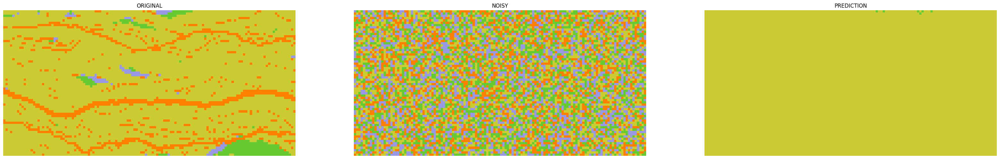

 12%|████▉                                   | 62/499 [09:32<1:05:11,  8.95s/it]

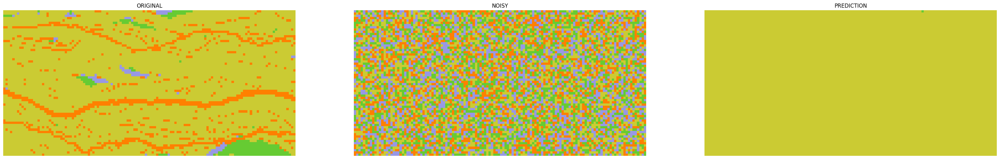

 13%|█████                                   | 63/499 [09:41<1:05:01,  8.95s/it]

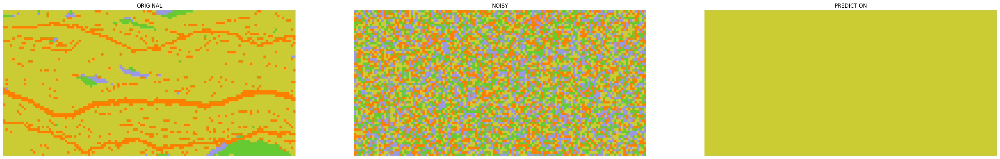

 13%|█████▏                                  | 64/499 [09:50<1:04:52,  8.95s/it]

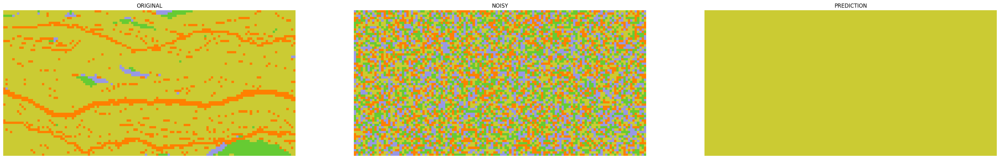

 13%|█████▏                                  | 65/499 [09:58<1:04:36,  8.93s/it]

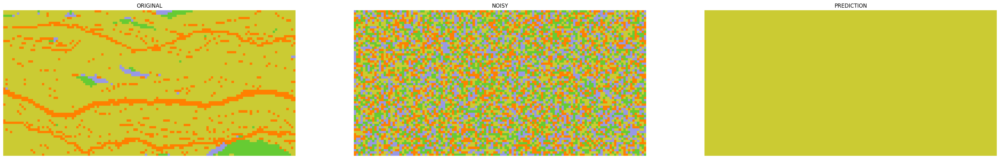

 13%|█████▎                                  | 66/499 [10:07<1:04:25,  8.93s/it]

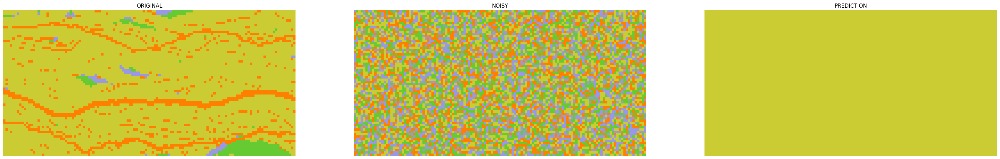

 13%|█████▎                                  | 67/499 [10:16<1:04:13,  8.92s/it]

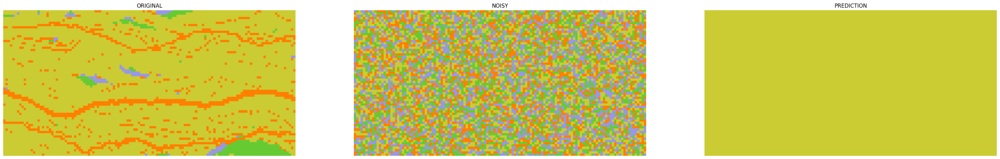

 14%|█████▍                                  | 68/499 [10:25<1:04:01,  8.91s/it]

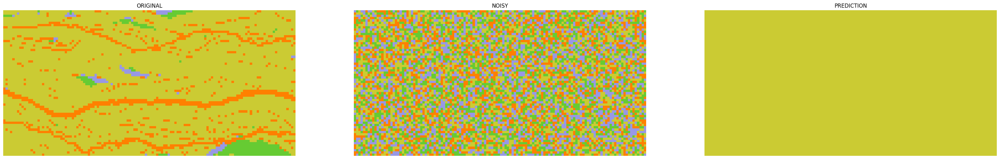

 14%|█████▌                                  | 69/499 [10:34<1:03:55,  8.92s/it]

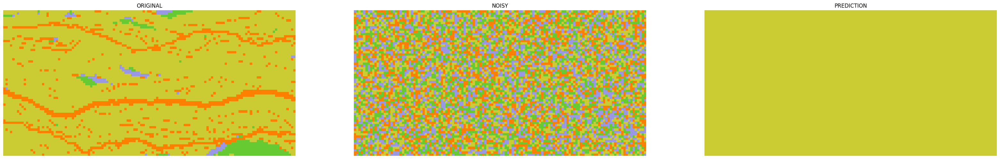

 14%|█████▌                                  | 70/499 [10:43<1:03:51,  8.93s/it]

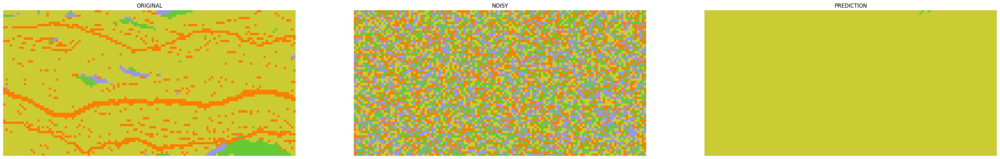

 14%|█████▋                                  | 71/499 [10:52<1:03:38,  8.92s/it]

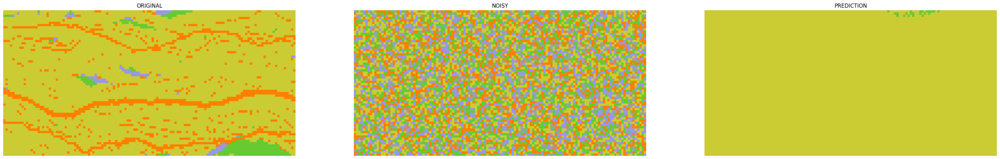

 14%|█████▊                                  | 72/499 [11:01<1:03:31,  8.93s/it]

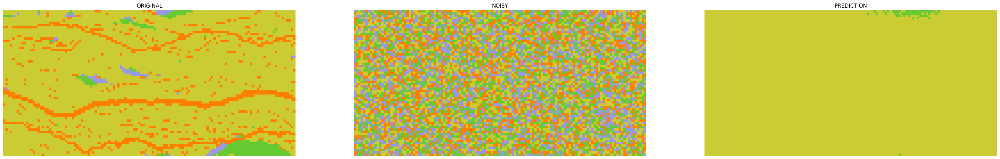

 15%|█████▊                                  | 73/499 [11:10<1:03:19,  8.92s/it]

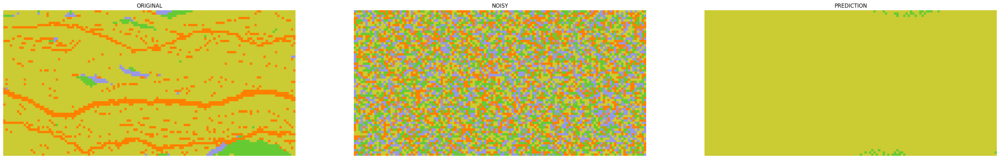

 15%|█████▉                                  | 74/499 [11:19<1:03:08,  8.91s/it]

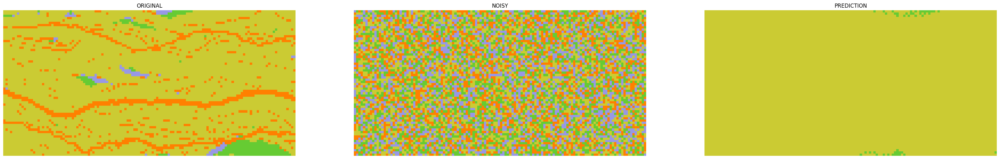

 15%|██████                                  | 75/499 [11:28<1:03:05,  8.93s/it]

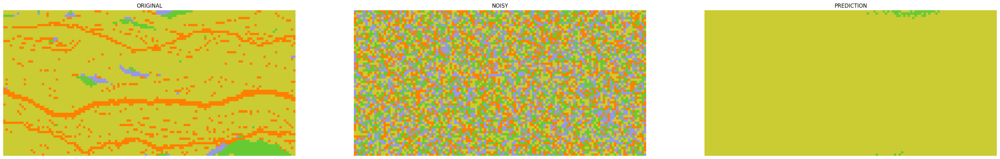

 15%|██████                                  | 76/499 [11:37<1:02:57,  8.93s/it]

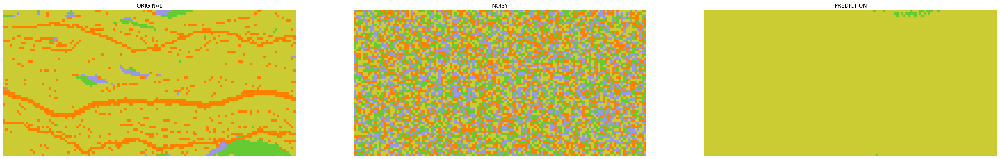

 15%|██████▏                                 | 77/499 [11:45<1:02:38,  8.91s/it]

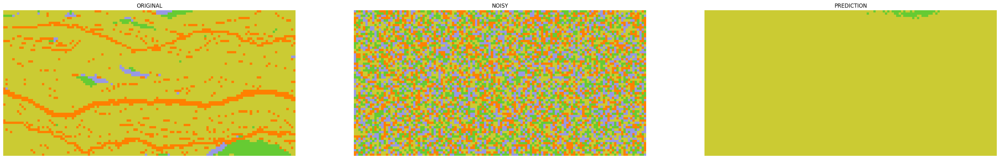

 16%|██████▎                                 | 78/499 [11:54<1:02:34,  8.92s/it]

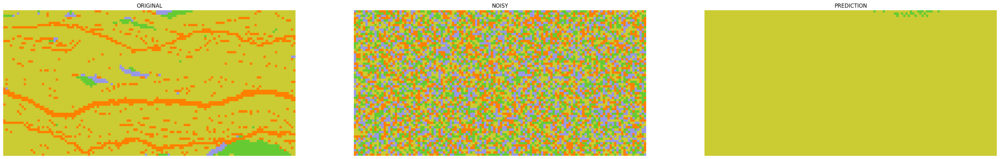

 16%|██████▎                                 | 79/499 [12:03<1:02:30,  8.93s/it]

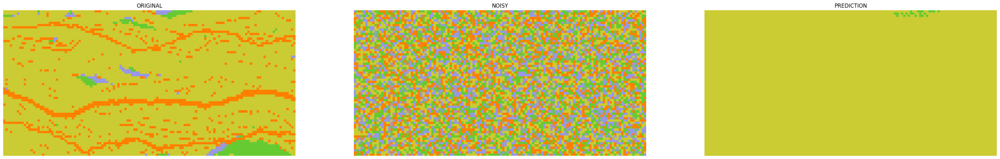

 16%|██████▍                                 | 80/499 [12:12<1:02:15,  8.92s/it]

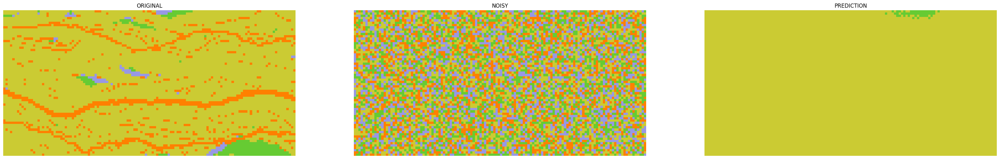

 16%|██████▍                                 | 81/499 [12:21<1:02:07,  8.92s/it]

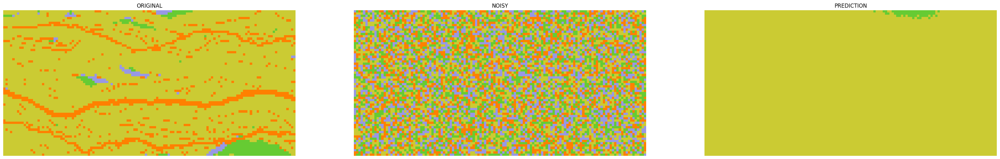

 16%|██████▌                                 | 82/499 [12:30<1:02:01,  8.93s/it]

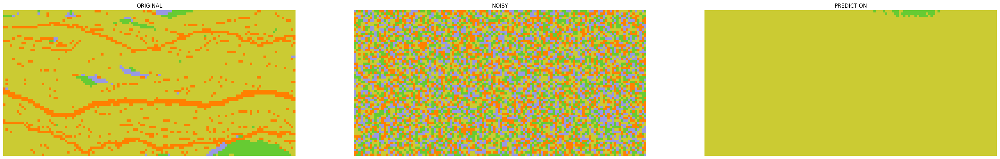

 17%|██████▋                                 | 83/499 [12:39<1:01:53,  8.93s/it]

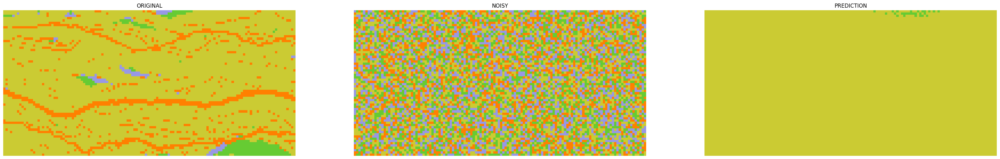

 17%|██████▋                                 | 84/499 [12:48<1:01:42,  8.92s/it]

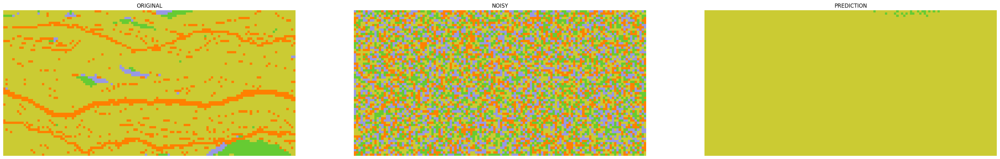

 17%|██████▊                                 | 85/499 [12:57<1:01:33,  8.92s/it]

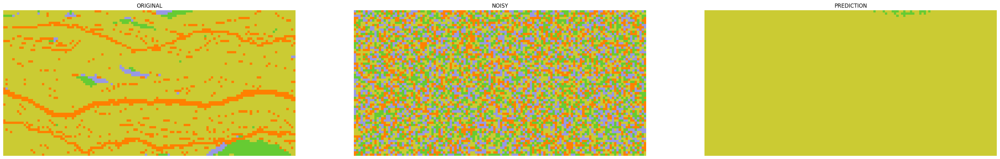

 17%|██████▉                                 | 86/499 [13:06<1:01:25,  8.92s/it]

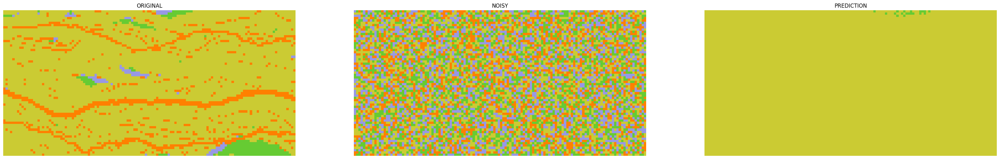

 17%|██████▉                                 | 87/499 [13:15<1:01:11,  8.91s/it]

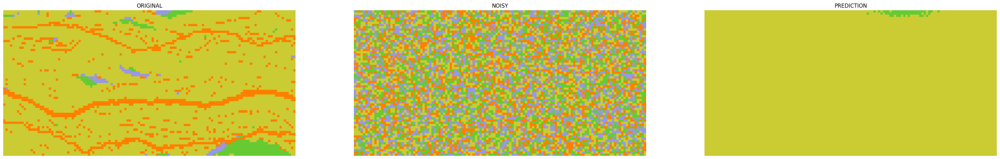

 18%|███████                                 | 88/499 [13:24<1:01:04,  8.92s/it]

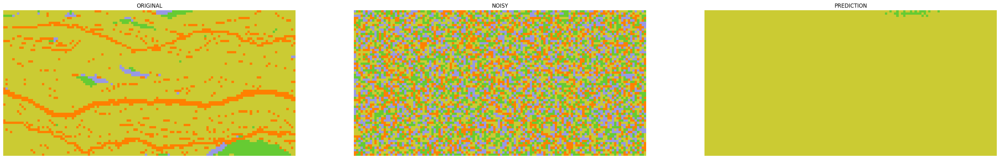

 18%|███████▏                                | 89/499 [13:32<1:00:55,  8.92s/it]

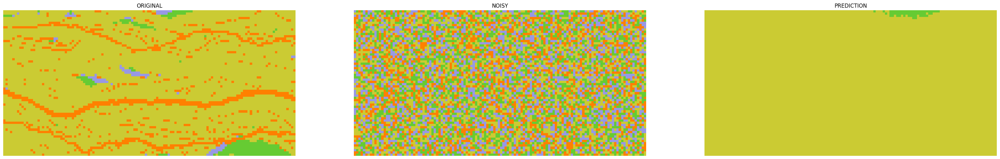

 18%|███████▏                                | 90/499 [13:41<1:00:55,  8.94s/it]

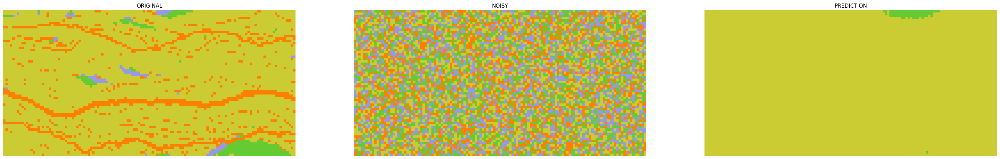

 18%|███████▎                                | 91/499 [13:50<1:00:44,  8.93s/it]

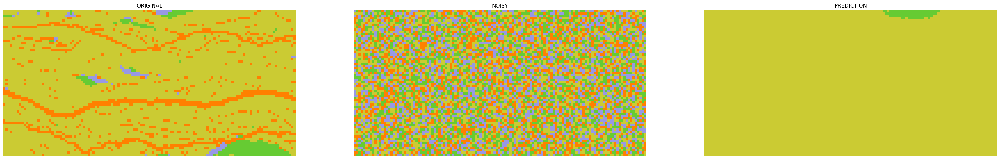

 18%|███████▎                                | 92/499 [13:59<1:00:39,  8.94s/it]

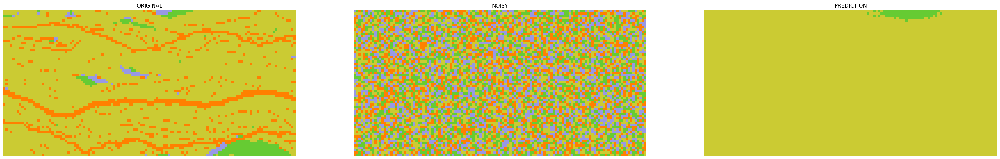

 19%|███████▍                                | 93/499 [14:08<1:00:27,  8.93s/it]

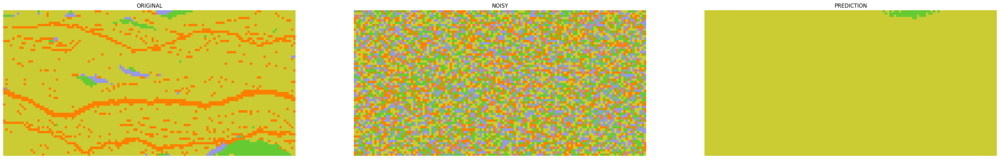

 19%|███████▌                                | 94/499 [14:17<1:00:10,  8.92s/it]

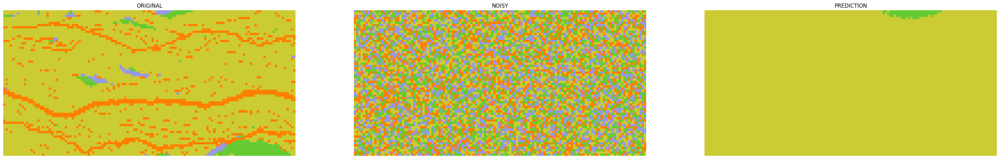

 19%|███████▌                                | 95/499 [14:27<1:02:14,  9.24s/it]

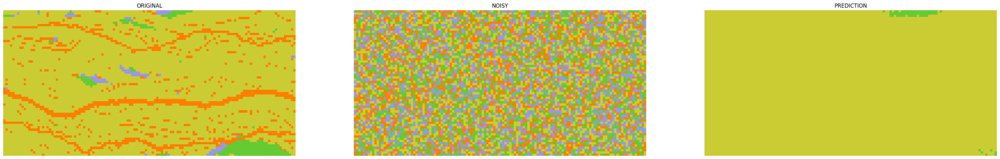

 19%|███████▋                                | 96/499 [14:36<1:01:21,  9.13s/it]

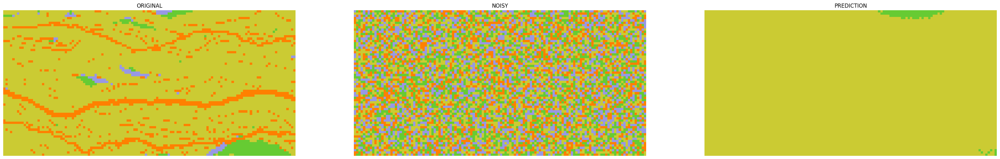

 19%|███████▊                                | 97/499 [14:45<1:00:47,  9.07s/it]

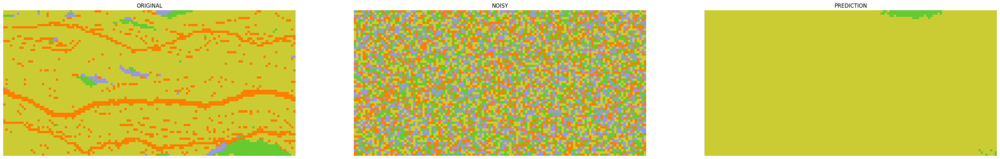

 20%|███████▊                                | 98/499 [14:54<1:00:25,  9.04s/it]

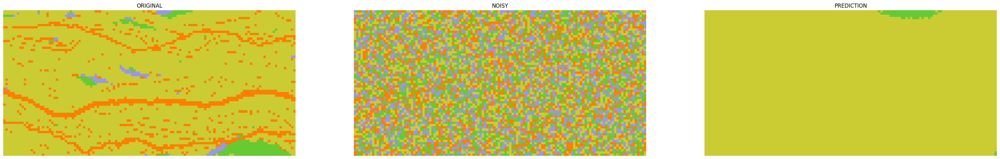

 20%|███████▉                                | 99/499 [15:03<1:00:05,  9.01s/it]

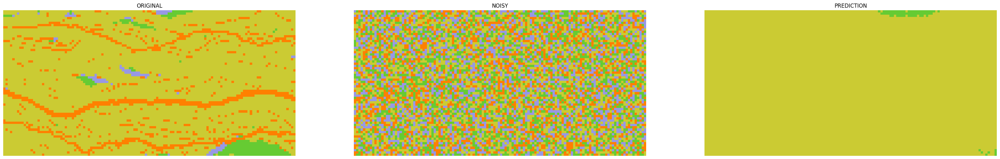

 20%|████████▏                                | 100/499 [15:12<59:46,  8.99s/it]

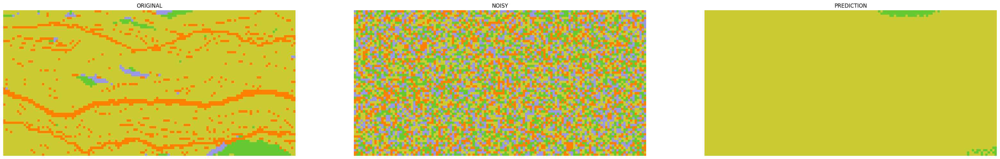

 20%|████████▎                                | 101/499 [15:21<59:27,  8.96s/it]

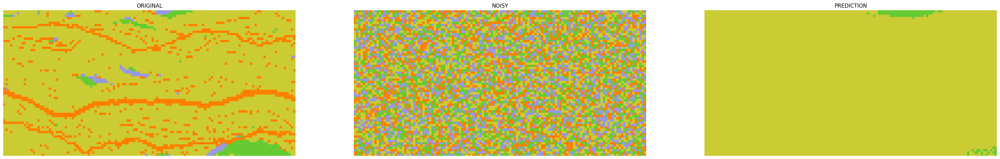

 20%|████████▍                                | 102/499 [15:30<59:11,  8.94s/it]

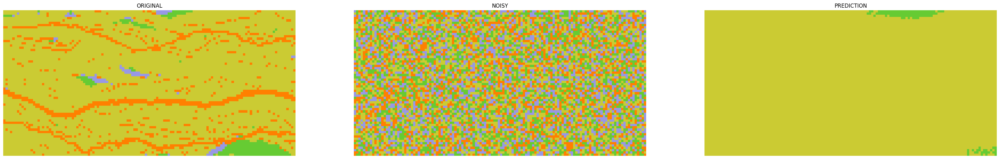

 21%|████████▍                                | 103/499 [15:39<59:01,  8.94s/it]

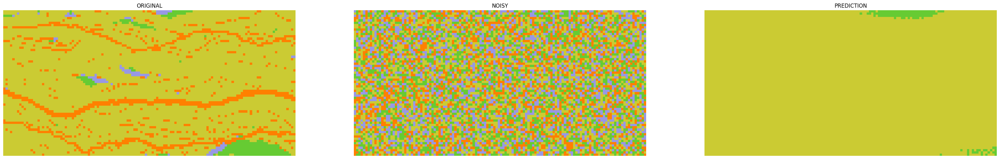

 21%|████████▌                                | 104/499 [15:47<58:44,  8.92s/it]

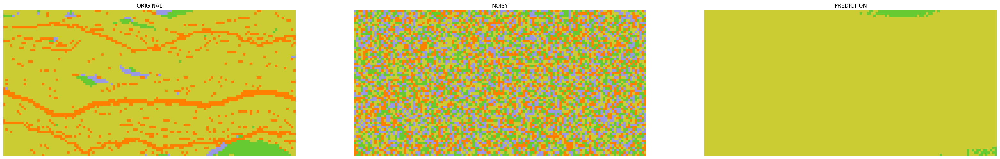

 21%|████████▋                                | 105/499 [15:56<58:38,  8.93s/it]

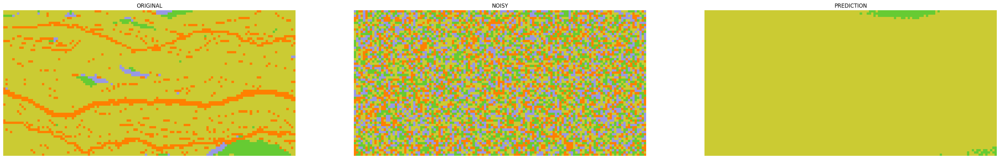

 21%|████████▋                                | 106/499 [16:05<58:29,  8.93s/it]

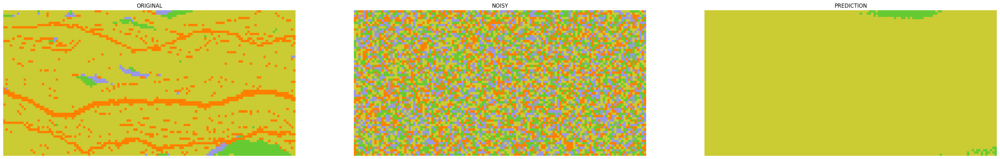

 21%|████████▊                                | 107/499 [16:14<58:20,  8.93s/it]

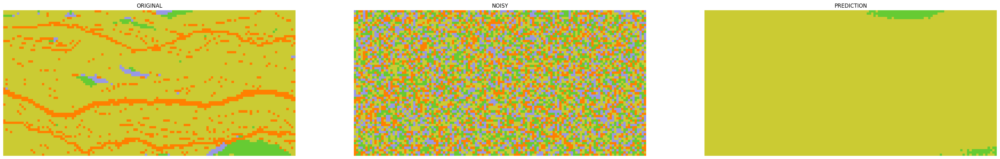

 22%|████████▊                                | 108/499 [16:23<58:14,  8.94s/it]

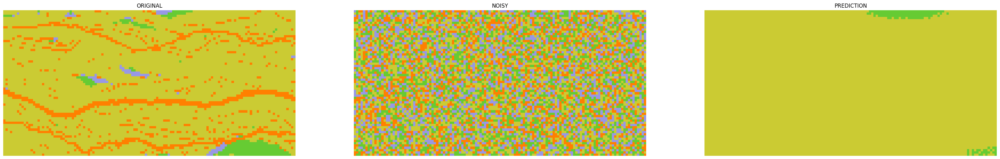

 22%|████████▉                                | 109/499 [16:32<58:06,  8.94s/it]

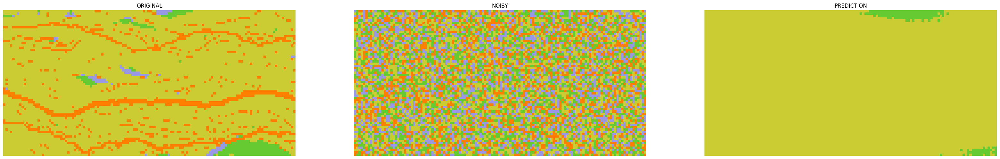

 22%|█████████                                | 110/499 [16:41<57:58,  8.94s/it]

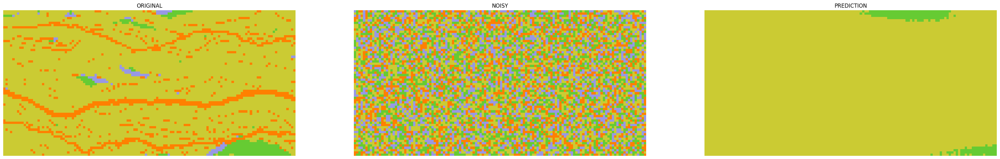

 22%|█████████                                | 111/499 [16:50<57:52,  8.95s/it]

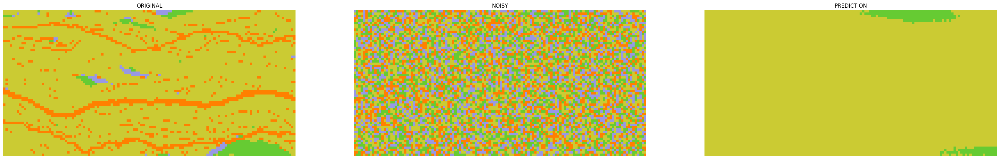

 22%|█████████▏                               | 112/499 [16:59<57:42,  8.95s/it]

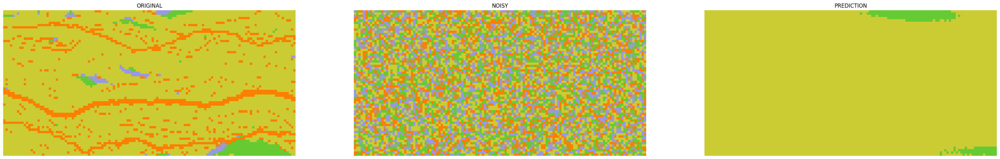

 23%|█████████▎                               | 113/499 [17:08<57:33,  8.95s/it]

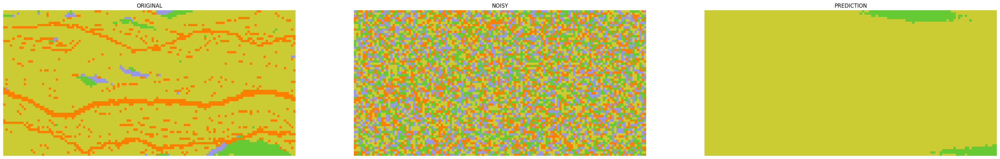

 23%|█████████▎                               | 114/499 [17:17<57:20,  8.94s/it]

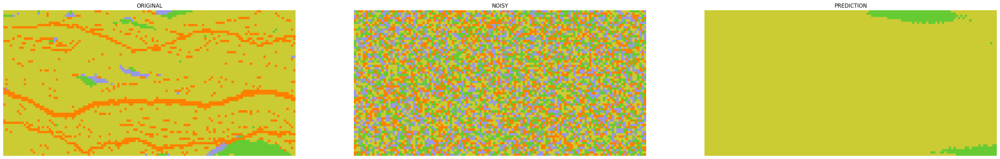

 23%|█████████▍                               | 115/499 [17:26<57:09,  8.93s/it]

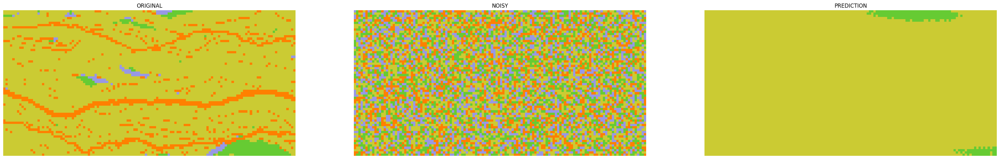

 23%|█████████▌                               | 116/499 [17:35<57:04,  8.94s/it]

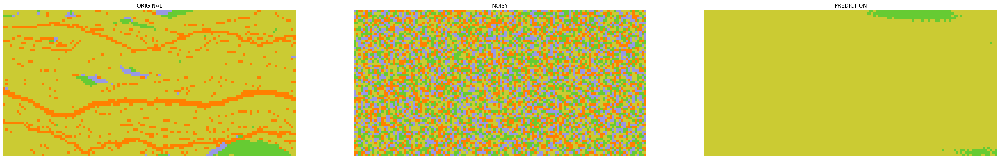

 23%|█████████▌                               | 117/499 [17:44<57:02,  8.96s/it]

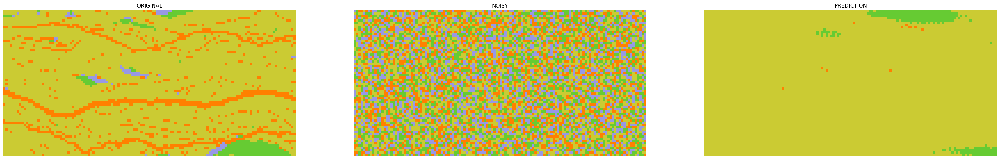

 24%|█████████▋                               | 118/499 [17:53<56:48,  8.95s/it]

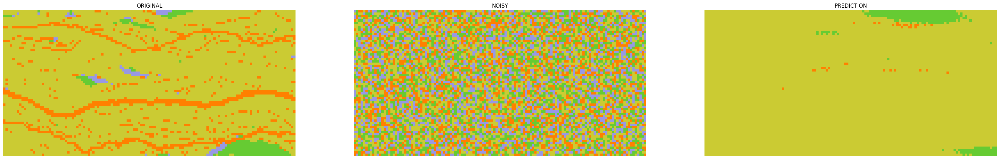

 24%|█████████▊                               | 119/499 [18:02<56:37,  8.94s/it]

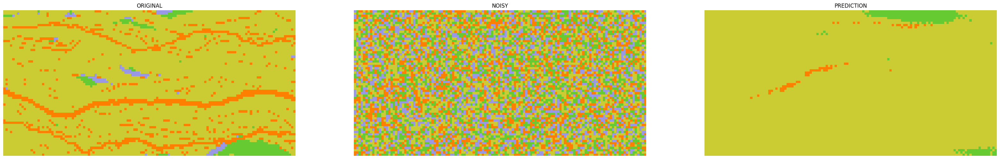

 24%|█████████▊                               | 120/499 [18:11<56:28,  8.94s/it]

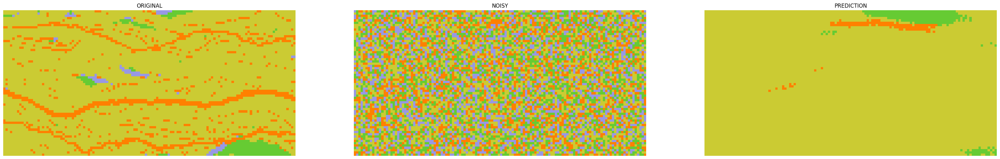

 24%|█████████▉                               | 121/499 [18:19<56:13,  8.92s/it]

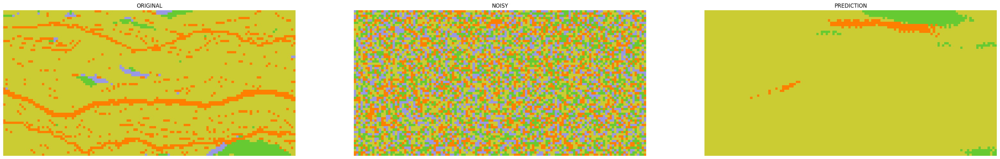

 24%|██████████                               | 122/499 [18:28<56:05,  8.93s/it]

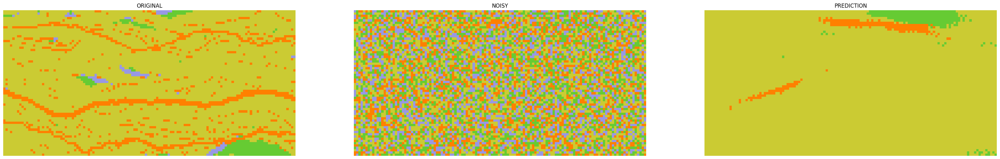

 25%|██████████                               | 123/499 [18:37<56:00,  8.94s/it]

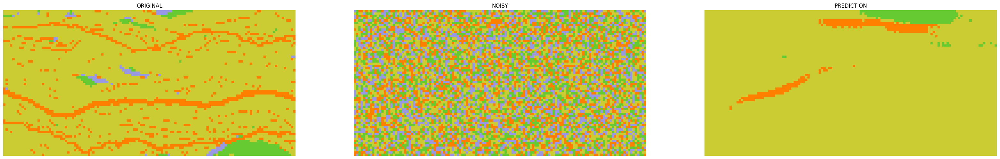

 25%|██████████▏                              | 124/499 [18:46<55:51,  8.94s/it]

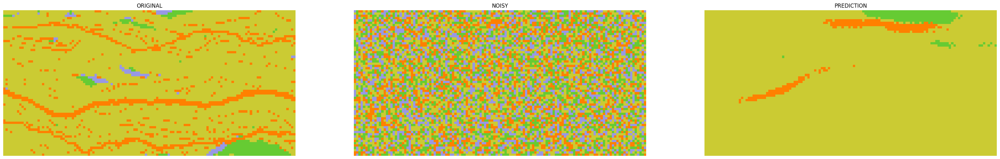

 25%|██████████▎                              | 125/499 [18:55<55:40,  8.93s/it]

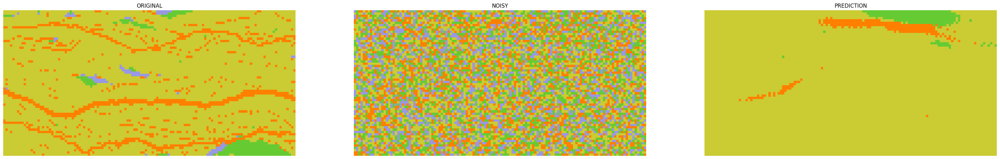

 25%|██████████▎                              | 126/499 [19:04<55:33,  8.94s/it]

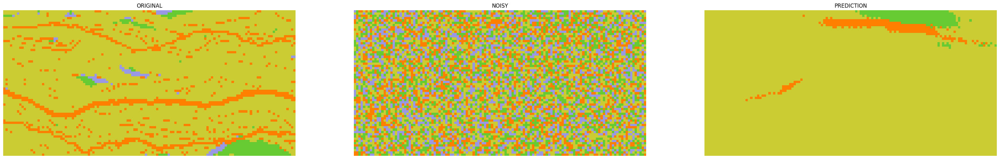

 25%|██████████▍                              | 127/499 [19:13<55:24,  8.94s/it]

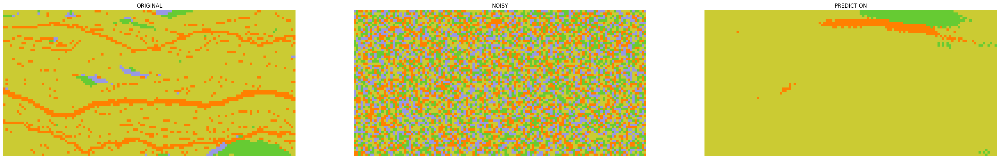

 26%|██████████▌                              | 128/499 [19:22<55:15,  8.94s/it]

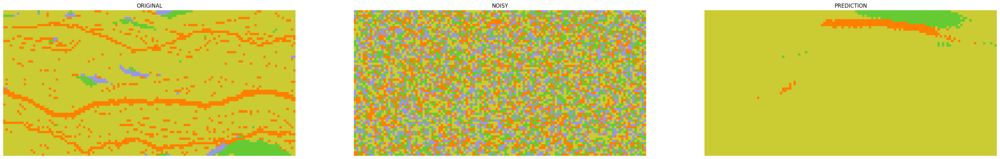

 26%|██████████▌                              | 129/499 [19:31<55:04,  8.93s/it]

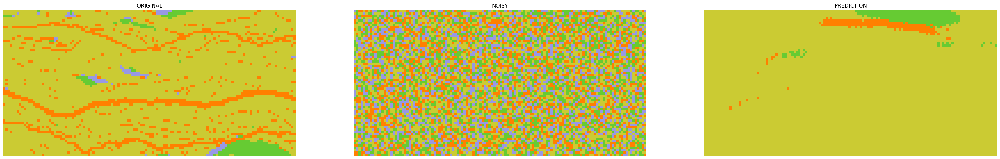

 26%|██████████▋                              | 130/499 [19:40<54:56,  8.93s/it]

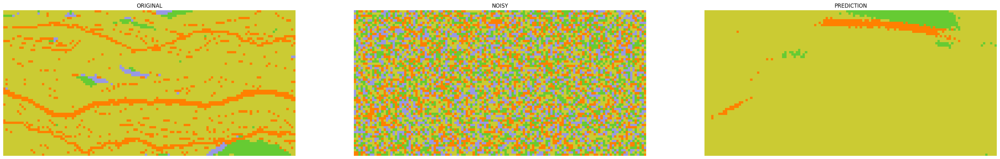

 26%|██████████▊                              | 131/499 [19:49<54:46,  8.93s/it]

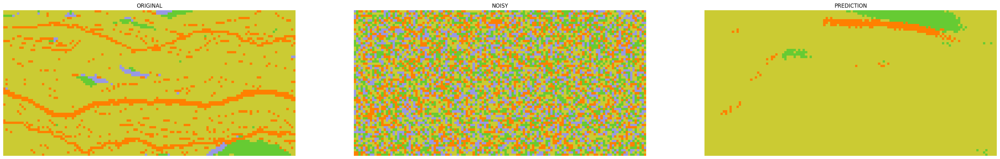

 26%|██████████▊                              | 132/499 [19:58<54:35,  8.93s/it]

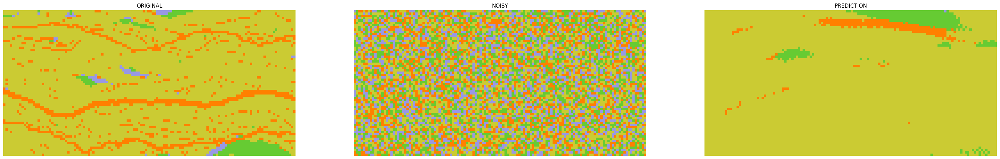

 27%|██████████▉                              | 133/499 [20:07<54:29,  8.93s/it]

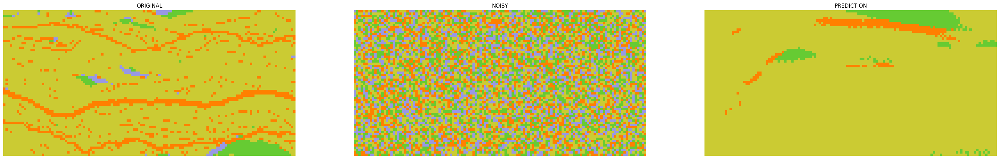

 27%|███████████                              | 134/499 [20:16<54:14,  8.92s/it]

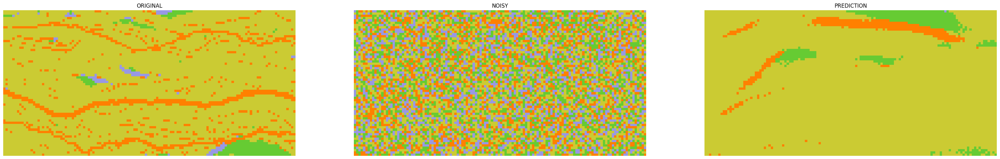

 27%|███████████                              | 135/499 [20:24<54:12,  8.94s/it]

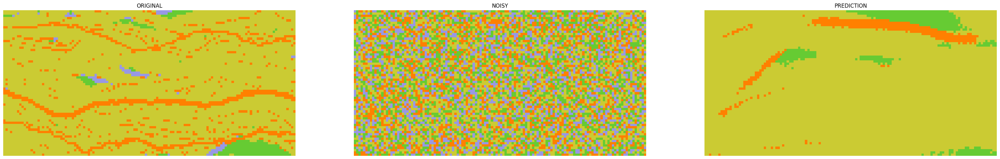

 27%|███████████▏                             | 136/499 [20:33<54:00,  8.93s/it]

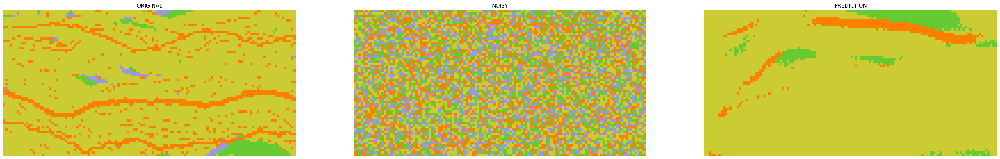

 27%|███████████▎                             | 137/499 [20:42<53:47,  8.92s/it]

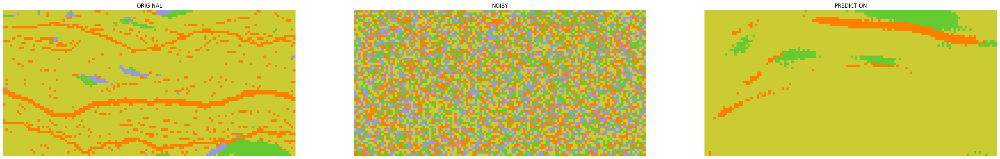

 28%|███████████▎                             | 138/499 [20:51<53:39,  8.92s/it]

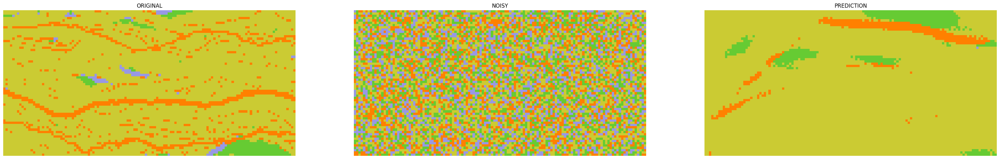

 28%|███████████▍                             | 139/499 [21:00<53:31,  8.92s/it]

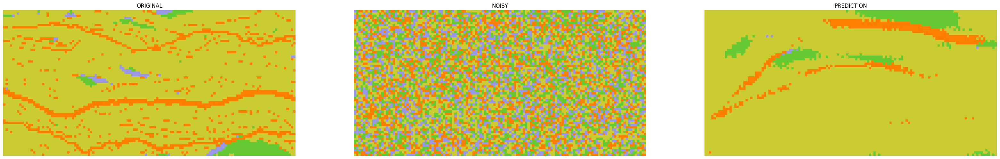

 28%|███████████▌                             | 140/499 [21:10<55:23,  9.26s/it]

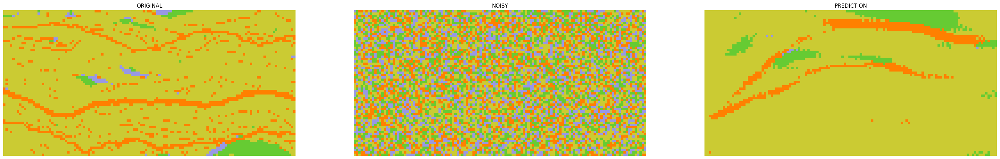

 28%|███████████▌                             | 141/499 [21:19<54:36,  9.15s/it]

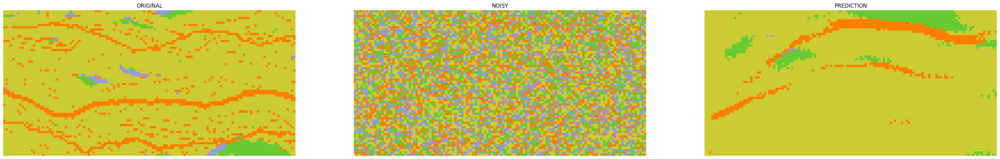

 28%|███████████▋                             | 142/499 [21:28<54:03,  9.09s/it]

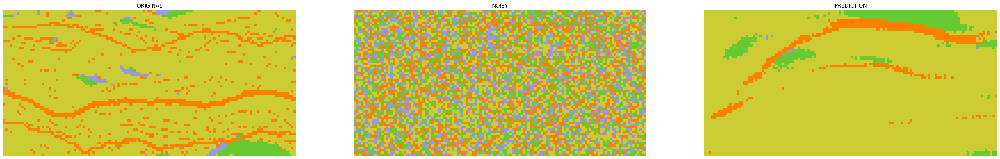

 29%|███████████▋                             | 143/499 [21:37<53:42,  9.05s/it]

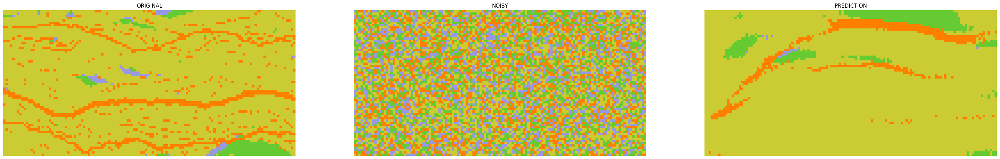

 29%|███████████▊                             | 144/499 [21:46<53:14,  9.00s/it]

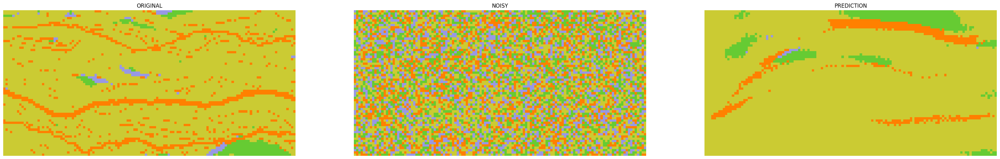

 29%|███████████▉                             | 145/499 [21:55<53:03,  8.99s/it]

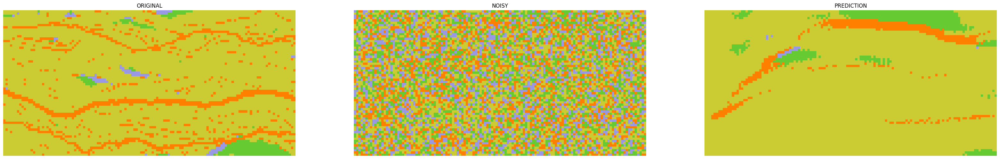

 29%|███████████▉                             | 146/499 [22:04<52:50,  8.98s/it]

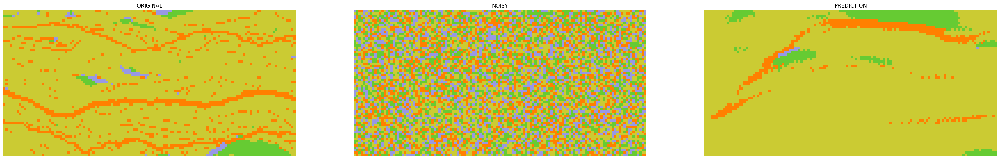

 29%|████████████                             | 147/499 [22:13<52:29,  8.95s/it]

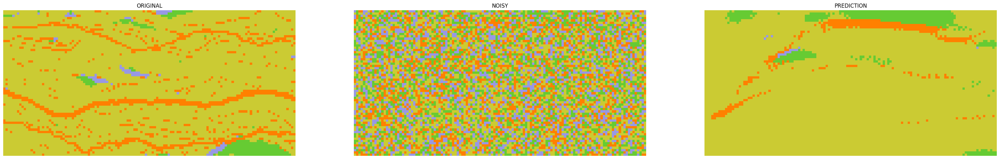

 30%|████████████▏                            | 148/499 [22:22<52:24,  8.96s/it]

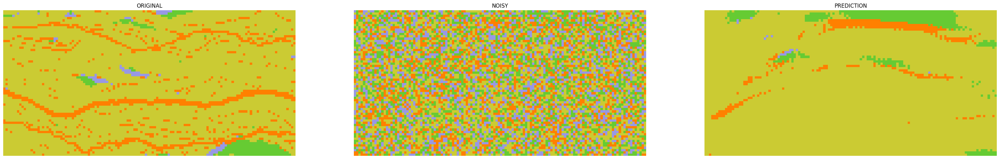

 30%|████████████▏                            | 149/499 [22:31<52:11,  8.95s/it]

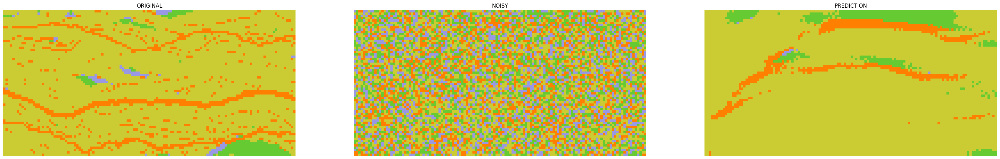

 30%|████████████▎                            | 150/499 [22:40<52:04,  8.95s/it]

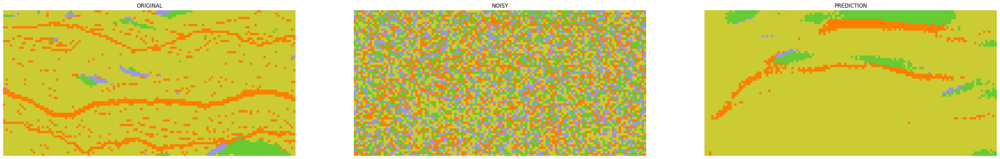

 30%|████████████▍                            | 151/499 [22:49<51:57,  8.96s/it]

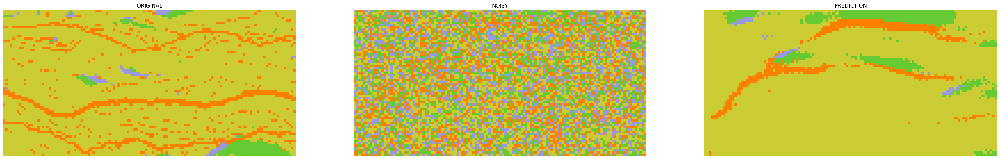

 30%|████████████▍                            | 152/499 [22:57<51:47,  8.95s/it]

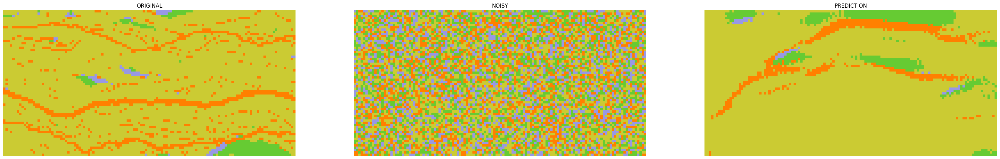

 31%|████████████▌                            | 153/499 [23:06<51:34,  8.94s/it]

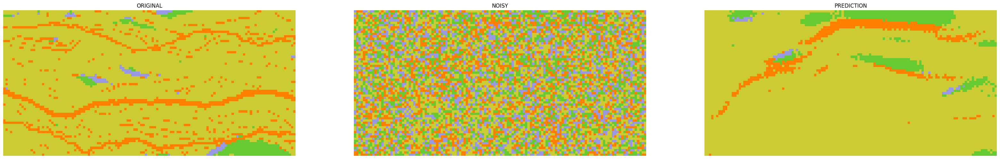

 31%|████████████▋                            | 154/499 [23:15<51:25,  8.94s/it]

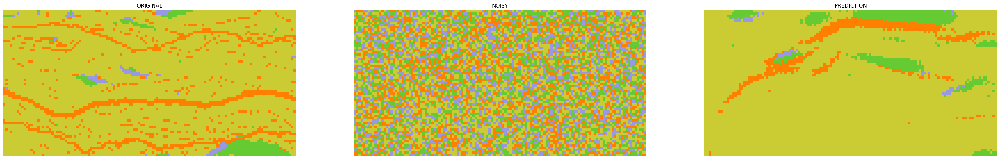

 31%|████████████▋                            | 155/499 [23:24<51:15,  8.94s/it]

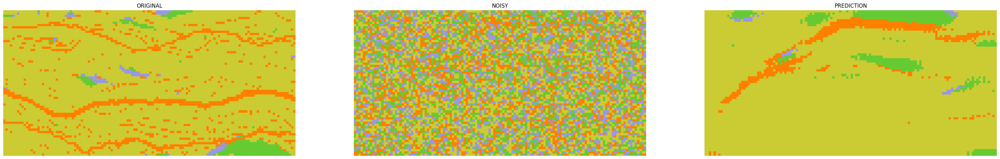

 31%|████████████▊                            | 156/499 [23:33<51:12,  8.96s/it]

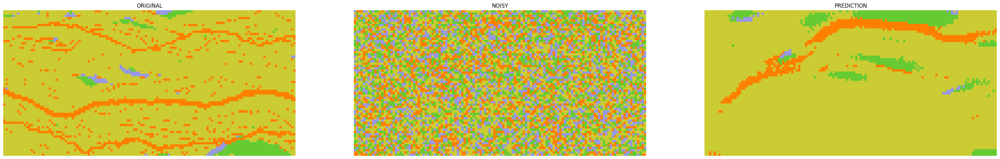

 31%|████████████▉                            | 157/499 [23:42<51:05,  8.96s/it]

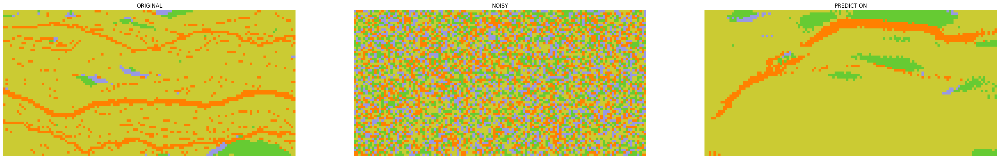

 32%|████████████▉                            | 158/499 [23:51<50:46,  8.93s/it]

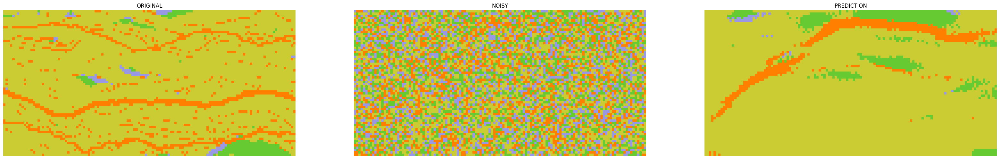

 32%|█████████████                            | 159/499 [24:00<50:35,  8.93s/it]

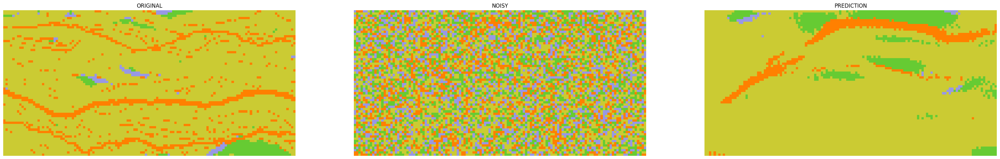

 32%|█████████████▏                           | 160/499 [24:09<50:27,  8.93s/it]

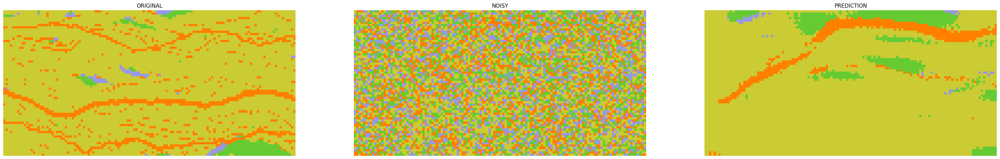

 32%|█████████████▏                           | 161/499 [24:18<50:18,  8.93s/it]

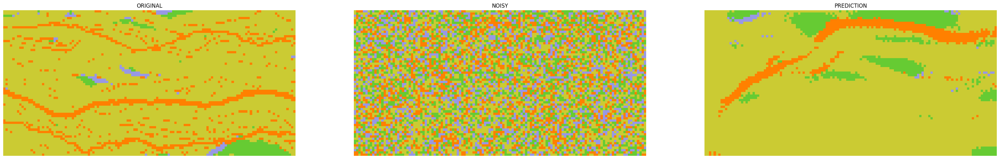

 32%|█████████████▎                           | 162/499 [24:27<50:11,  8.94s/it]

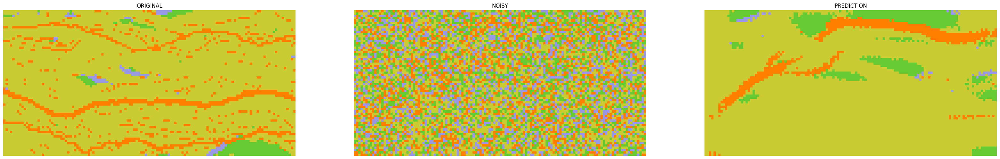

 33%|█████████████▍                           | 163/499 [24:36<50:04,  8.94s/it]

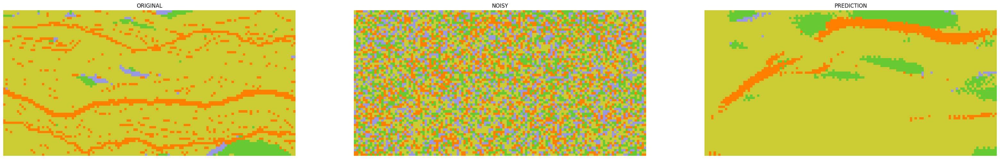

 33%|█████████████▍                           | 164/499 [24:45<49:55,  8.94s/it]

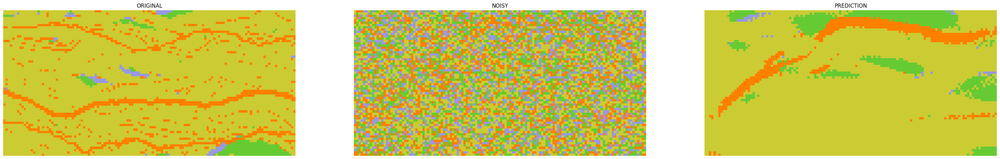

 33%|█████████████▌                           | 165/499 [24:54<49:45,  8.94s/it]

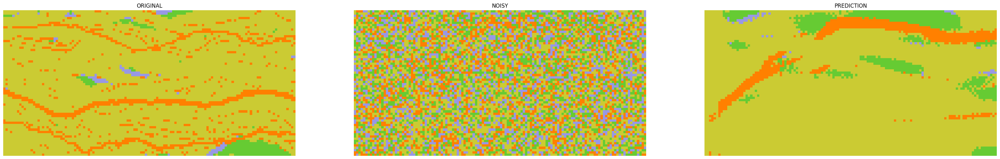

 33%|█████████████▋                           | 166/499 [25:03<49:33,  8.93s/it]

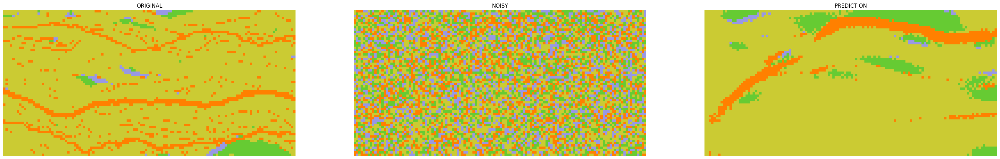

 33%|█████████████▋                           | 167/499 [25:11<49:22,  8.92s/it]

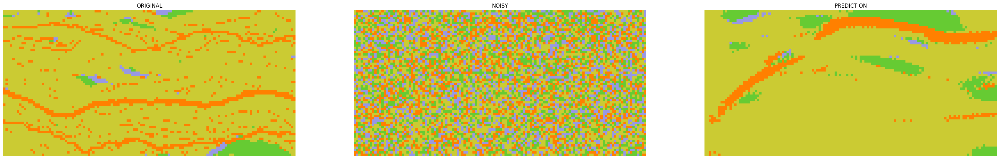

 34%|█████████████▊                           | 168/499 [25:20<49:12,  8.92s/it]

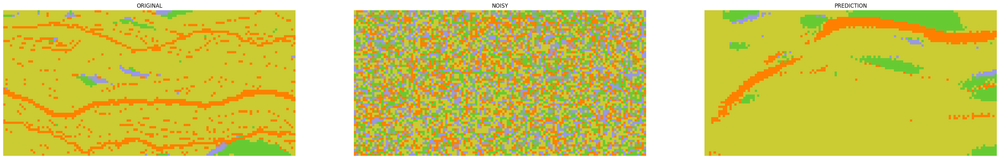

 34%|█████████████▉                           | 169/499 [25:29<49:03,  8.92s/it]

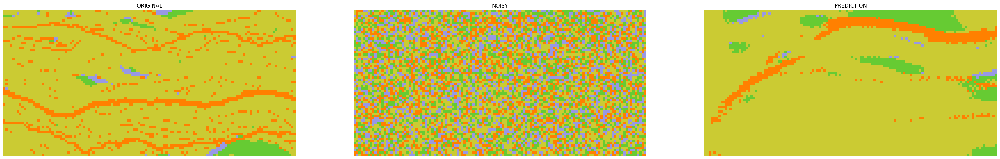

 34%|█████████████▉                           | 170/499 [25:38<48:52,  8.91s/it]

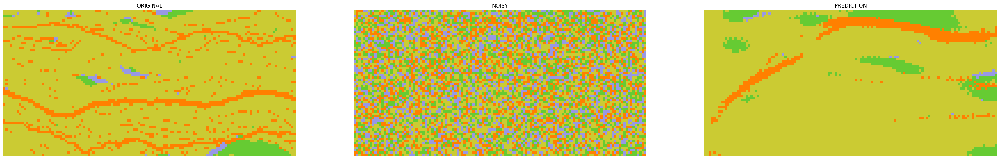

 34%|██████████████                           | 171/499 [25:47<48:38,  8.90s/it]

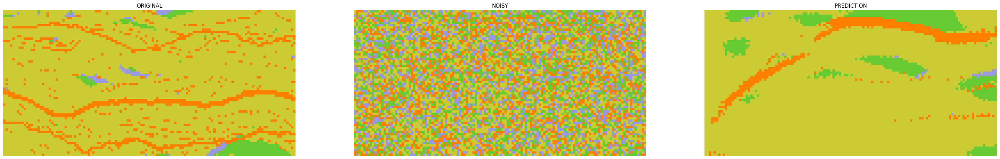

 34%|██████████████▏                          | 172/499 [25:56<48:33,  8.91s/it]

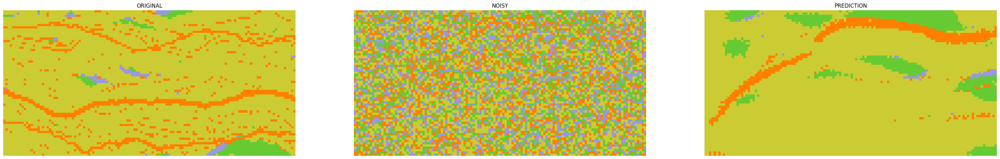

 35%|██████████████▏                          | 173/499 [26:05<48:21,  8.90s/it]

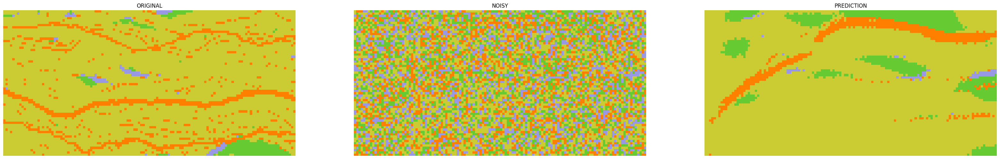

 35%|██████████████▎                          | 174/499 [26:14<48:14,  8.91s/it]

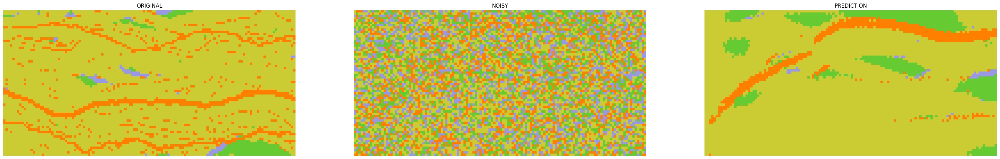

 35%|██████████████▍                          | 175/499 [26:23<48:10,  8.92s/it]

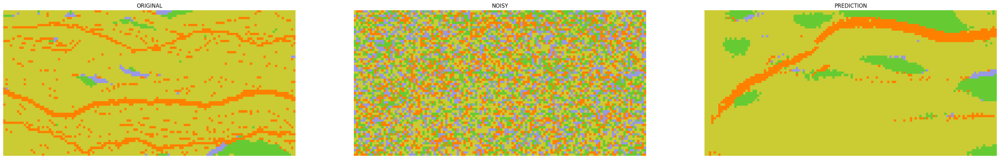

 35%|██████████████▍                          | 176/499 [26:32<48:08,  8.94s/it]

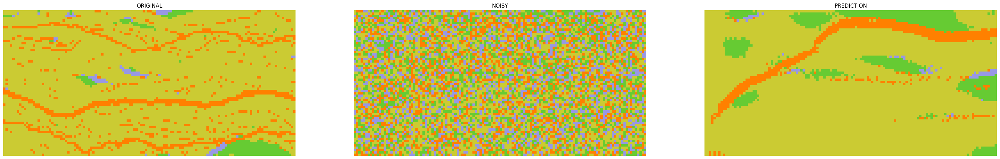

 35%|██████████████▌                          | 177/499 [26:41<47:53,  8.93s/it]

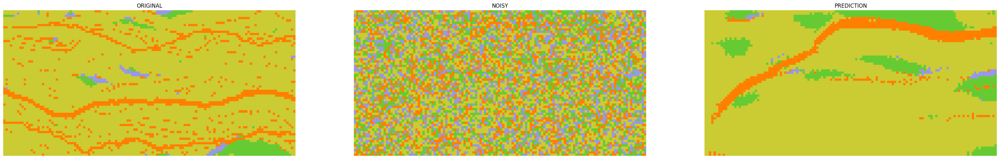

 36%|██████████████▋                          | 178/499 [26:50<47:44,  8.92s/it]

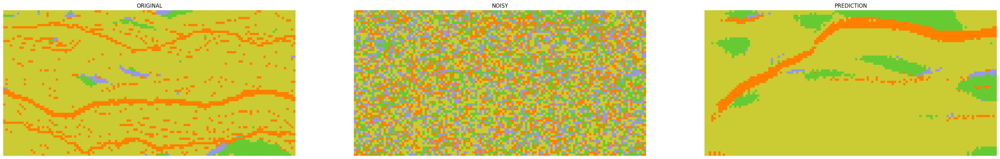

 36%|██████████████▋                          | 179/499 [26:59<47:40,  8.94s/it]

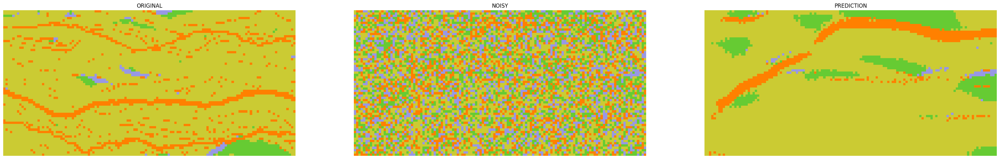

 36%|██████████████▊                          | 180/499 [27:09<49:16,  9.27s/it]

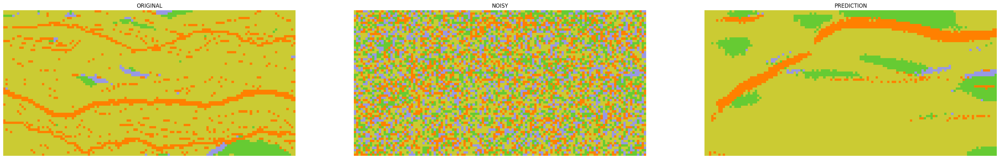

 36%|██████████████▊                          | 181/499 [27:17<48:34,  9.16s/it]

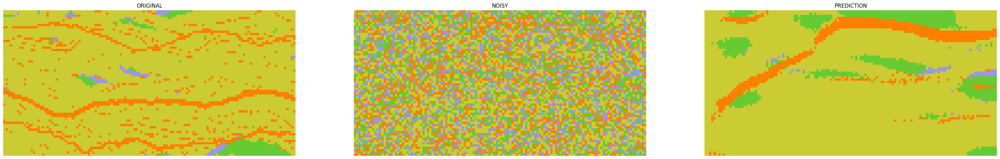

 36%|██████████████▉                          | 182/499 [27:26<48:00,  9.09s/it]

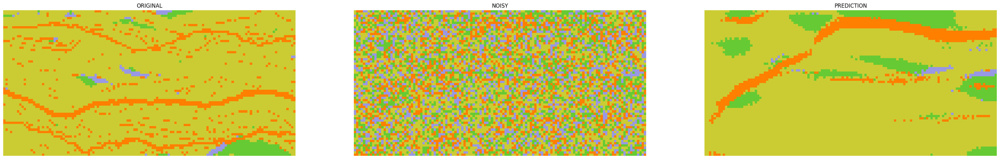

 37%|███████████████                          | 183/499 [27:35<47:34,  9.03s/it]

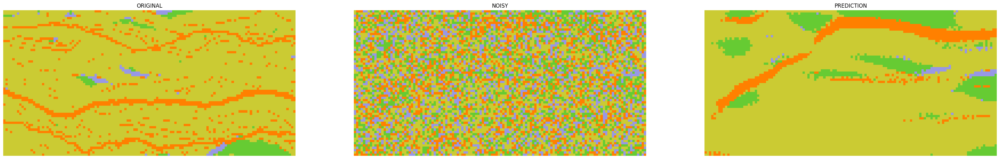

 37%|███████████████                          | 184/499 [27:44<47:12,  8.99s/it]

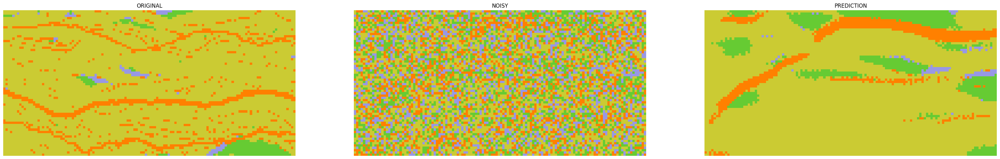

 37%|███████████████▏                         | 185/499 [27:53<47:03,  8.99s/it]

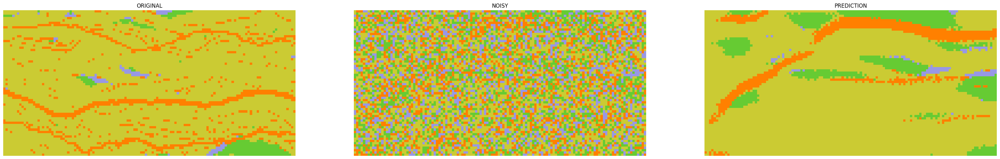

 37%|███████████████▎                         | 186/499 [28:02<46:49,  8.98s/it]

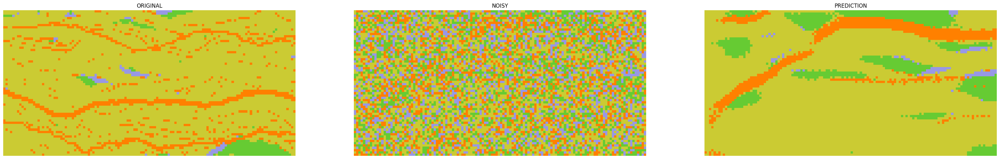

 37%|███████████████▎                         | 187/499 [28:11<46:35,  8.96s/it]

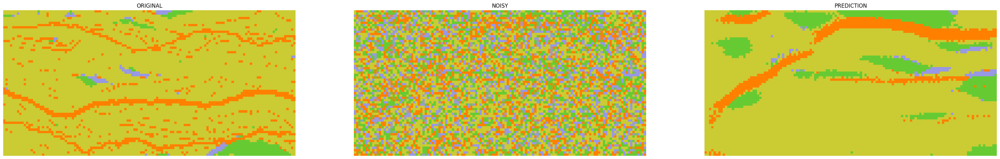

 38%|███████████████▍                         | 188/499 [28:20<46:28,  8.97s/it]

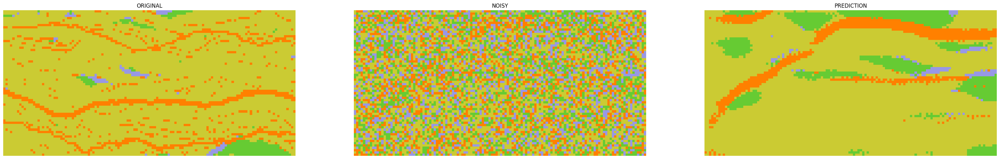

 38%|███████████████▌                         | 189/499 [28:29<46:22,  8.98s/it]

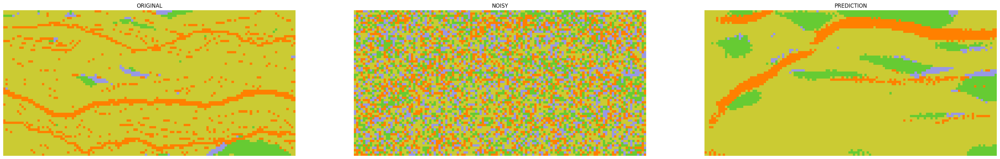

 38%|███████████████▌                         | 190/499 [28:38<46:10,  8.97s/it]

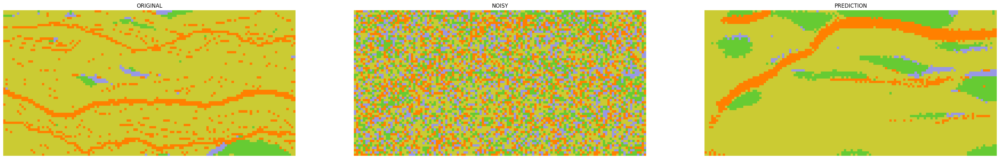

 38%|███████████████▋                         | 191/499 [28:47<46:01,  8.96s/it]

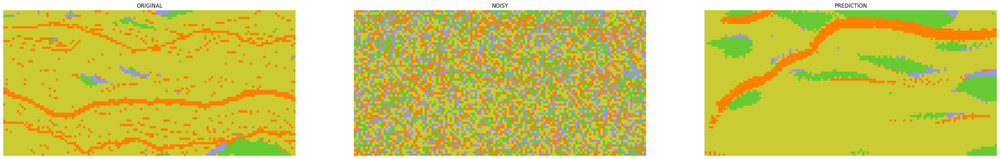

 38%|███████████████▊                         | 192/499 [28:56<45:51,  8.96s/it]

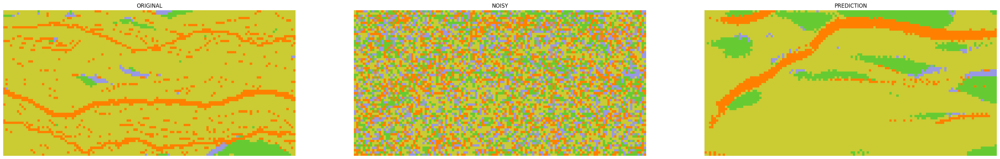

 39%|███████████████▊                         | 193/499 [29:05<45:40,  8.96s/it]

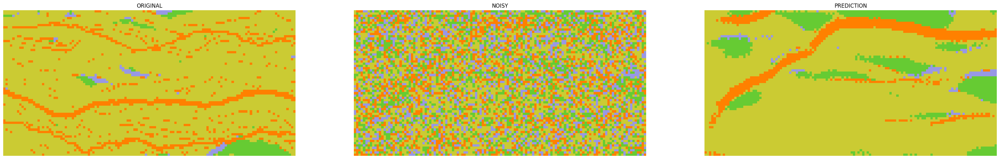

 39%|███████████████▉                         | 194/499 [29:14<45:25,  8.94s/it]

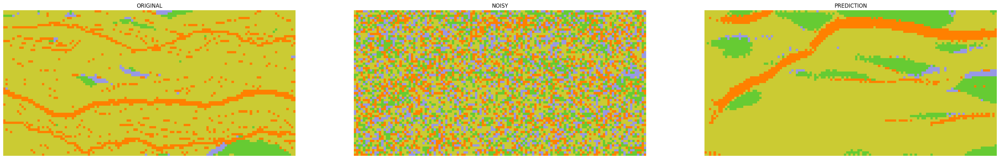

 39%|████████████████                         | 195/499 [29:23<45:16,  8.94s/it]

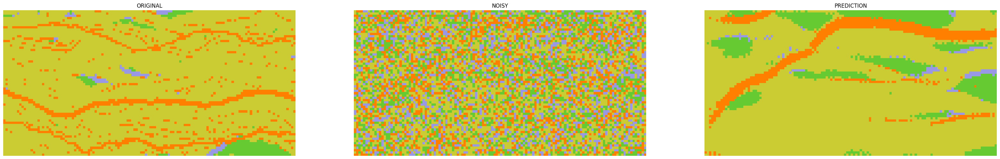

 39%|████████████████                         | 196/499 [29:32<45:10,  8.95s/it]

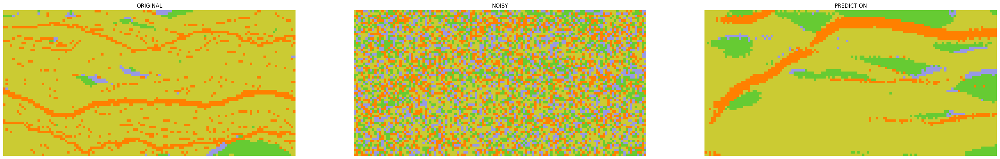

 39%|████████████████▏                        | 197/499 [29:41<45:00,  8.94s/it]

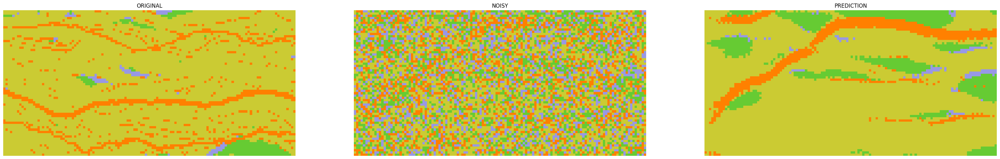

 40%|████████████████▎                        | 198/499 [29:49<44:41,  8.91s/it]

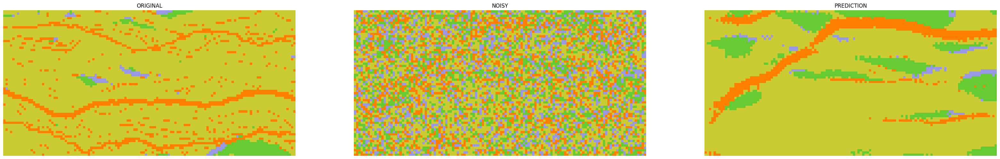

 40%|████████████████▎                        | 199/499 [29:58<44:34,  8.92s/it]

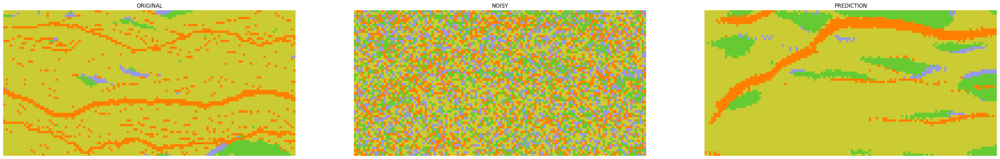

 40%|████████████████▍                        | 200/499 [30:07<44:28,  8.93s/it]

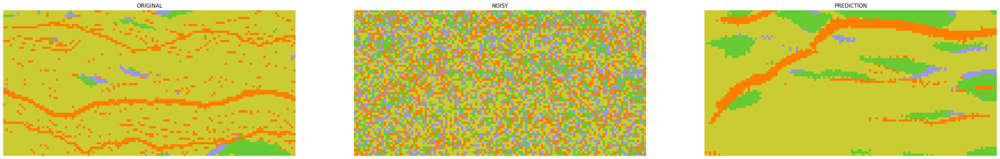

 40%|████████████████▌                        | 201/499 [30:16<44:17,  8.92s/it]

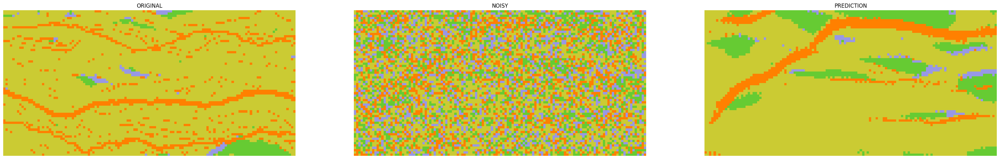

 40%|████████████████▌                        | 202/499 [30:25<44:12,  8.93s/it]

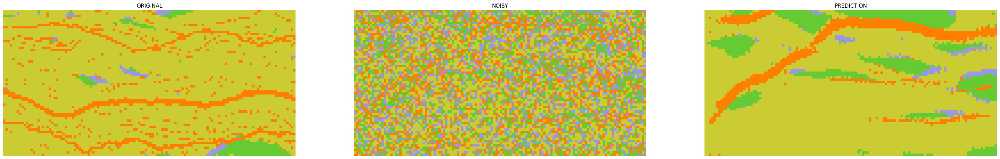

 41%|████████████████▋                        | 203/499 [30:34<44:03,  8.93s/it]

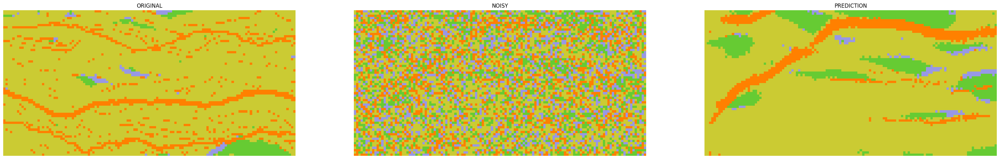

 41%|████████████████▊                        | 204/499 [30:43<43:53,  8.93s/it]

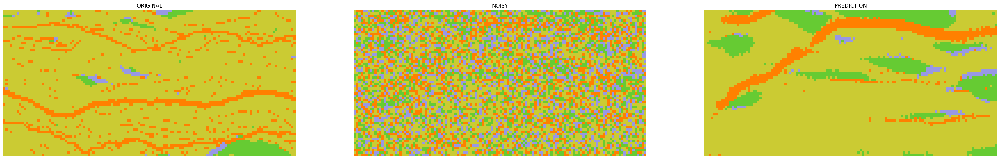

 41%|████████████████▊                        | 205/499 [30:52<43:45,  8.93s/it]

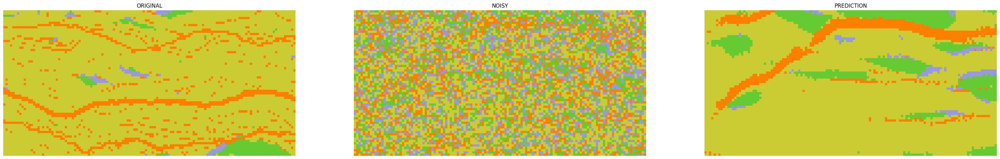

 41%|████████████████▉                        | 206/499 [31:01<43:34,  8.92s/it]

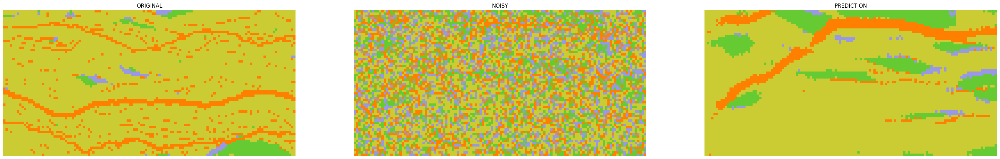

 41%|█████████████████                        | 207/499 [31:10<43:29,  8.94s/it]

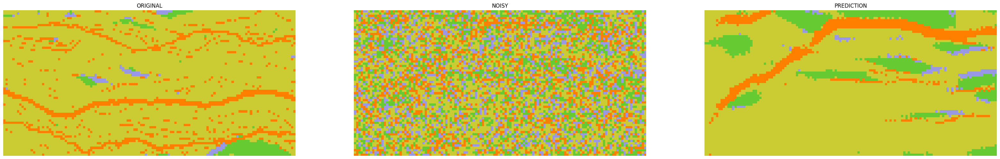

 42%|█████████████████                        | 208/499 [31:19<43:15,  8.92s/it]

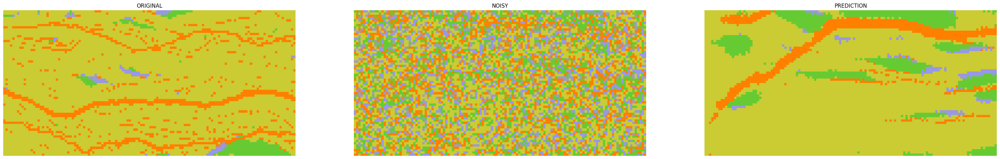

 42%|█████████████████▏                       | 209/499 [31:28<43:07,  8.92s/it]

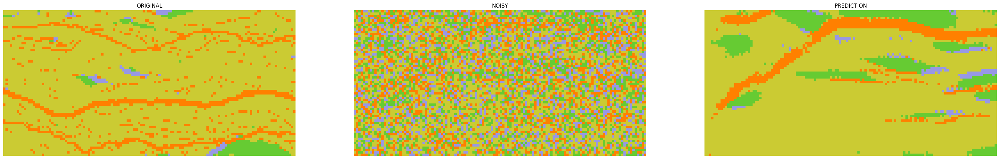

 42%|█████████████████▎                       | 210/499 [31:37<42:58,  8.92s/it]

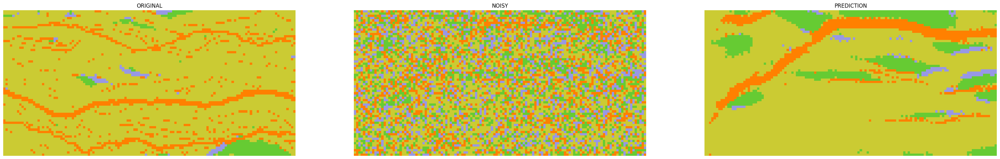

 42%|█████████████████▎                       | 211/499 [31:45<42:50,  8.92s/it]

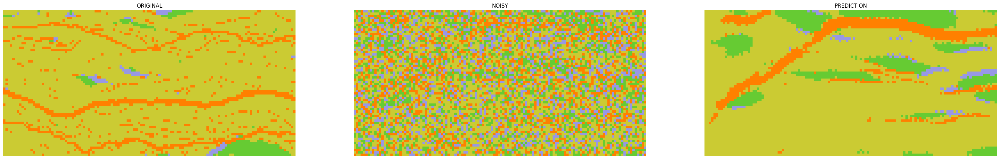

 42%|█████████████████▍                       | 212/499 [31:54<42:42,  8.93s/it]

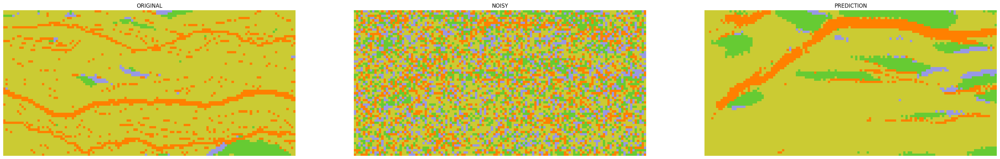

 43%|█████████████████▌                       | 213/499 [32:03<42:29,  8.91s/it]

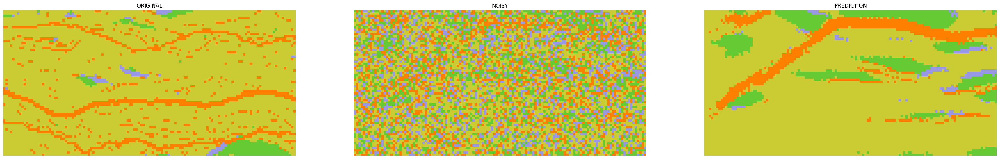

 43%|█████████████████▌                       | 214/499 [32:12<42:18,  8.91s/it]

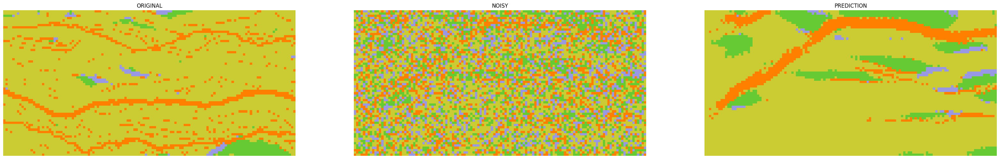

 43%|█████████████████▋                       | 215/499 [32:21<42:12,  8.92s/it]

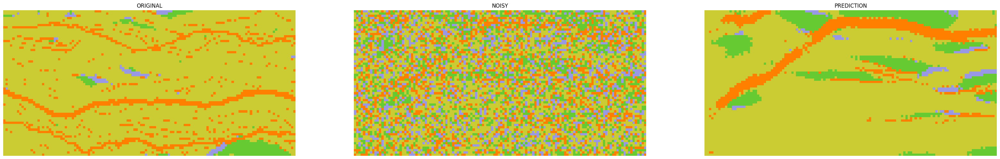

 43%|█████████████████▋                       | 216/499 [32:30<42:05,  8.93s/it]

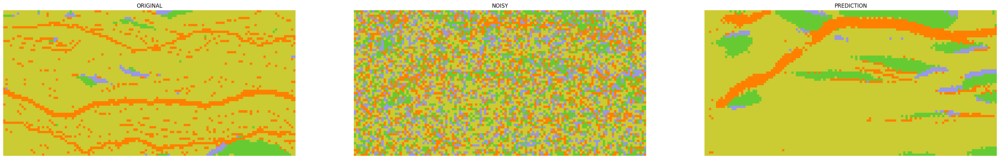

 43%|█████████████████▊                       | 217/499 [32:39<41:57,  8.93s/it]

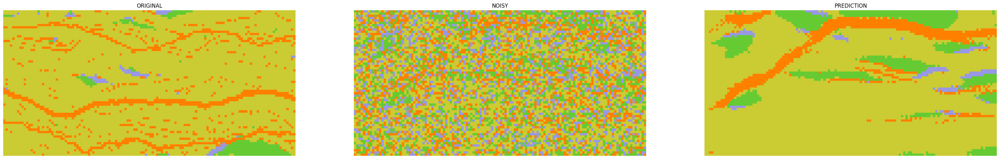

 44%|█████████████████▉                       | 218/499 [32:48<41:50,  8.93s/it]

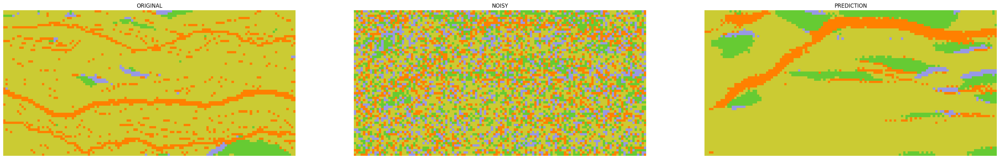

 44%|█████████████████▉                       | 219/499 [32:57<41:42,  8.94s/it]

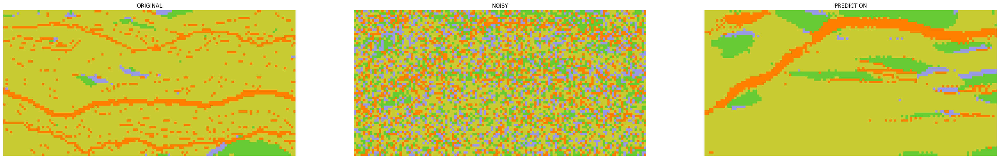

 44%|██████████████████                       | 220/499 [33:06<41:32,  8.93s/it]

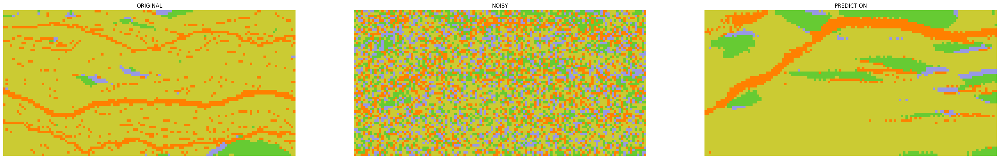

 44%|██████████████████▏                      | 221/499 [33:15<41:22,  8.93s/it]

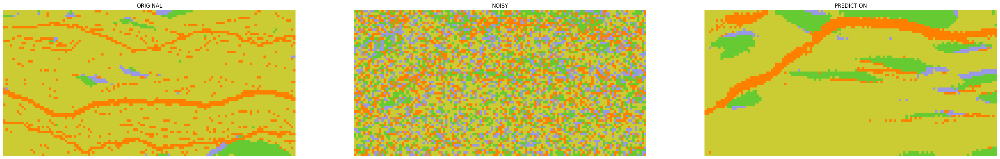

 44%|██████████████████▏                      | 222/499 [33:25<42:49,  9.27s/it]

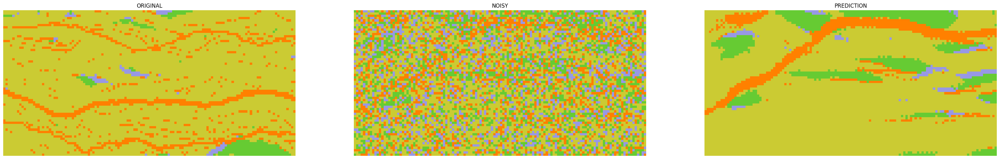

 45%|██████████████████▎                      | 223/499 [33:34<42:15,  9.19s/it]

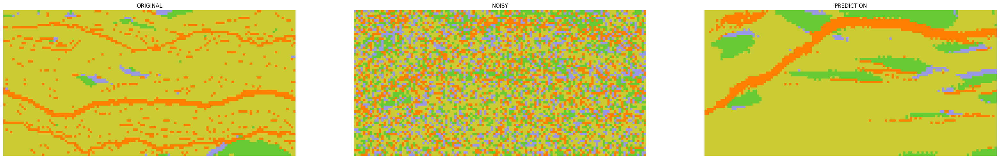

 45%|██████████████████▍                      | 224/499 [33:43<41:50,  9.13s/it]

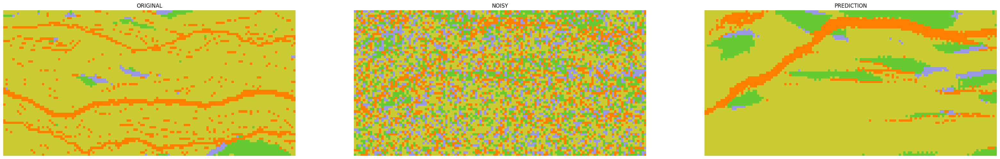

 45%|██████████████████▍                      | 225/499 [33:52<41:18,  9.05s/it]

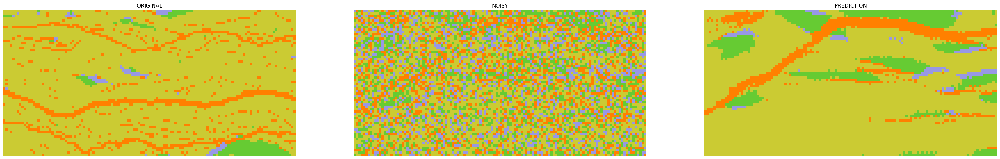

 45%|██████████████████▌                      | 226/499 [34:01<41:00,  9.01s/it]

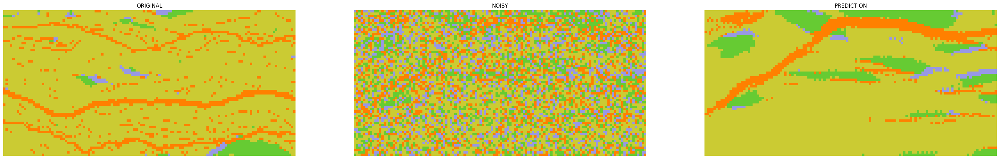

 45%|██████████████████▋                      | 227/499 [34:10<40:49,  9.00s/it]

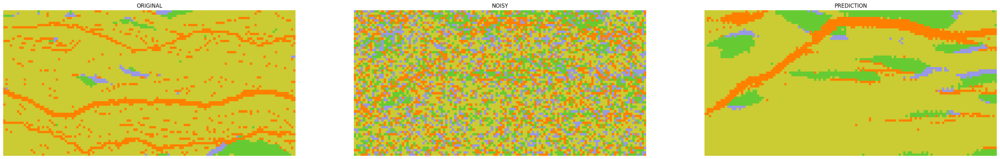

 46%|██████████████████▋                      | 228/499 [34:18<40:34,  8.98s/it]

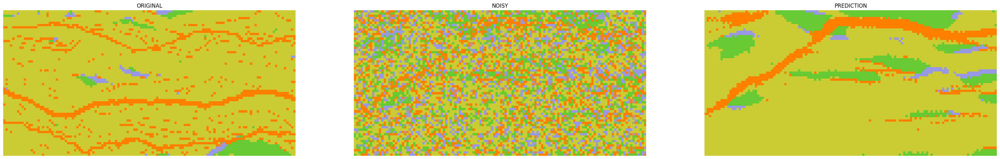

 46%|██████████████████▊                      | 229/499 [34:27<40:20,  8.97s/it]

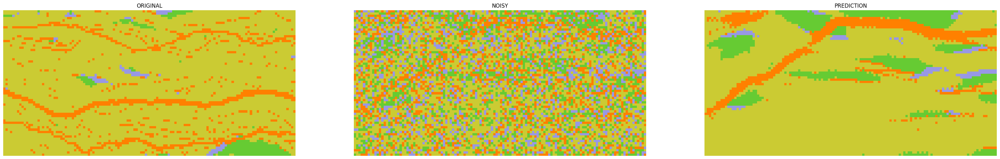

 46%|██████████████████▉                      | 230/499 [34:36<40:14,  8.98s/it]

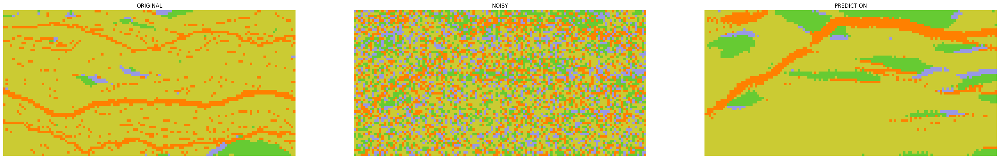

 46%|██████████████████▉                      | 231/499 [34:45<40:06,  8.98s/it]

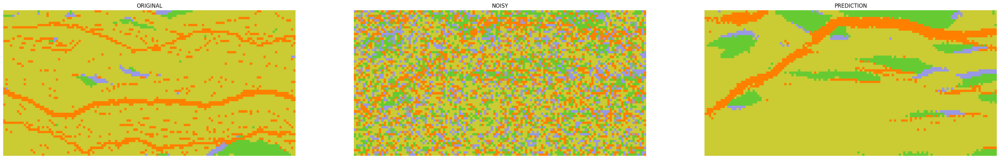

 46%|███████████████████                      | 232/499 [34:54<39:54,  8.97s/it]

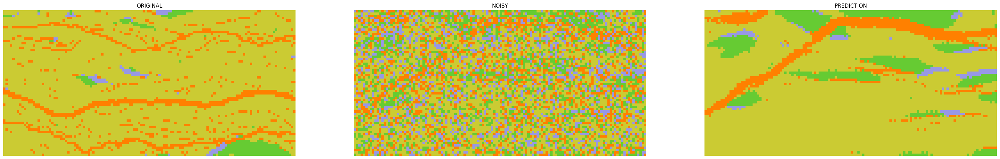

 47%|███████████████████▏                     | 233/499 [35:03<39:42,  8.96s/it]

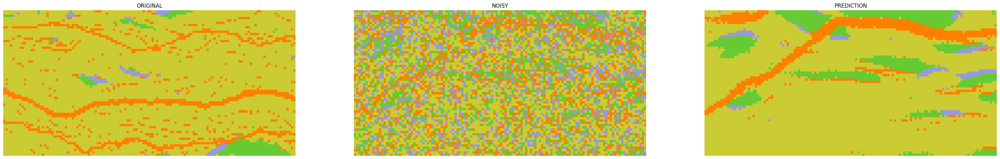

 47%|███████████████████▏                     | 234/499 [35:12<39:30,  8.94s/it]

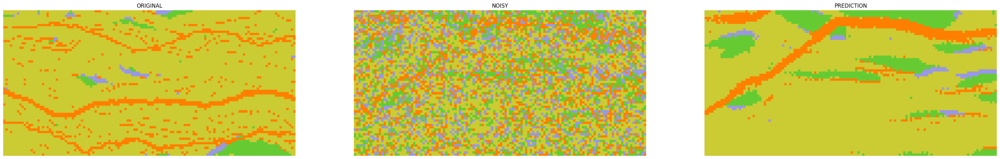

 47%|███████████████████▎                     | 235/499 [35:21<39:18,  8.93s/it]

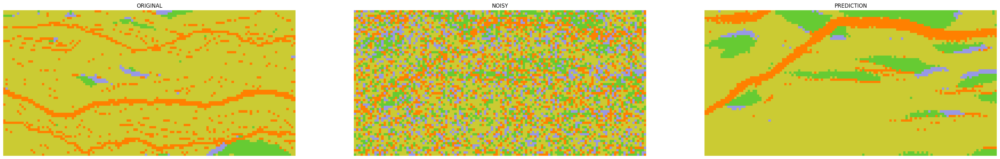

 47%|███████████████████▍                     | 236/499 [35:30<39:10,  8.94s/it]

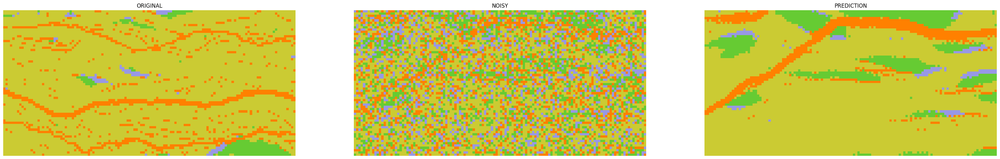

 47%|███████████████████▍                     | 237/499 [35:39<38:55,  8.91s/it]

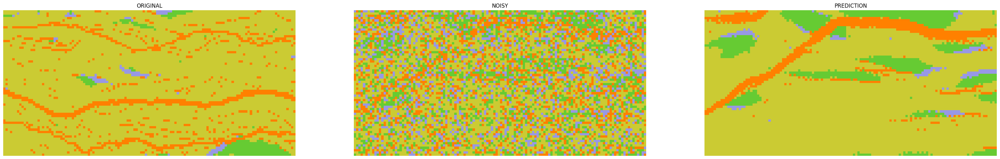

 48%|███████████████████▌                     | 238/499 [35:48<38:48,  8.92s/it]

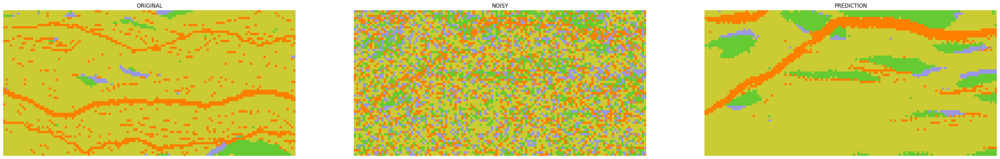

 48%|███████████████████▋                     | 239/499 [35:57<38:41,  8.93s/it]

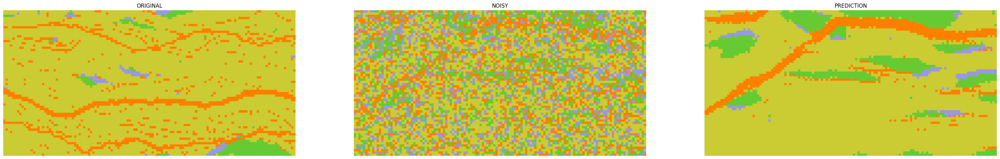

 48%|███████████████████▋                     | 240/499 [36:06<38:35,  8.94s/it]

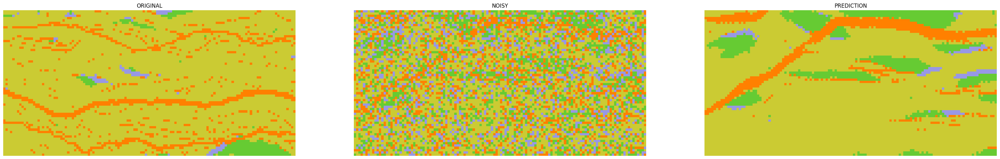

 48%|███████████████████▊                     | 241/499 [36:15<38:21,  8.92s/it]

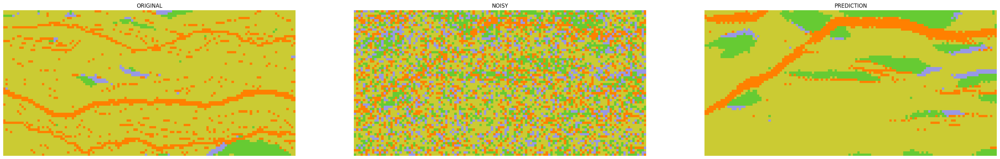

 48%|███████████████████▉                     | 242/499 [36:24<38:11,  8.92s/it]

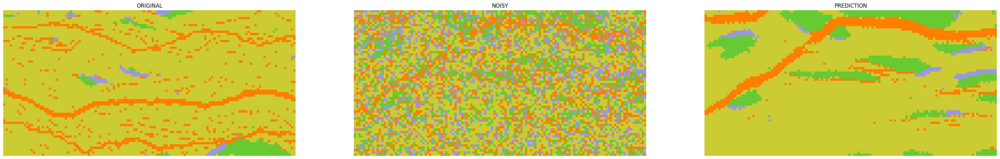

 49%|███████████████████▉                     | 243/499 [36:32<38:01,  8.91s/it]

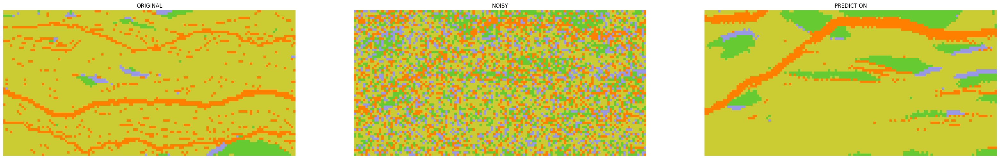

 49%|████████████████████                     | 244/499 [36:41<37:49,  8.90s/it]

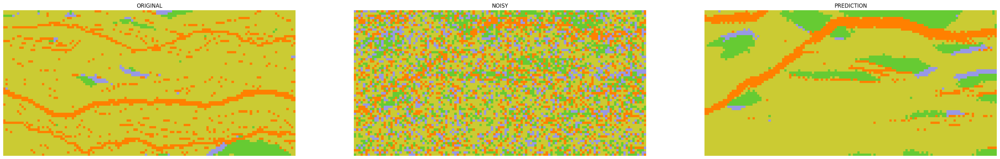

 49%|████████████████████▏                    | 245/499 [36:50<37:47,  8.93s/it]

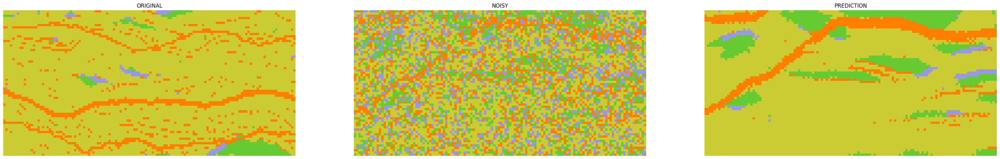

 49%|████████████████████▏                    | 246/499 [36:59<37:39,  8.93s/it]

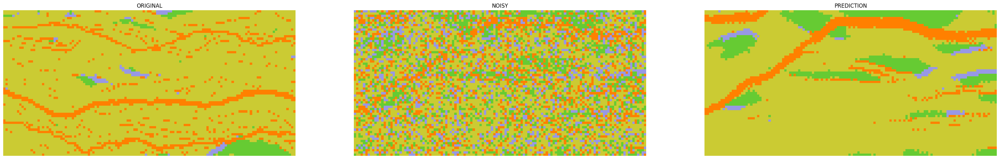

 49%|████████████████████▎                    | 247/499 [37:08<37:27,  8.92s/it]

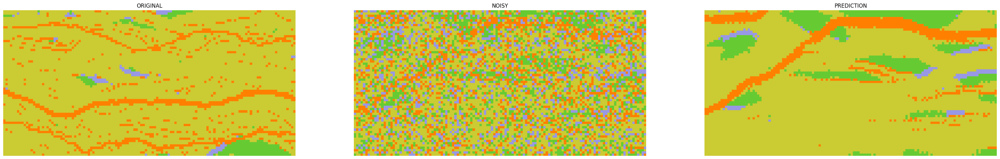

 50%|████████████████████▍                    | 248/499 [37:17<37:21,  8.93s/it]

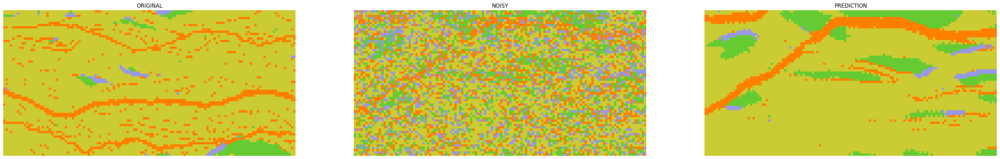

 50%|████████████████████▍                    | 249/499 [37:26<37:15,  8.94s/it]

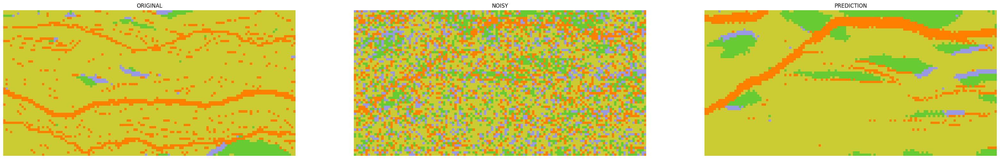

 50%|████████████████████▌                    | 250/499 [37:35<37:05,  8.94s/it]

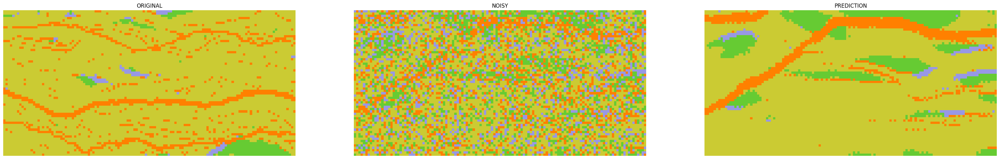

 50%|████████████████████▌                    | 251/499 [37:44<36:54,  8.93s/it]

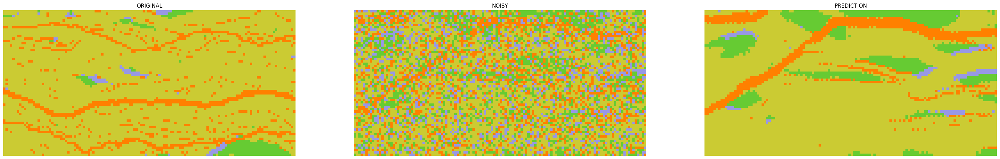

 51%|████████████████████▋                    | 252/499 [37:53<36:42,  8.92s/it]

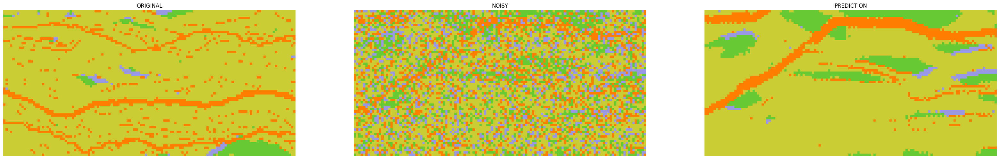

 51%|████████████████████▊                    | 253/499 [38:02<36:34,  8.92s/it]

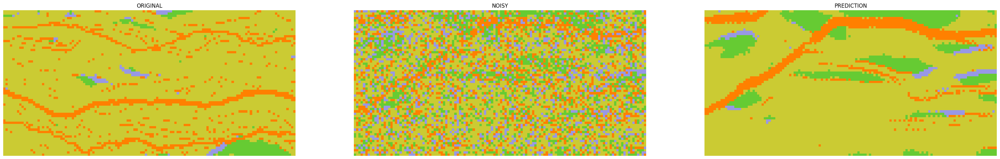

 51%|████████████████████▊                    | 254/499 [38:11<36:25,  8.92s/it]

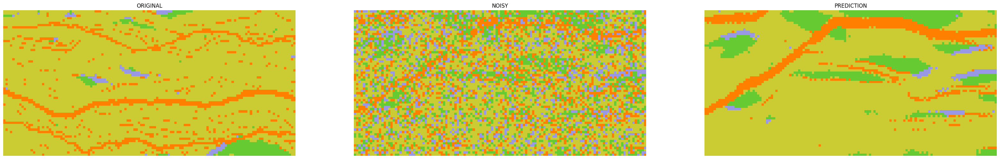

 51%|████████████████████▉                    | 255/499 [38:20<36:13,  8.91s/it]

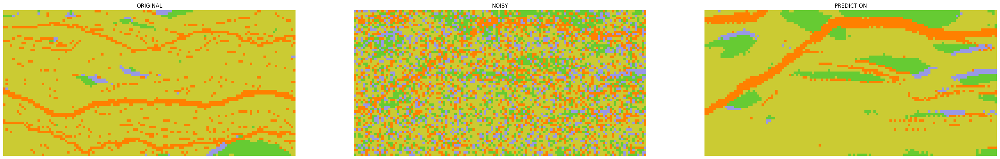

 51%|█████████████████████                    | 256/499 [38:28<36:01,  8.89s/it]

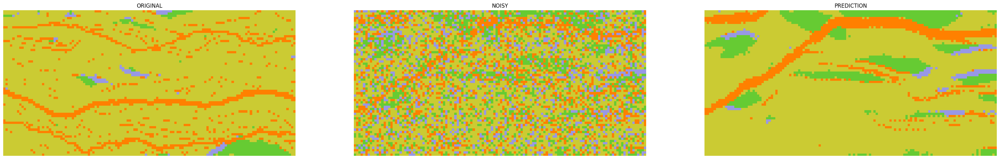

 52%|█████████████████████                    | 257/499 [38:37<35:53,  8.90s/it]

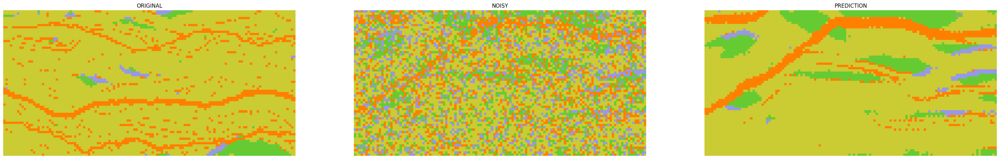

 52%|█████████████████████▏                   | 258/499 [38:46<35:43,  8.89s/it]

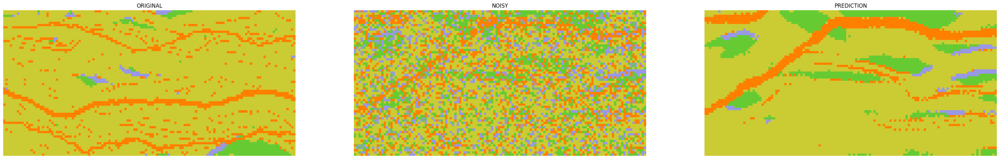

 52%|█████████████████████▎                   | 259/499 [38:55<35:32,  8.88s/it]

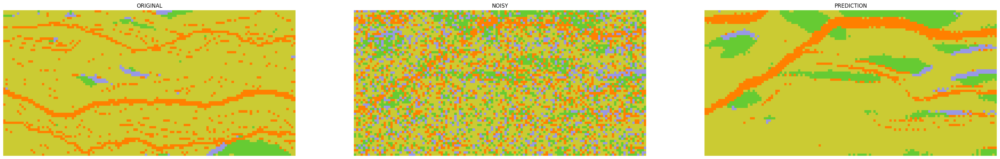

 52%|█████████████████████▎                   | 260/499 [39:04<35:26,  8.90s/it]

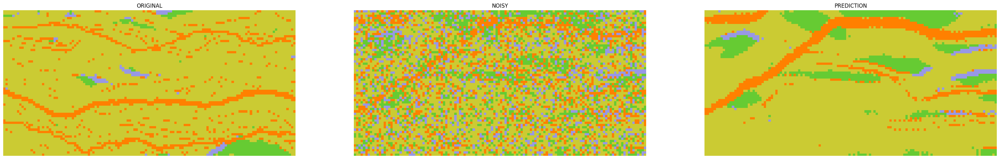

 52%|█████████████████████▍                   | 261/499 [39:13<35:15,  8.89s/it]

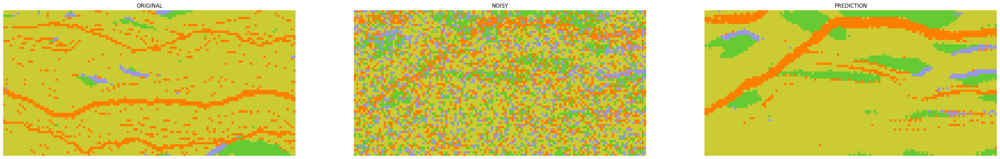

 53%|█████████████████████▌                   | 262/499 [39:22<35:11,  8.91s/it]

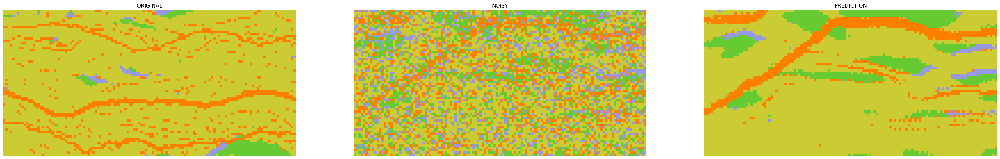

 53%|█████████████████████▌                   | 263/499 [39:32<36:21,  9.24s/it]

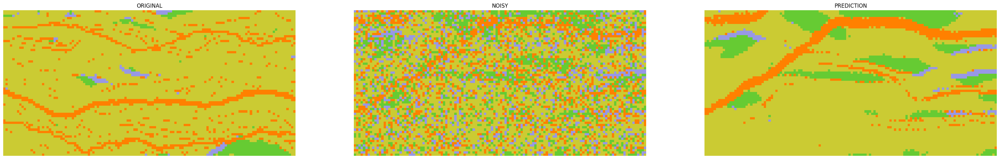

 53%|█████████████████████▋                   | 264/499 [39:41<35:50,  9.15s/it]

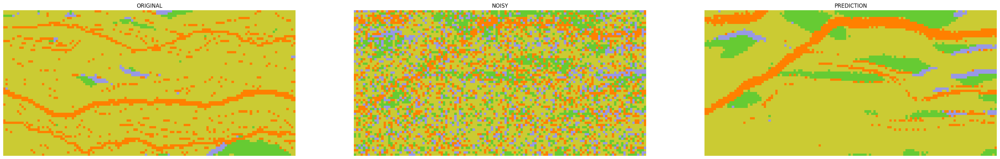

 53%|█████████████████████▊                   | 265/499 [39:50<35:22,  9.07s/it]

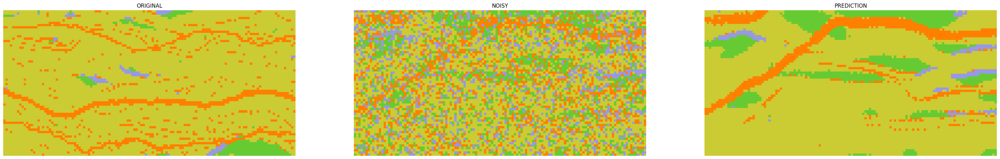

 53%|█████████████████████▊                   | 266/499 [39:59<35:05,  9.03s/it]

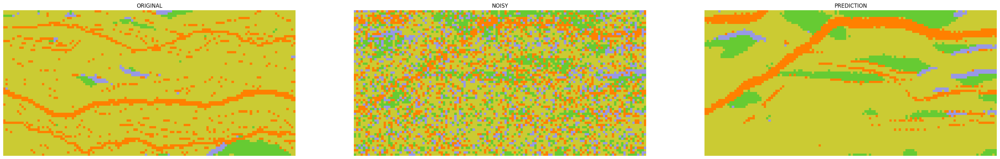

 54%|█████████████████████▉                   | 267/499 [40:08<34:53,  9.02s/it]

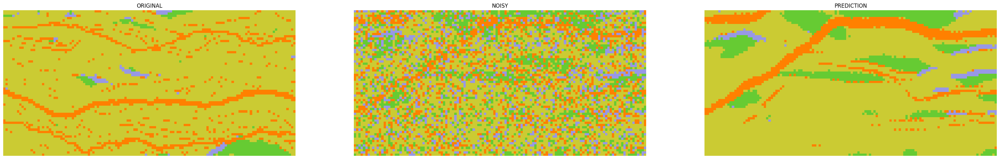

 54%|██████████████████████                   | 268/499 [40:16<34:34,  8.98s/it]

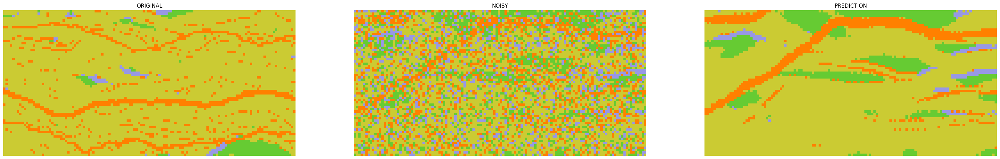

 54%|██████████████████████                   | 269/499 [40:25<34:20,  8.96s/it]

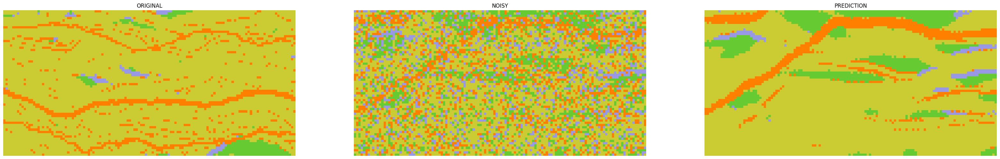

 54%|██████████████████████▏                  | 270/499 [40:34<34:12,  8.96s/it]

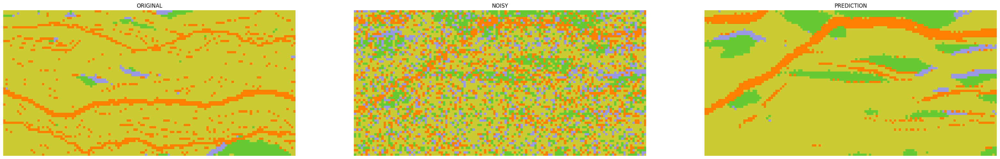

 54%|██████████████████████▎                  | 271/499 [40:43<34:00,  8.95s/it]

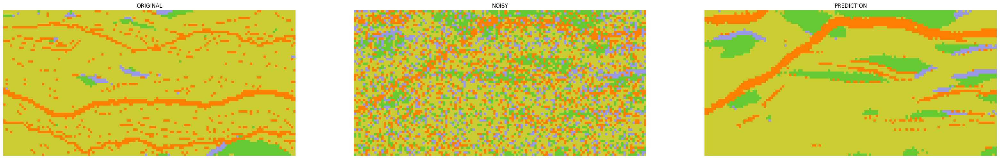

 55%|██████████████████████▎                  | 272/499 [40:52<33:48,  8.94s/it]

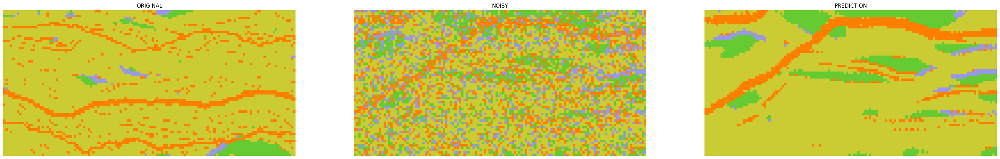

 55%|██████████████████████▍                  | 273/499 [41:01<33:42,  8.95s/it]

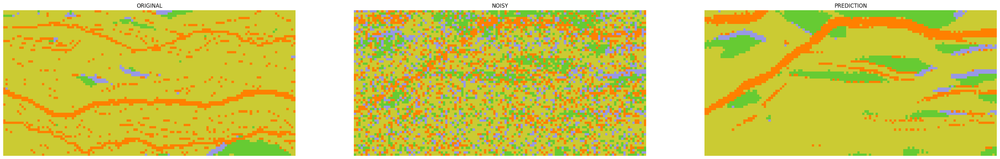

 55%|██████████████████████▌                  | 274/499 [41:10<33:31,  8.94s/it]

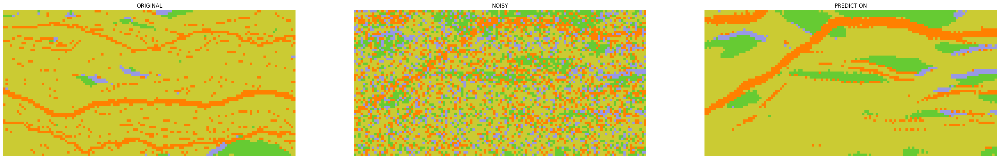

 55%|██████████████████████▌                  | 275/499 [41:19<33:20,  8.93s/it]

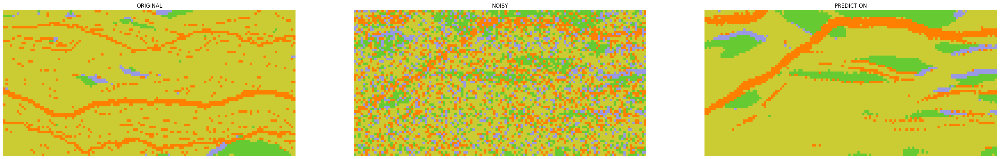

 55%|██████████████████████▋                  | 276/499 [41:28<33:13,  8.94s/it]

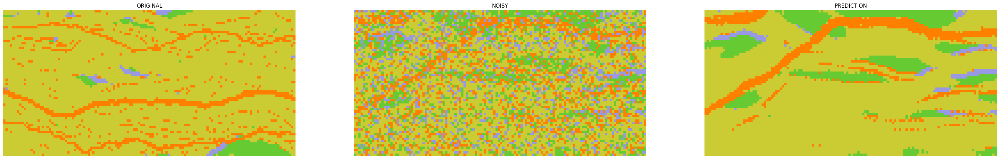

 56%|██████████████████████▊                  | 277/499 [41:37<33:00,  8.92s/it]

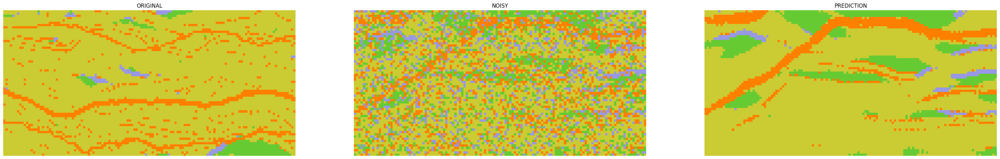

 56%|██████████████████████▊                  | 278/499 [41:46<32:52,  8.93s/it]

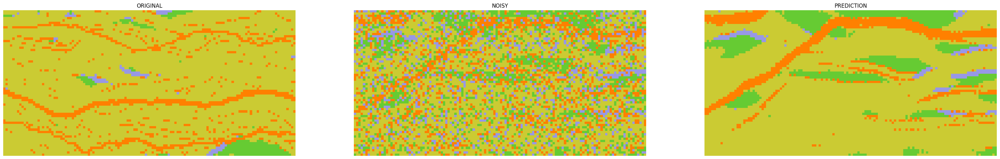

 56%|██████████████████████▉                  | 279/499 [41:55<32:37,  8.90s/it]

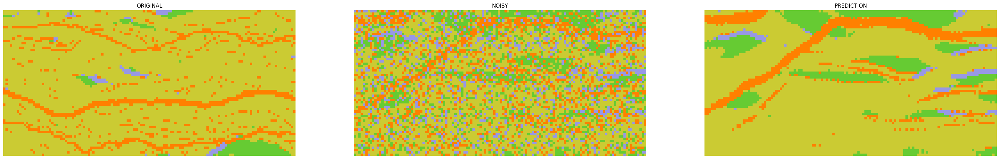

 56%|███████████████████████                  | 280/499 [42:04<32:31,  8.91s/it]

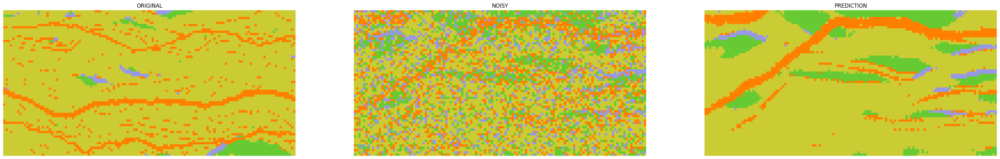

 56%|███████████████████████                  | 281/499 [42:12<32:23,  8.91s/it]

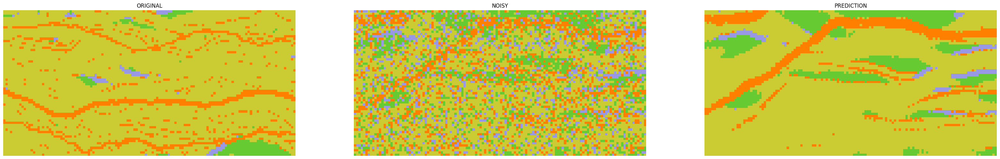

 57%|███████████████████████▏                 | 282/499 [42:21<32:13,  8.91s/it]

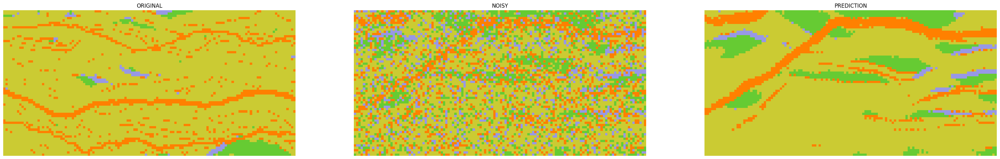

 57%|███████████████████████▎                 | 283/499 [42:30<32:03,  8.90s/it]

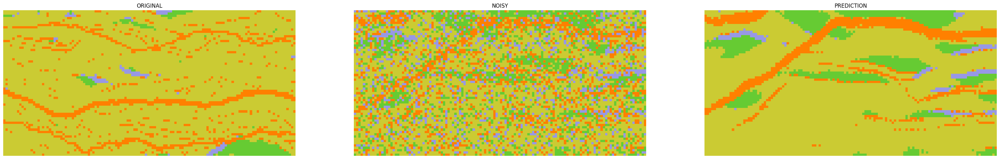

 57%|███████████████████████▎                 | 284/499 [42:39<31:54,  8.91s/it]

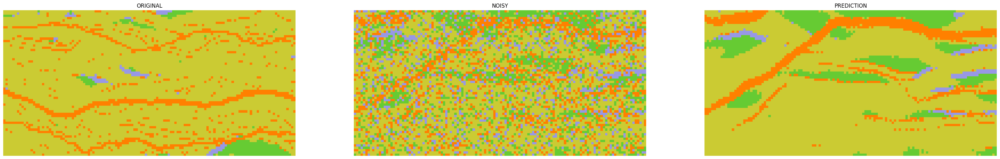

 57%|███████████████████████▍                 | 285/499 [42:48<31:46,  8.91s/it]

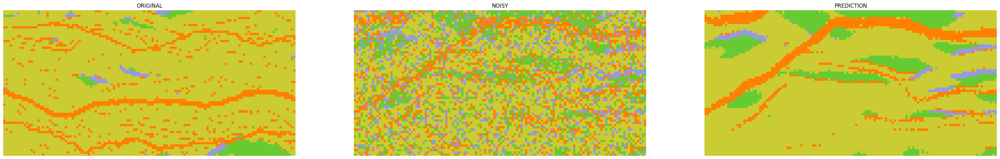

 57%|███████████████████████▍                 | 286/499 [42:57<31:41,  8.93s/it]

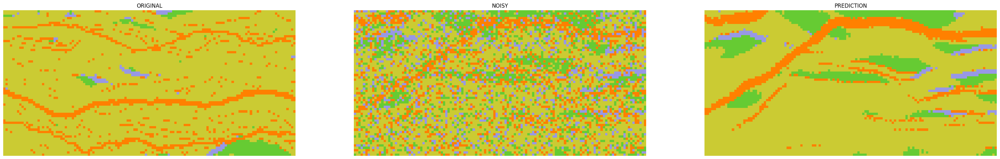

 58%|███████████████████████▌                 | 287/499 [43:06<31:33,  8.93s/it]

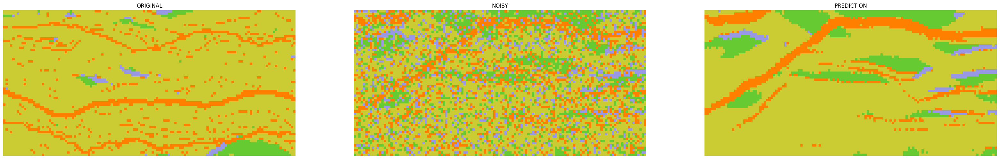

 58%|███████████████████████▋                 | 288/499 [43:15<31:21,  8.92s/it]

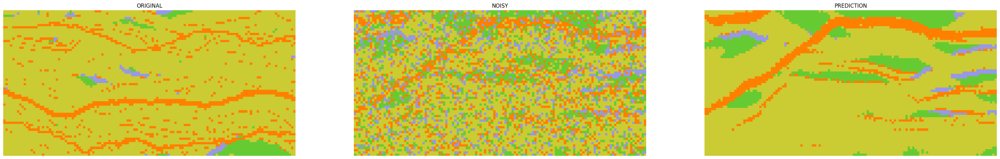

 58%|███████████████████████▋                 | 289/499 [43:24<31:14,  8.92s/it]

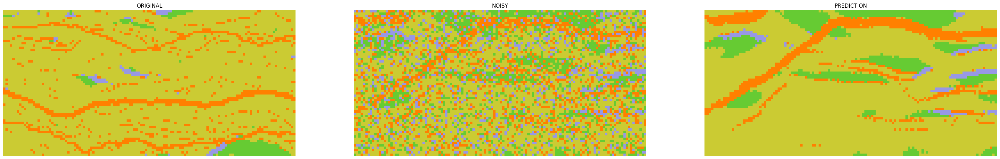

 58%|███████████████████████▊                 | 290/499 [43:33<31:04,  8.92s/it]

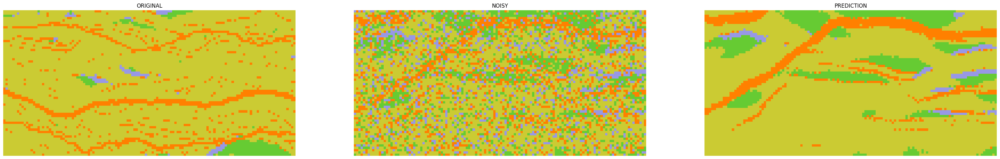

 58%|███████████████████████▉                 | 291/499 [43:42<30:54,  8.92s/it]

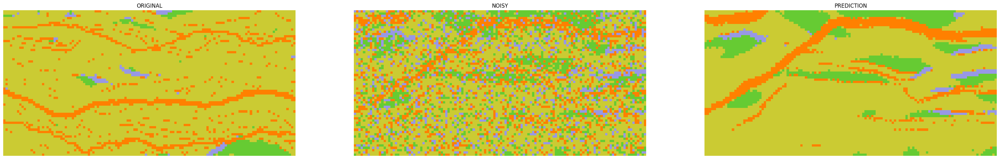

 59%|███████████████████████▉                 | 292/499 [43:51<30:48,  8.93s/it]

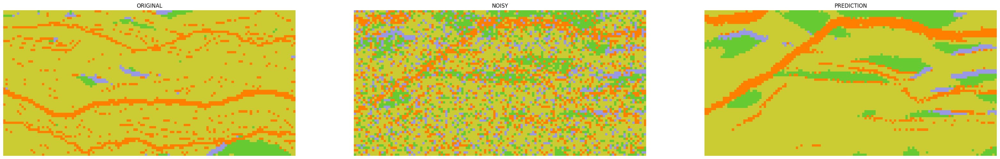

 59%|████████████████████████                 | 293/499 [44:00<30:41,  8.94s/it]

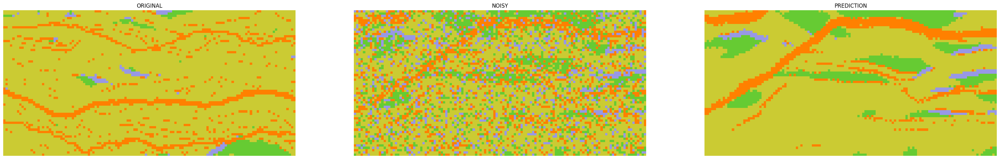

 59%|████████████████████████▏                | 294/499 [44:08<30:32,  8.94s/it]

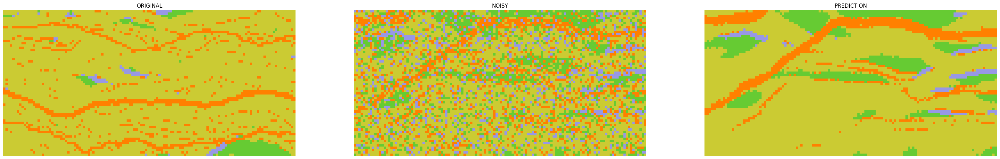

 59%|████████████████████████▏                | 295/499 [44:17<30:25,  8.95s/it]

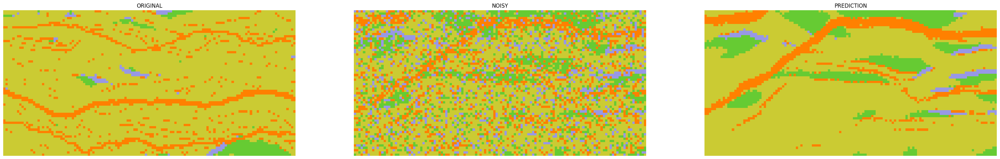

 59%|████████████████████████▎                | 296/499 [44:26<30:14,  8.94s/it]

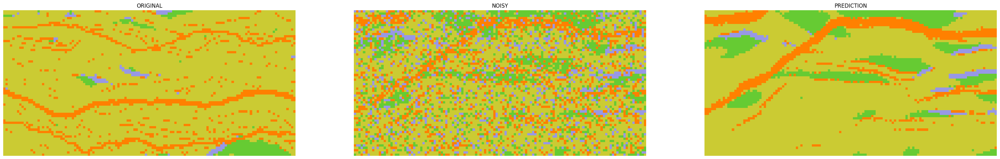

 60%|████████████████████████▍                | 297/499 [44:35<30:06,  8.94s/it]

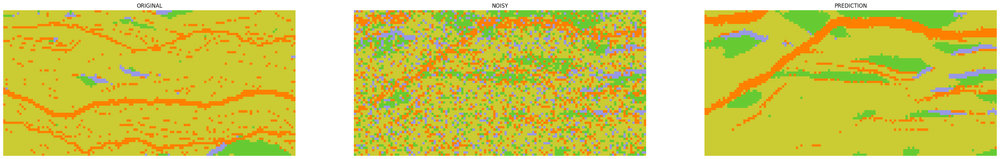

 60%|████████████████████████▍                | 298/499 [44:44<29:57,  8.94s/it]

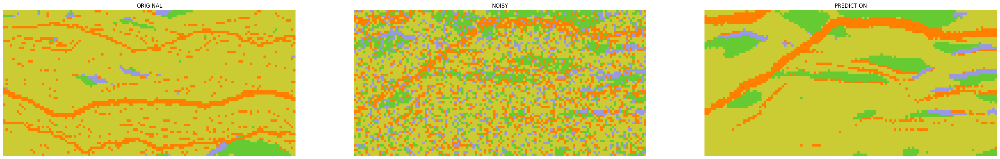

 60%|████████████████████████▌                | 299/499 [44:53<29:49,  8.95s/it]

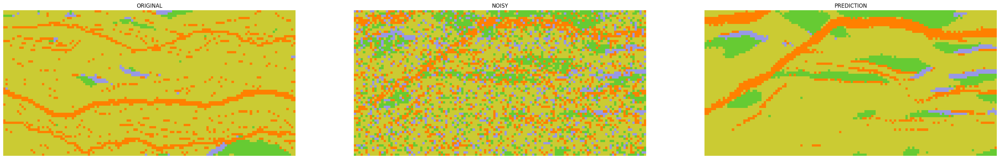

 60%|████████████████████████▋                | 300/499 [45:02<29:38,  8.94s/it]

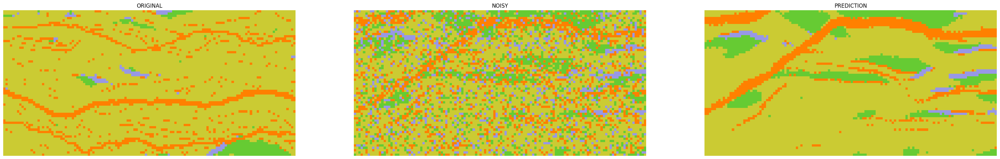

 60%|████████████████████████▋                | 301/499 [45:11<29:24,  8.91s/it]

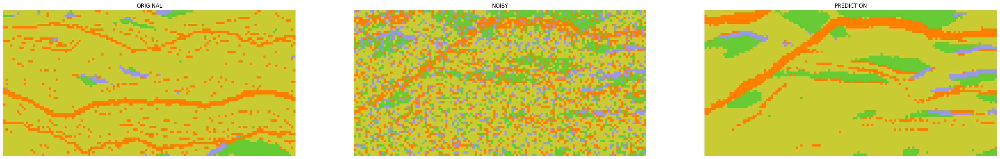

 61%|████████████████████████▊                | 302/499 [45:20<29:14,  8.90s/it]

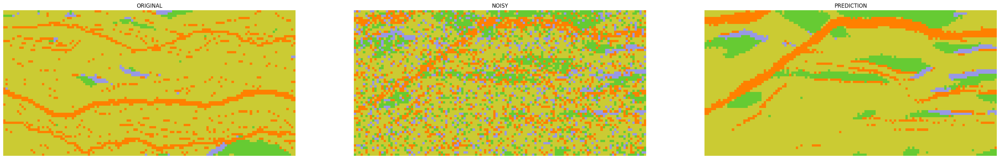

 61%|████████████████████████▉                | 303/499 [45:29<29:04,  8.90s/it]

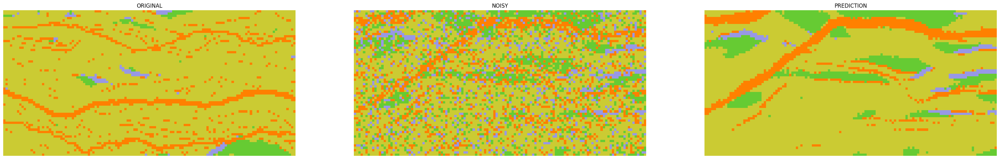

 61%|████████████████████████▉                | 304/499 [45:39<30:02,  9.24s/it]

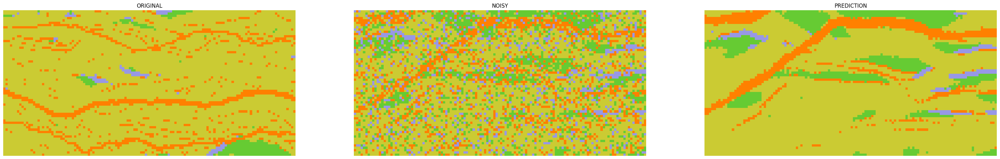

 61%|█████████████████████████                | 305/499 [45:48<29:32,  9.14s/it]

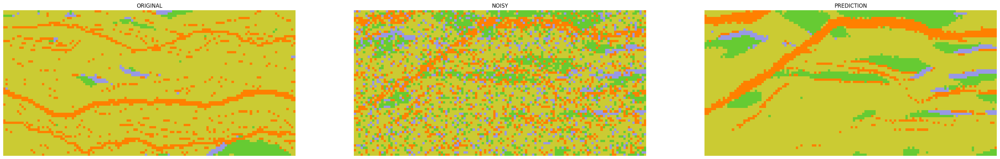

 61%|█████████████████████████▏               | 306/499 [45:57<29:06,  9.05s/it]

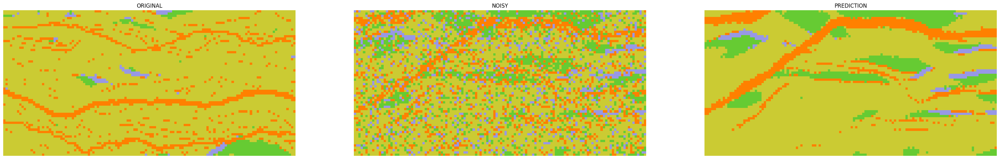

 62%|█████████████████████████▏               | 307/499 [46:06<28:52,  9.02s/it]

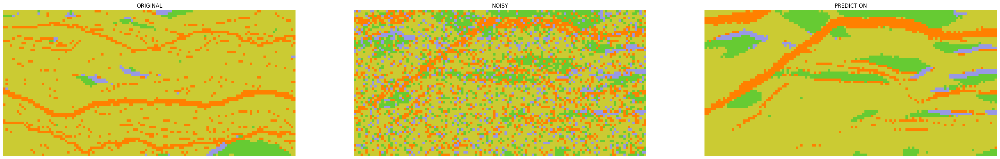

 62%|█████████████████████████▎               | 308/499 [46:14<28:39,  9.00s/it]

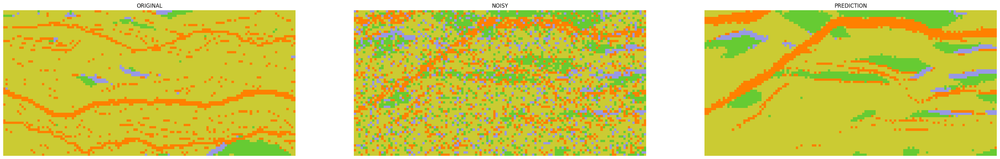

 62%|█████████████████████████▍               | 309/499 [46:23<28:27,  8.99s/it]

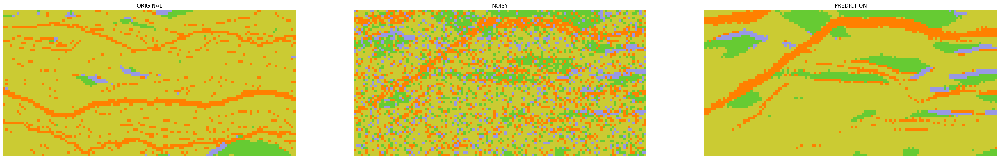

 62%|█████████████████████████▍               | 310/499 [46:32<28:15,  8.97s/it]

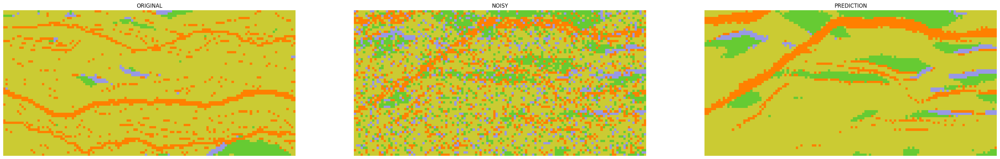

 62%|█████████████████████████▌               | 311/499 [46:41<28:05,  8.97s/it]

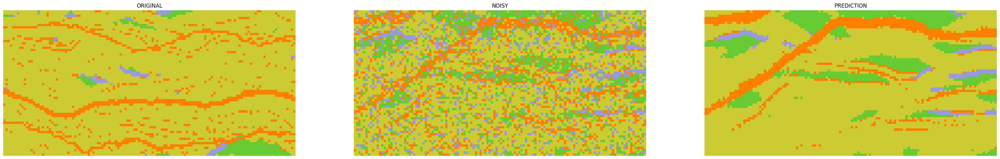

 63%|█████████████████████████▋               | 312/499 [46:50<27:54,  8.95s/it]

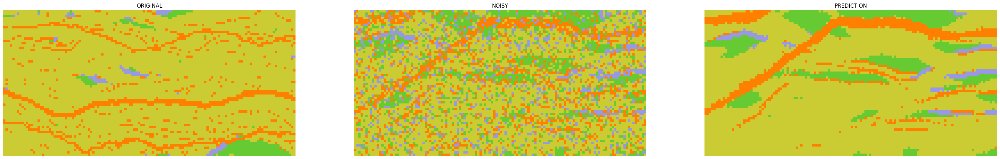

 63%|█████████████████████████▋               | 313/499 [46:59<27:43,  8.95s/it]

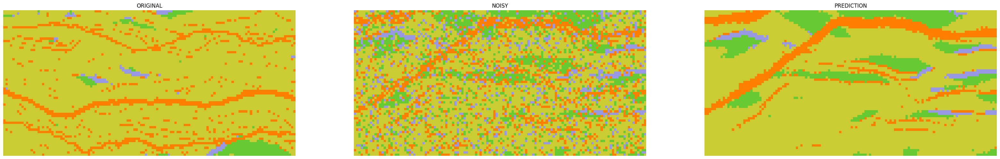

 63%|█████████████████████████▊               | 314/499 [47:08<27:30,  8.92s/it]

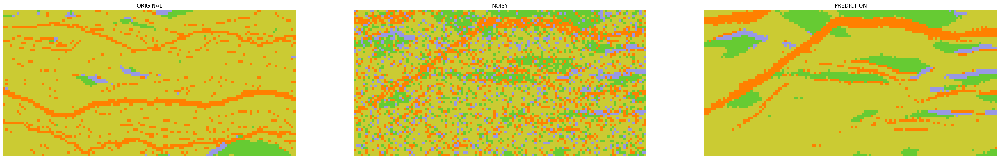

 63%|█████████████████████████▉               | 315/499 [47:17<27:23,  8.93s/it]

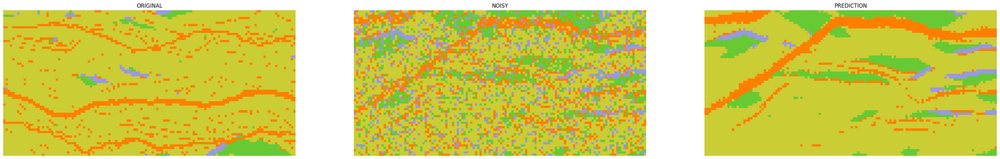

 63%|█████████████████████████▉               | 316/499 [47:26<27:12,  8.92s/it]

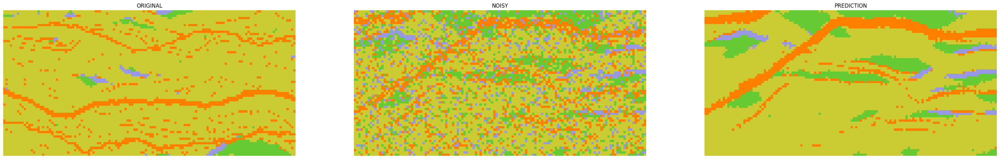

 64%|██████████████████████████               | 317/499 [47:35<27:06,  8.93s/it]

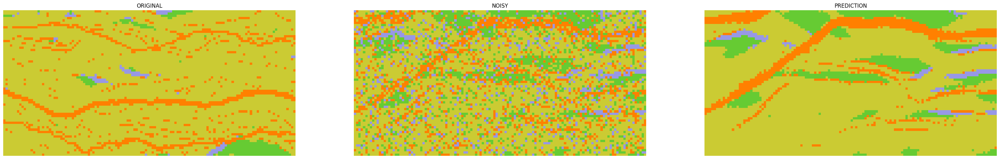

 64%|██████████████████████████▏              | 318/499 [47:44<26:58,  8.94s/it]

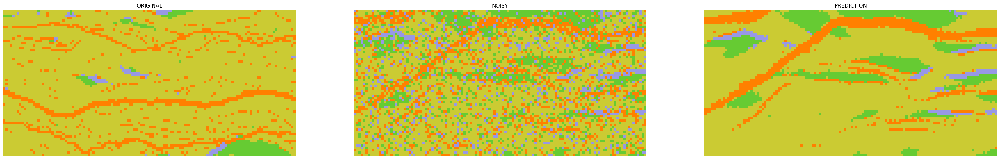

 64%|██████████████████████████▏              | 319/499 [47:53<26:47,  8.93s/it]

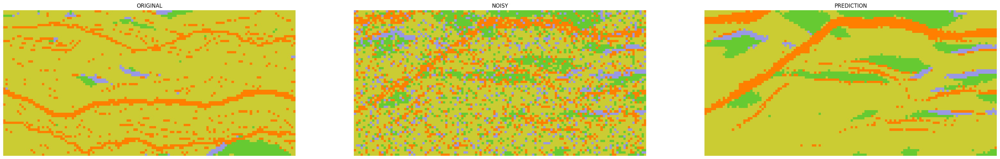

 64%|██████████████████████████▎              | 320/499 [48:02<26:37,  8.93s/it]

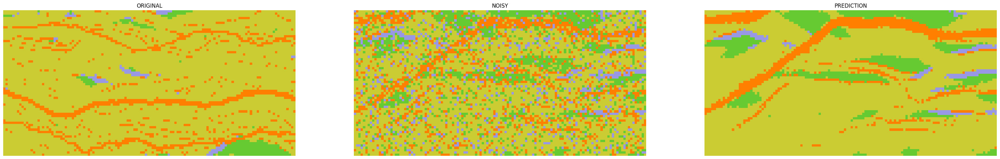

 64%|██████████████████████████▎              | 321/499 [48:11<26:31,  8.94s/it]

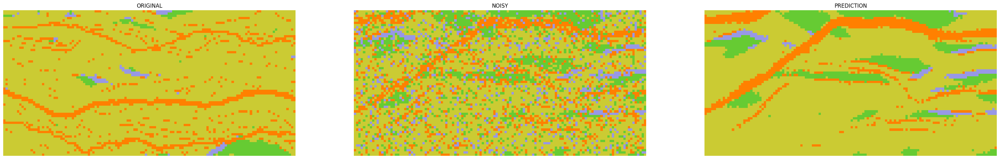

 65%|██████████████████████████▍              | 322/499 [48:19<26:18,  8.92s/it]

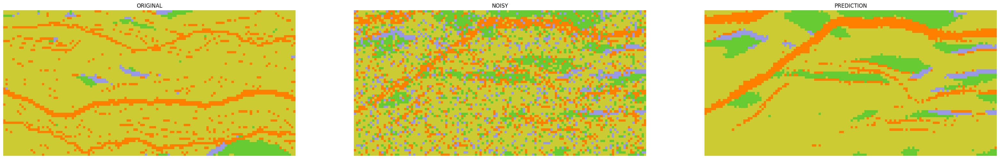

 65%|██████████████████████████▌              | 323/499 [48:28<26:13,  8.94s/it]

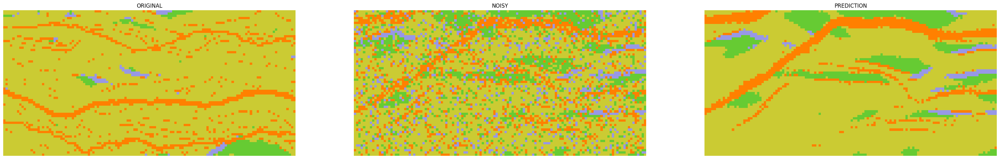

 65%|██████████████████████████▌              | 324/499 [48:37<26:00,  8.92s/it]

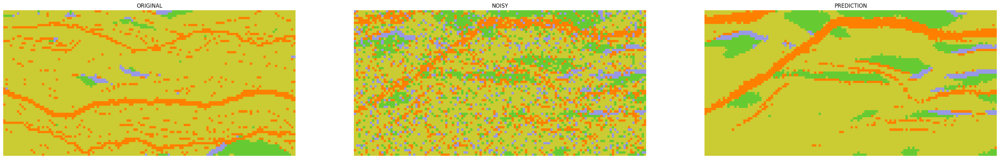

 65%|██████████████████████████▋              | 325/499 [48:46<25:52,  8.92s/it]

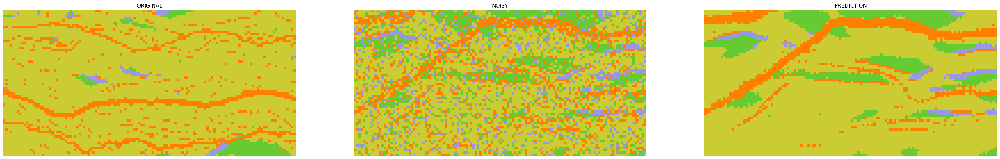

 65%|██████████████████████████▊              | 326/499 [48:55<25:42,  8.92s/it]

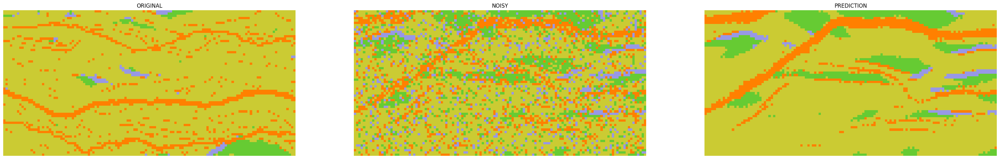

 66%|██████████████████████████▊              | 327/499 [49:04<25:33,  8.92s/it]

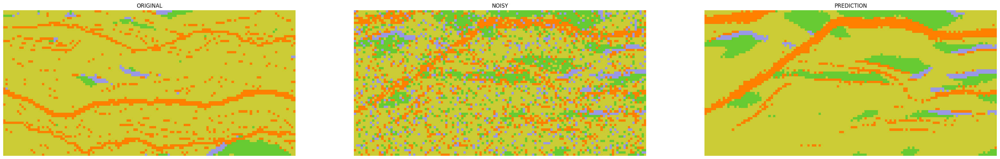

 66%|██████████████████████████▉              | 328/499 [49:13<25:24,  8.91s/it]

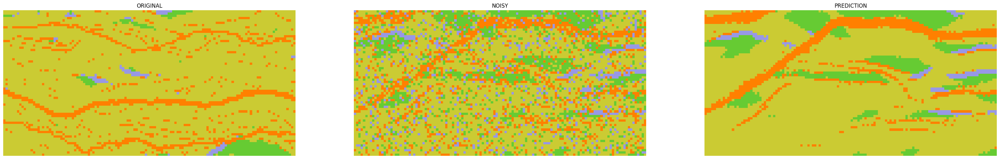

 66%|███████████████████████████              | 329/499 [49:22<25:16,  8.92s/it]

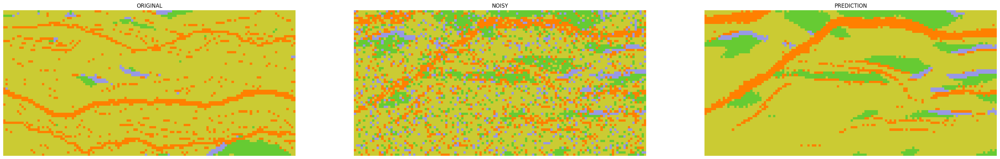

 66%|███████████████████████████              | 330/499 [49:31<25:08,  8.93s/it]

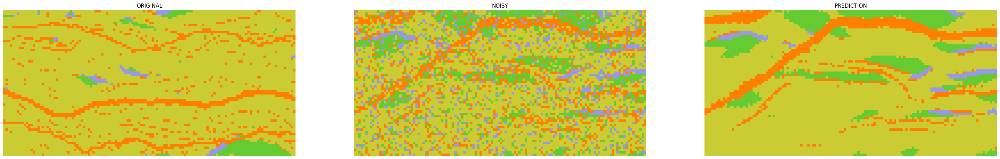

 66%|███████████████████████████▏             | 331/499 [49:40<24:59,  8.93s/it]

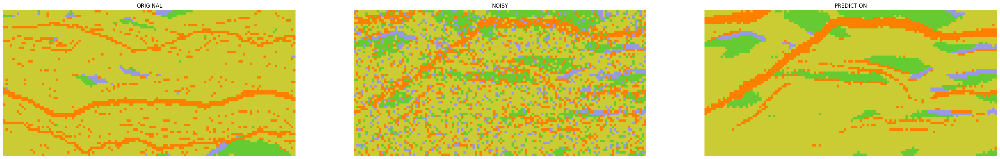

 67%|███████████████████████████▎             | 332/499 [49:49<24:48,  8.91s/it]

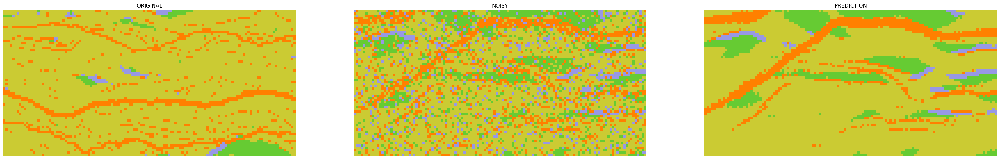

 67%|███████████████████████████▎             | 333/499 [49:57<24:35,  8.89s/it]

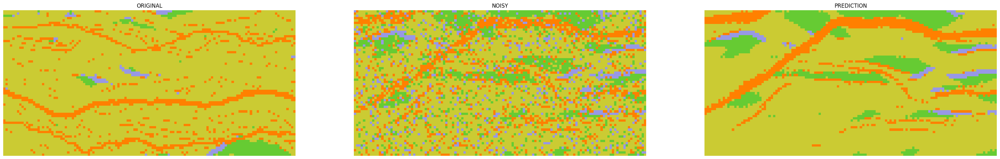

 67%|███████████████████████████▍             | 334/499 [50:06<24:27,  8.89s/it]

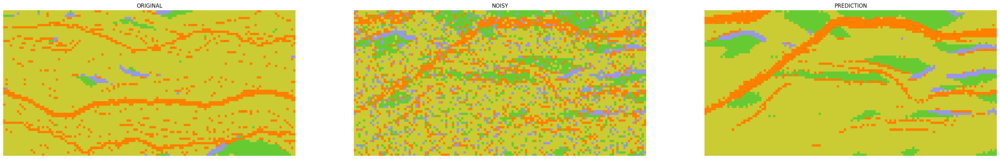

 67%|███████████████████████████▌             | 335/499 [50:15<24:21,  8.91s/it]

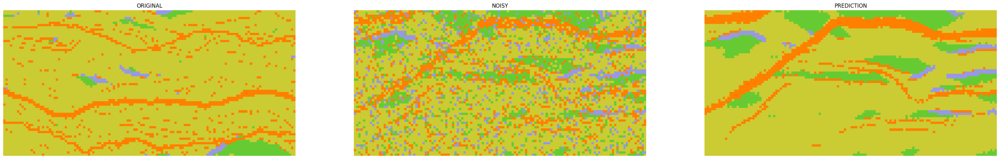

 67%|███████████████████████████▌             | 336/499 [50:24<24:14,  8.92s/it]

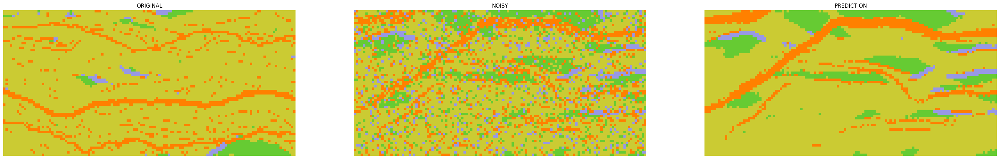

 68%|███████████████████████████▋             | 337/499 [50:33<24:08,  8.94s/it]

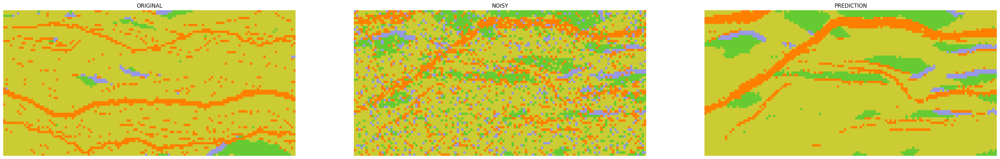

 68%|███████████████████████████▊             | 338/499 [50:42<23:59,  8.94s/it]

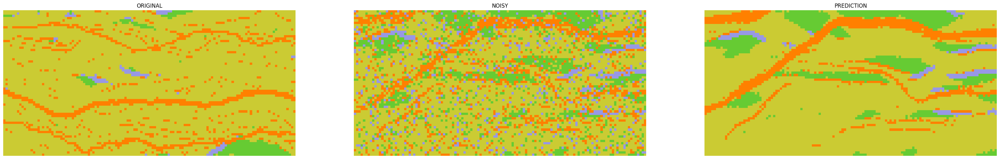

 68%|███████████████████████████▊             | 339/499 [50:51<23:50,  8.94s/it]

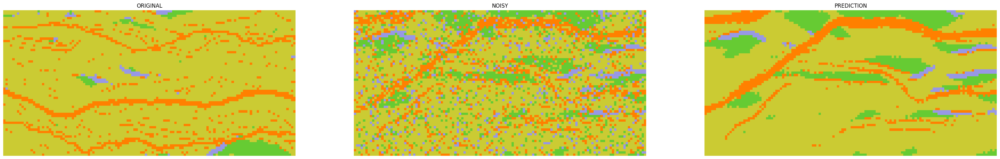

 68%|███████████████████████████▉             | 340/499 [51:00<23:41,  8.94s/it]

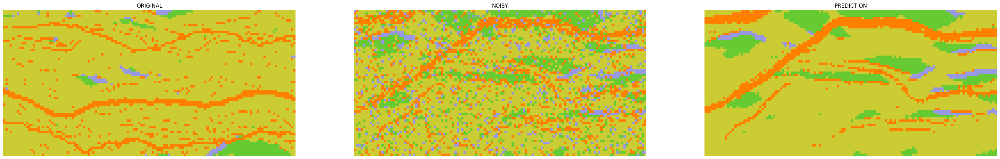

 68%|████████████████████████████             | 341/499 [51:09<23:33,  8.95s/it]

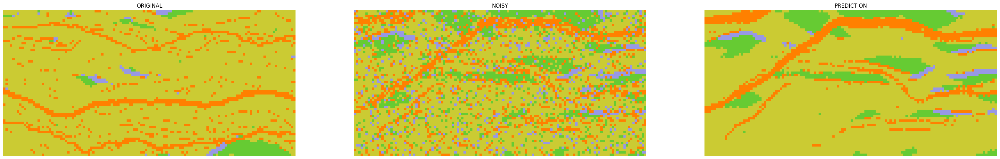

 69%|████████████████████████████             | 342/499 [51:18<23:22,  8.93s/it]

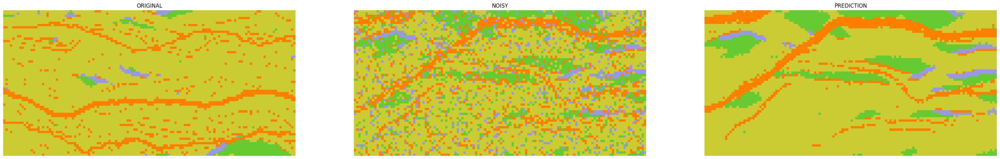

 69%|████████████████████████████▏            | 343/499 [51:27<23:09,  8.91s/it]

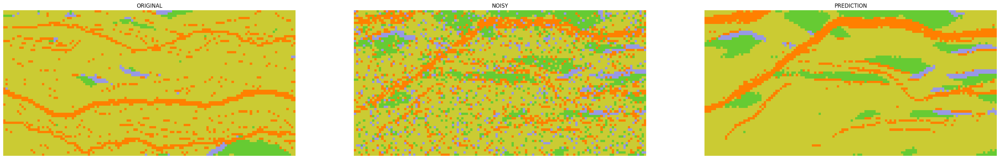

 69%|████████████████████████████▎            | 344/499 [51:36<23:01,  8.92s/it]

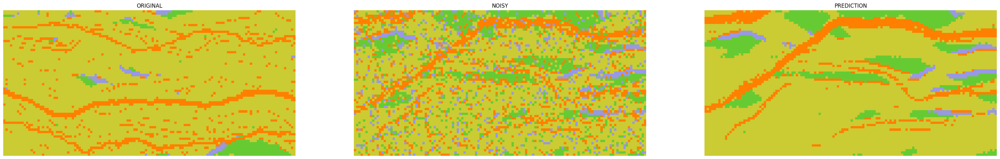

 69%|████████████████████████████▎            | 345/499 [51:46<23:46,  9.26s/it]

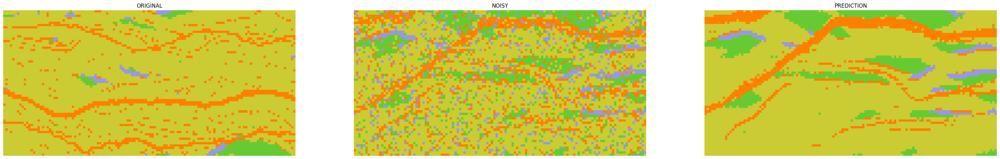

 69%|████████████████████████████▍            | 346/499 [51:55<23:19,  9.15s/it]

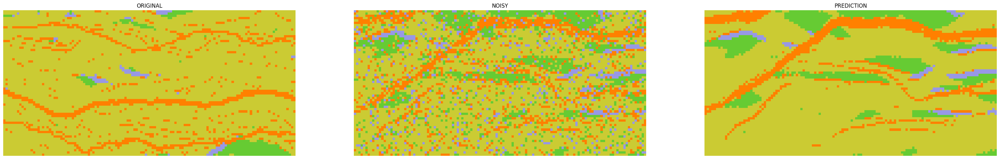

 70%|████████████████████████████▌            | 347/499 [52:04<23:01,  9.09s/it]

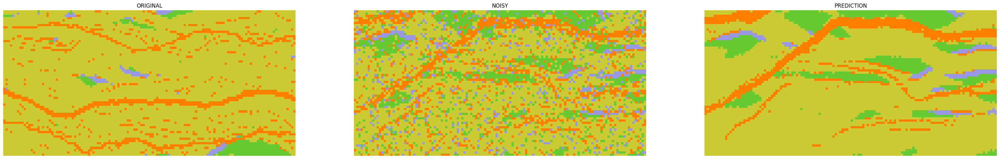

 70%|████████████████████████████▌            | 348/499 [52:13<22:44,  9.04s/it]

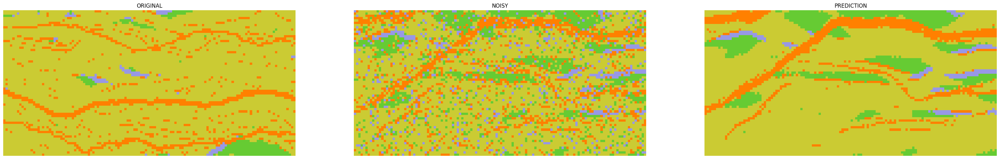

 70%|████████████████████████████▋            | 349/499 [52:22<22:32,  9.02s/it]

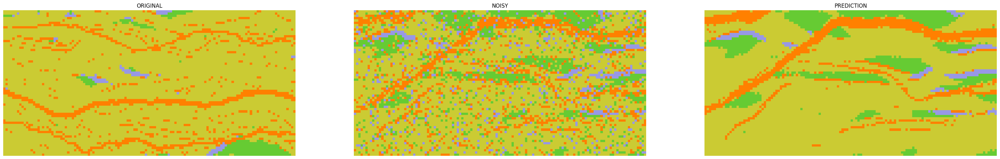

 70%|████████████████████████████▊            | 350/499 [52:30<22:19,  8.99s/it]

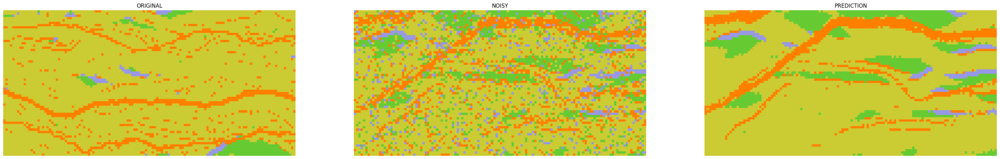

 70%|████████████████████████████▊            | 351/499 [52:39<22:08,  8.98s/it]

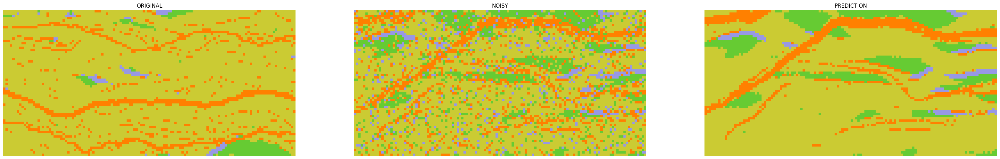

 71%|████████████████████████████▉            | 352/499 [52:48<21:59,  8.98s/it]

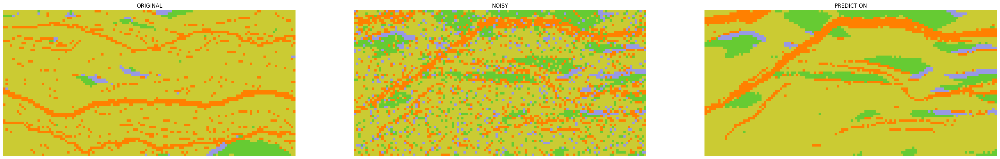

 71%|█████████████████████████████            | 353/499 [52:57<21:48,  8.96s/it]

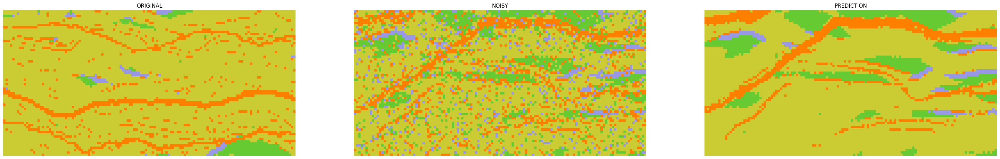

 71%|█████████████████████████████            | 354/499 [53:06<21:40,  8.97s/it]

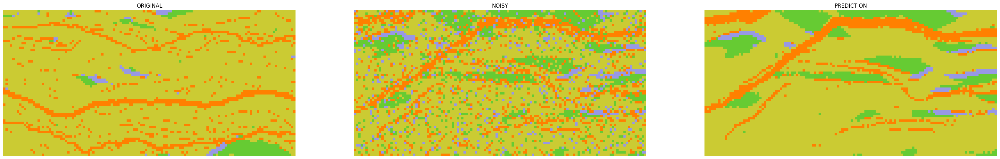

 71%|█████████████████████████████▏           | 355/499 [53:15<21:28,  8.95s/it]

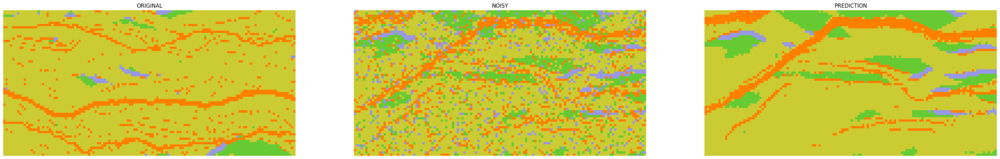

 71%|█████████████████████████████▎           | 356/499 [53:24<21:21,  8.96s/it]

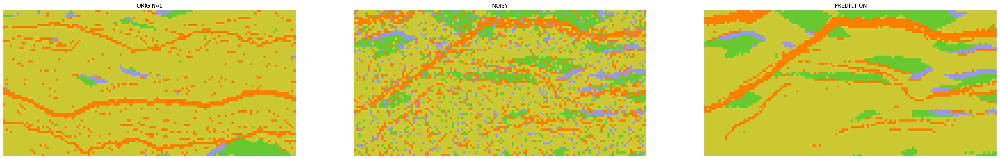

 72%|█████████████████████████████▎           | 357/499 [53:33<21:13,  8.97s/it]

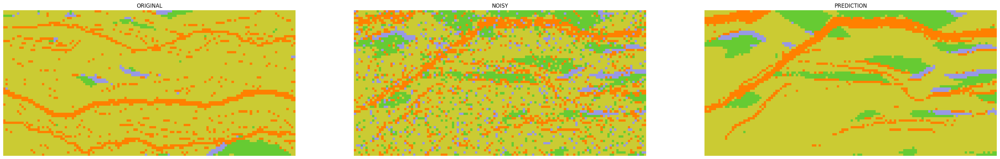

 72%|█████████████████████████████▍           | 358/499 [53:42<21:02,  8.96s/it]

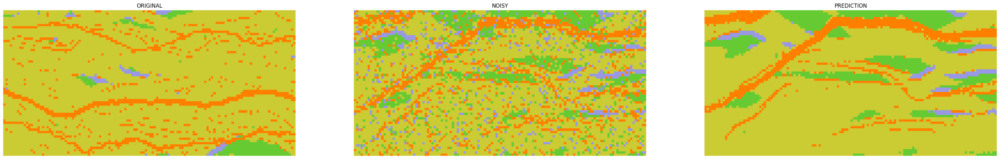

 72%|█████████████████████████████▍           | 359/499 [53:51<20:49,  8.93s/it]

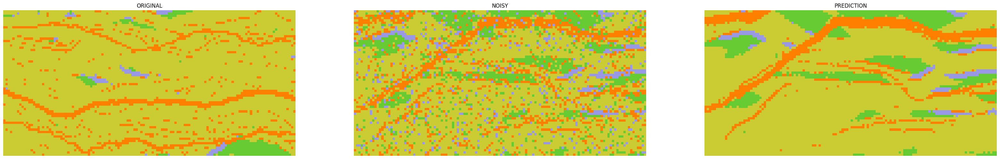

 72%|█████████████████████████████▌           | 360/499 [54:00<20:39,  8.92s/it]

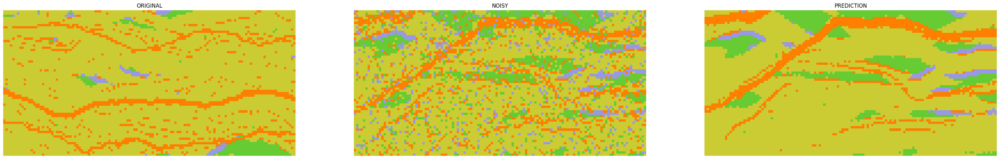

 72%|█████████████████████████████▋           | 361/499 [54:09<20:33,  8.94s/it]

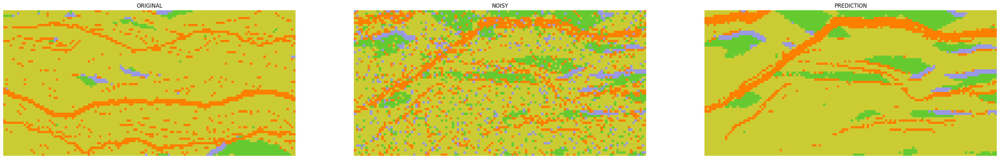

 73%|█████████████████████████████▋           | 362/499 [54:18<20:23,  8.93s/it]

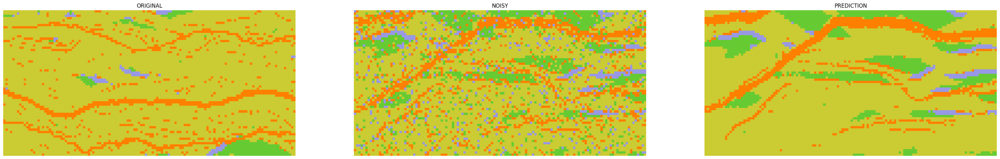

 73%|█████████████████████████████▊           | 363/499 [54:27<20:14,  8.93s/it]

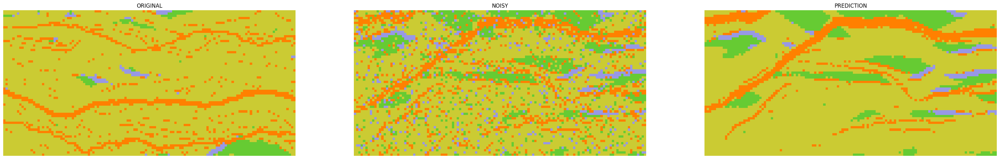

 73%|█████████████████████████████▉           | 364/499 [54:36<20:05,  8.93s/it]

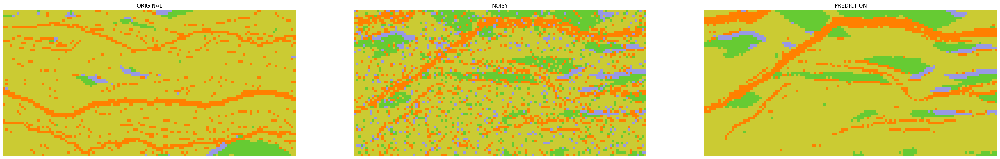

 73%|█████████████████████████████▉           | 365/499 [54:45<19:58,  8.94s/it]

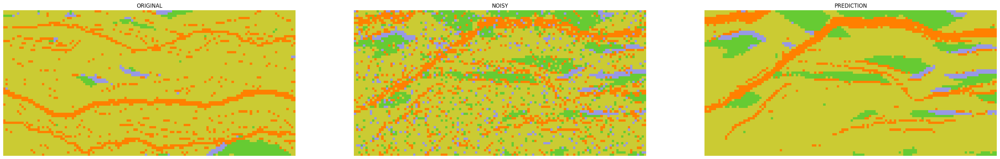

 73%|██████████████████████████████           | 366/499 [54:53<19:48,  8.94s/it]

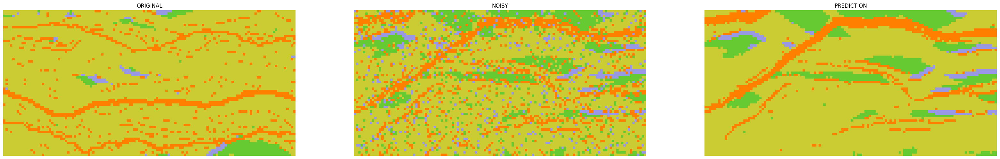

 74%|██████████████████████████████▏          | 367/499 [55:02<19:39,  8.93s/it]

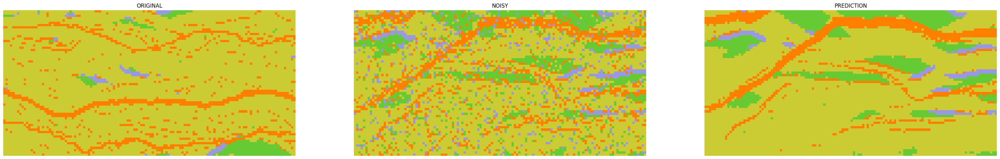

 74%|██████████████████████████████▏          | 368/499 [55:11<19:30,  8.94s/it]

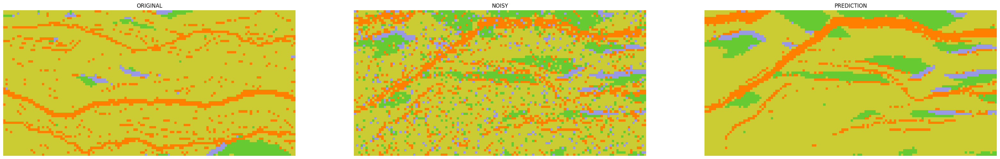

 74%|██████████████████████████████▎          | 369/499 [55:20<19:20,  8.93s/it]

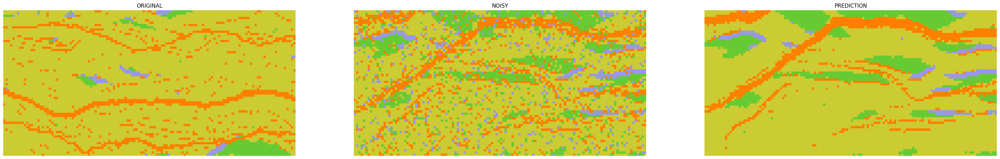

 74%|██████████████████████████████▍          | 370/499 [55:29<19:10,  8.92s/it]

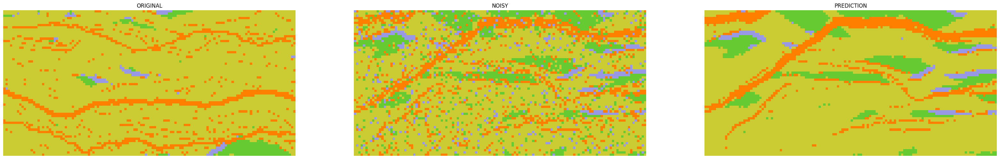

 74%|██████████████████████████████▍          | 371/499 [55:38<19:00,  8.91s/it]

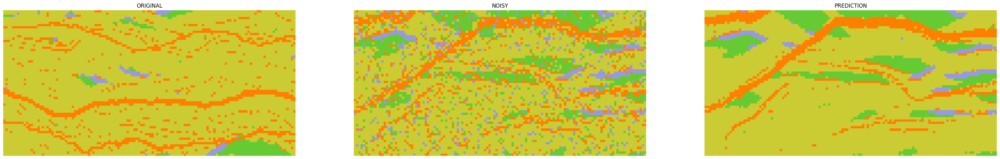

 75%|██████████████████████████████▌          | 372/499 [55:47<18:52,  8.92s/it]

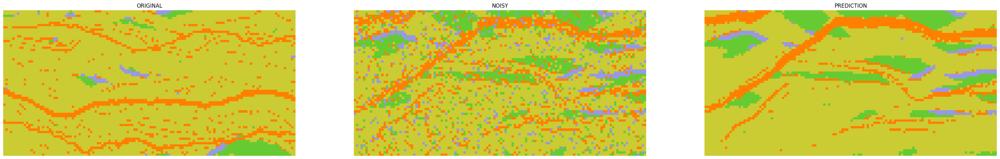

 75%|██████████████████████████████▋          | 373/499 [55:56<18:40,  8.90s/it]

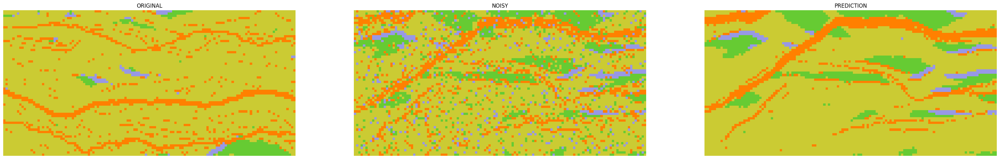

 75%|██████████████████████████████▋          | 374/499 [56:05<18:33,  8.91s/it]

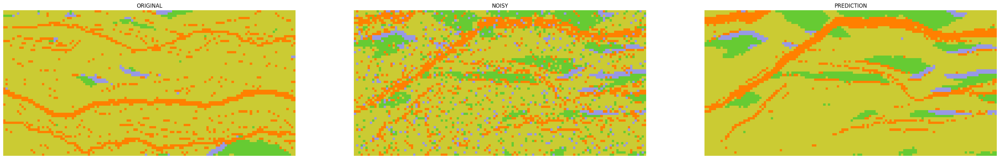

 75%|██████████████████████████████▊          | 375/499 [56:14<18:26,  8.92s/it]

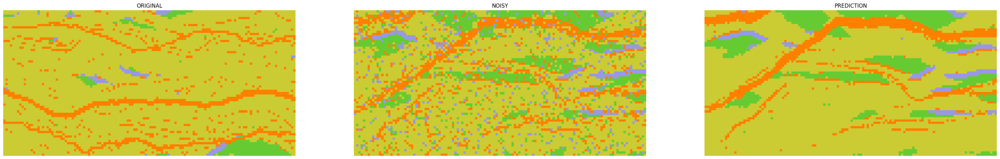

 75%|██████████████████████████████▉          | 376/499 [56:23<18:17,  8.92s/it]

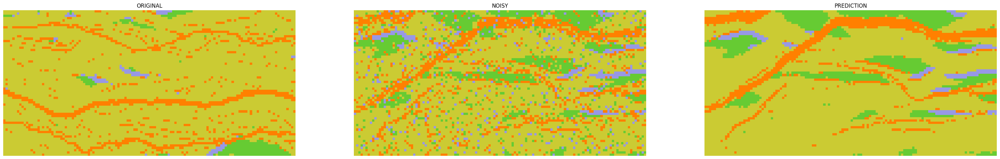

 76%|██████████████████████████████▉          | 377/499 [56:32<18:08,  8.92s/it]

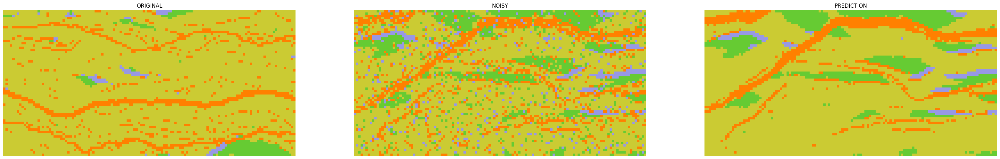

 76%|███████████████████████████████          | 378/499 [56:40<17:59,  8.92s/it]

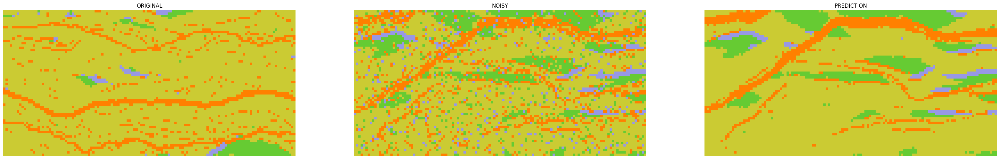

 76%|███████████████████████████████▏         | 379/499 [56:49<17:51,  8.93s/it]

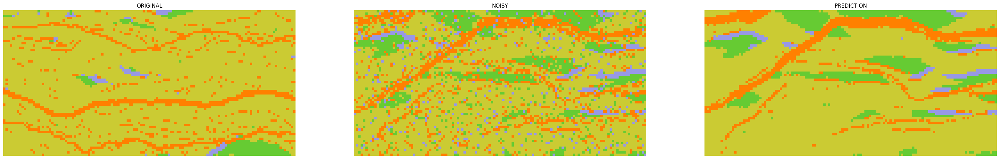

 76%|███████████████████████████████▏         | 380/499 [56:58<17:40,  8.91s/it]

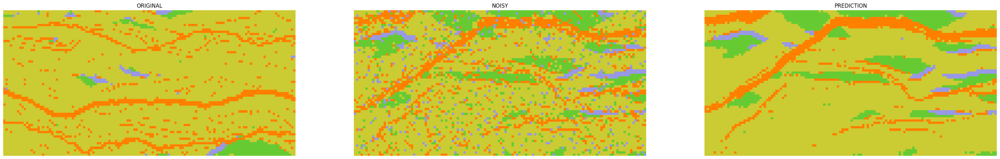

 76%|███████████████████████████████▎         | 381/499 [57:07<17:32,  8.92s/it]

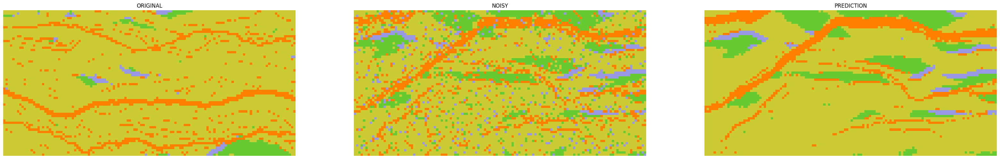

 77%|███████████████████████████████▍         | 382/499 [57:16<17:23,  8.92s/it]

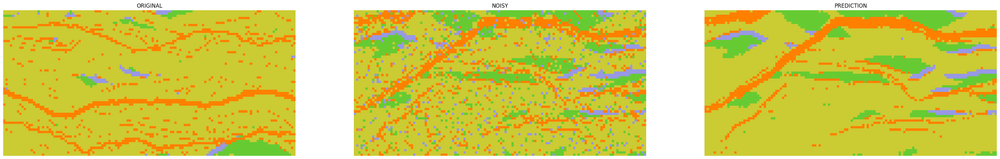

 77%|███████████████████████████████▍         | 383/499 [57:25<17:14,  8.92s/it]

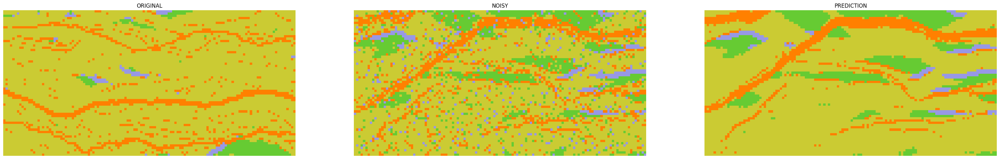

 77%|███████████████████████████████▌         | 384/499 [57:34<17:04,  8.91s/it]

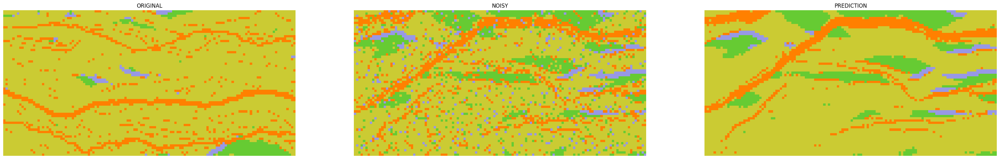

 77%|███████████████████████████████▋         | 385/499 [57:43<16:56,  8.91s/it]

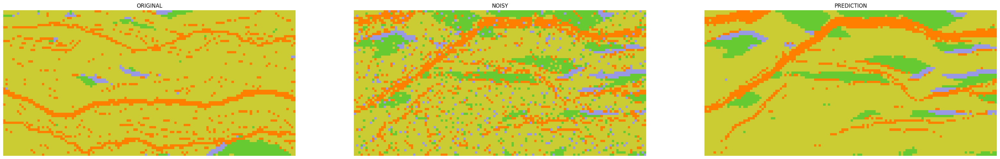

 77%|███████████████████████████████▋         | 386/499 [57:53<17:26,  9.27s/it]

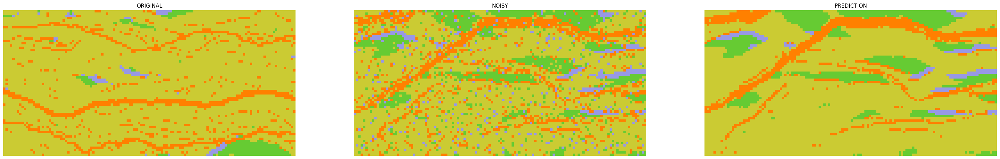

 78%|███████████████████████████████▊         | 387/499 [58:02<17:04,  9.14s/it]

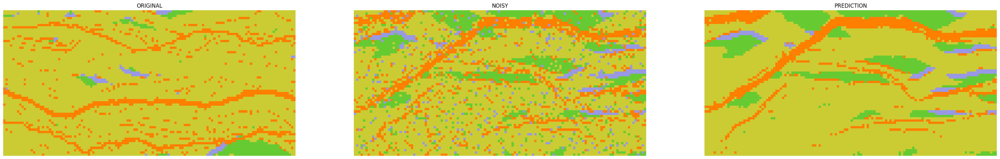

 78%|███████████████████████████████▉         | 388/499 [58:11<16:47,  9.08s/it]

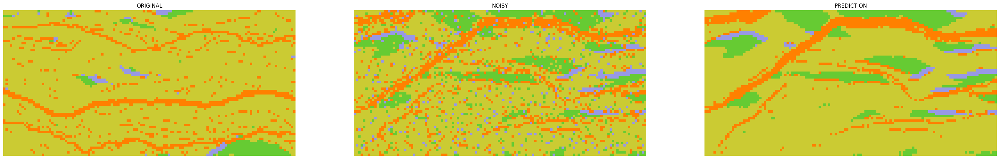

 78%|███████████████████████████████▉         | 389/499 [58:20<16:33,  9.03s/it]

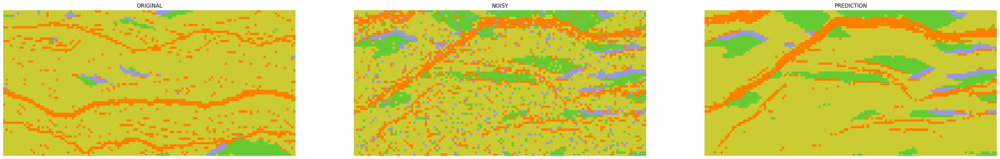

 78%|████████████████████████████████         | 390/499 [58:29<16:20,  8.99s/it]

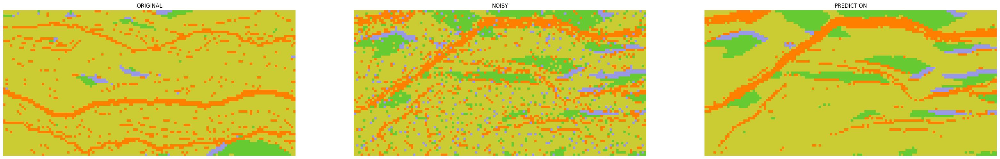

 78%|████████████████████████████████▏        | 391/499 [58:38<16:10,  8.99s/it]

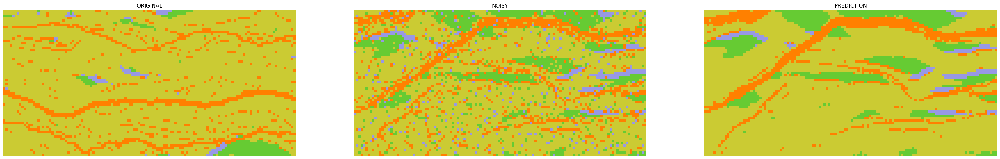

 79%|████████████████████████████████▏        | 392/499 [58:47<16:00,  8.98s/it]

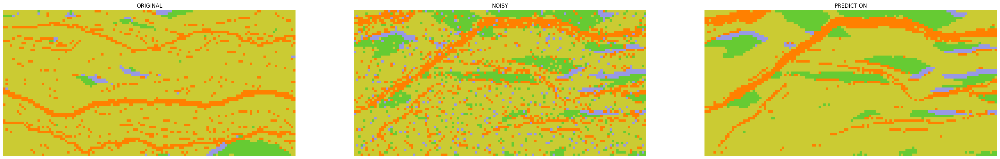

 79%|████████████████████████████████▎        | 393/499 [58:55<15:51,  8.97s/it]

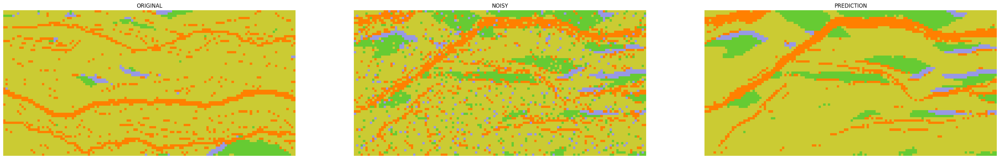

 79%|████████████████████████████████▎        | 394/499 [59:04<15:40,  8.96s/it]

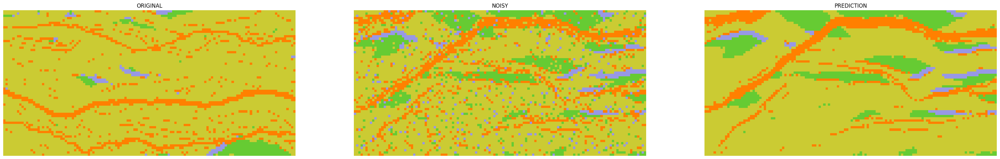

 79%|████████████████████████████████▍        | 395/499 [59:13<15:30,  8.95s/it]

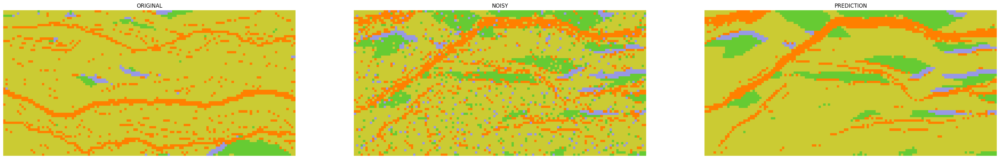

 79%|████████████████████████████████▌        | 396/499 [59:22<15:22,  8.96s/it]

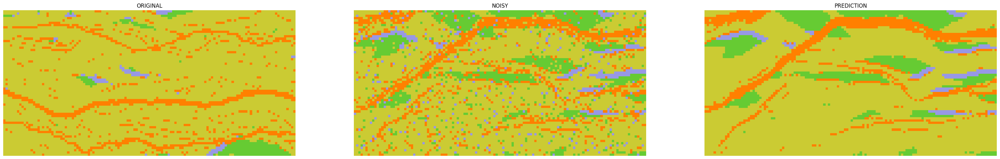

 80%|████████████████████████████████▌        | 397/499 [59:31<15:15,  8.98s/it]

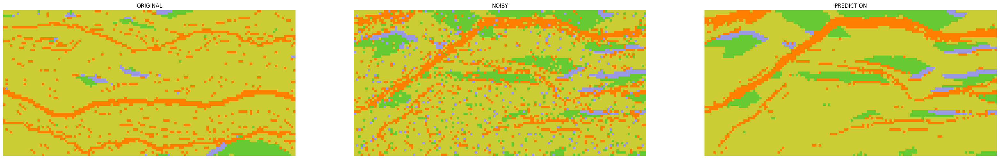

 80%|████████████████████████████████▋        | 398/499 [59:40<15:06,  8.97s/it]

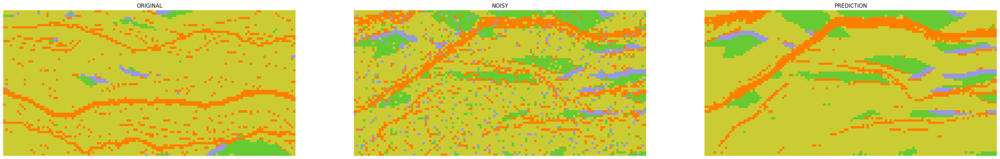

 80%|████████████████████████████████▊        | 399/499 [59:49<14:56,  8.96s/it]

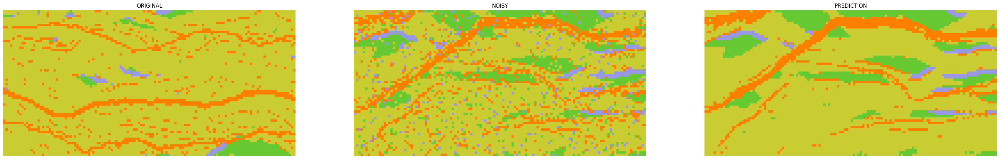

 80%|████████████████████████████████▊        | 400/499 [59:58<14:42,  8.92s/it]

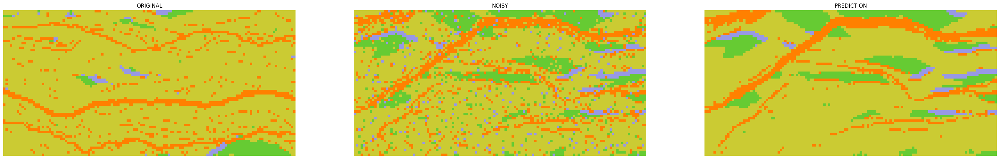

 80%|███████████████████████████████▎       | 401/499 [1:00:07<14:36,  8.94s/it]

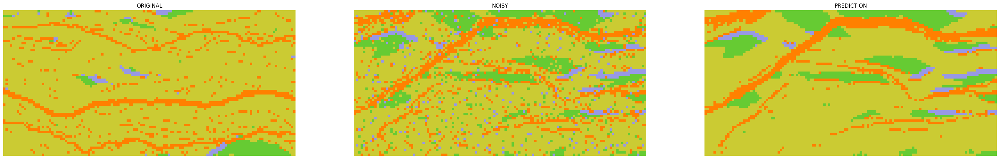

 81%|███████████████████████████████▍       | 402/499 [1:00:16<14:26,  8.93s/it]

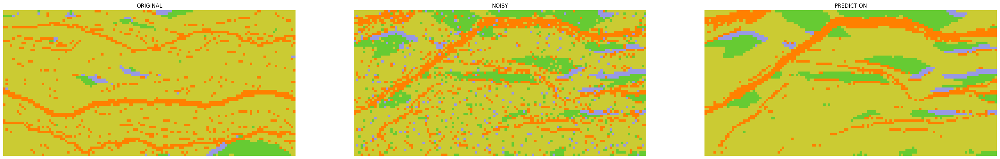

 81%|███████████████████████████████▍       | 403/499 [1:00:25<14:17,  8.93s/it]

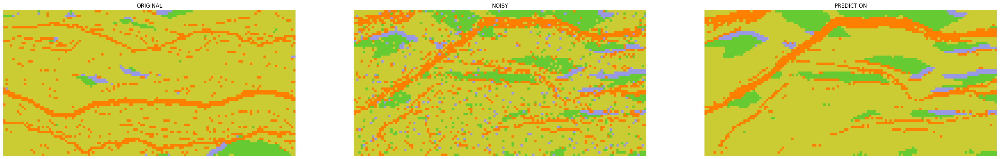

 81%|███████████████████████████████▌       | 404/499 [1:00:34<14:09,  8.94s/it]

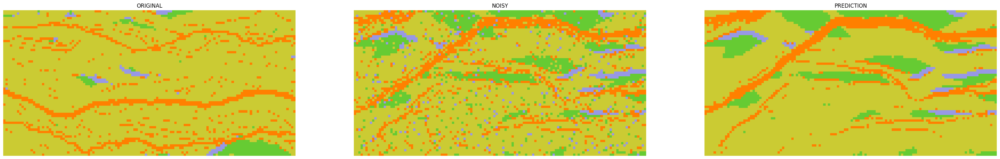

 81%|███████████████████████████████▋       | 405/499 [1:00:43<14:01,  8.95s/it]

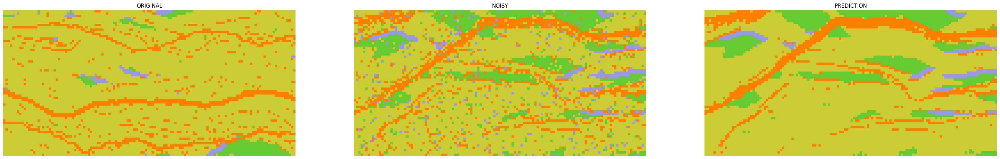

 81%|███████████████████████████████▋       | 406/499 [1:00:52<13:49,  8.92s/it]

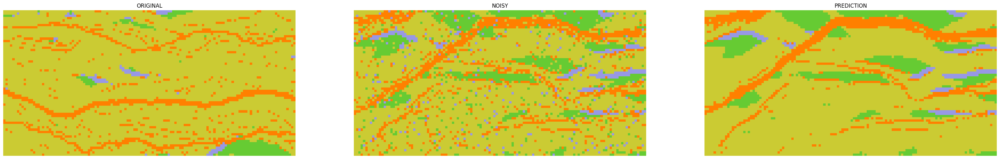

 82%|███████████████████████████████▊       | 407/499 [1:01:01<13:41,  8.93s/it]

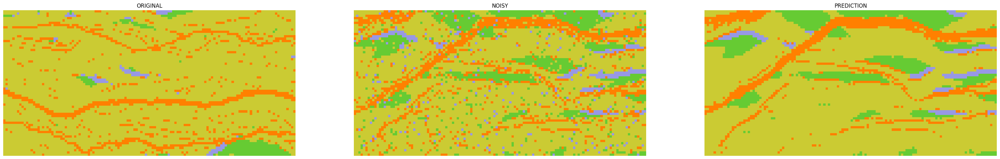

 82%|███████████████████████████████▉       | 408/499 [1:01:10<13:33,  8.94s/it]

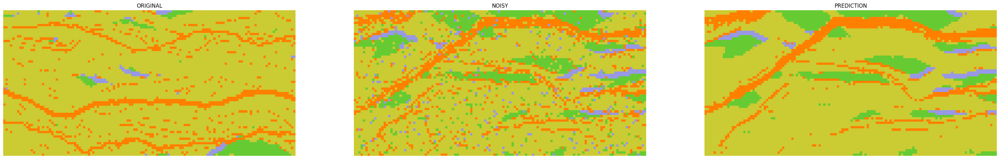

 82%|███████████████████████████████▉       | 409/499 [1:01:19<13:25,  8.95s/it]

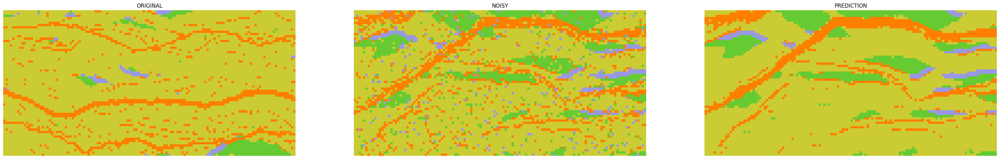

 82%|████████████████████████████████       | 410/499 [1:01:27<13:15,  8.94s/it]

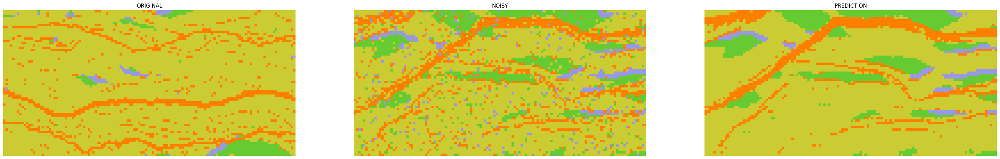

 82%|████████████████████████████████       | 411/499 [1:01:36<13:05,  8.92s/it]

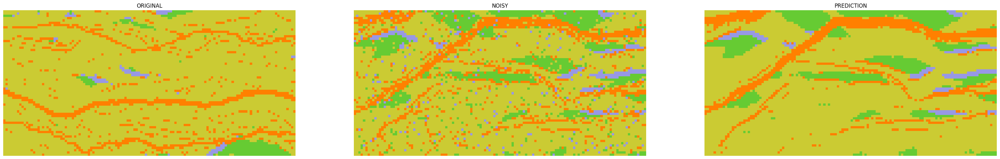

 83%|████████████████████████████████▏      | 412/499 [1:01:45<12:56,  8.92s/it]

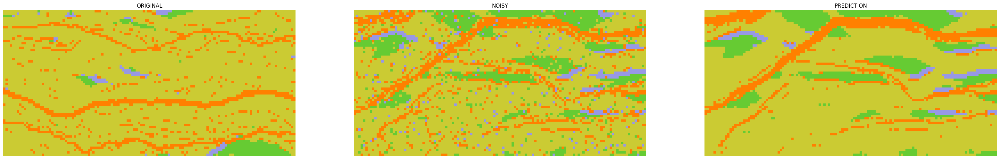

 83%|████████████████████████████████▎      | 413/499 [1:01:54<12:46,  8.92s/it]

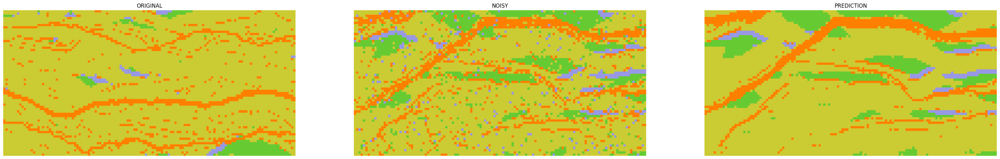

 83%|████████████████████████████████▎      | 414/499 [1:02:03<12:35,  8.89s/it]

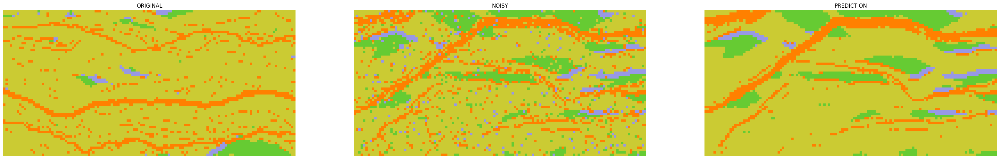

 83%|████████████████████████████████▍      | 415/499 [1:02:12<12:26,  8.89s/it]

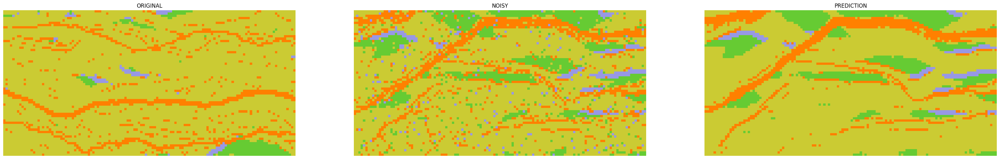

 83%|████████████████████████████████▌      | 416/499 [1:02:21<12:18,  8.89s/it]

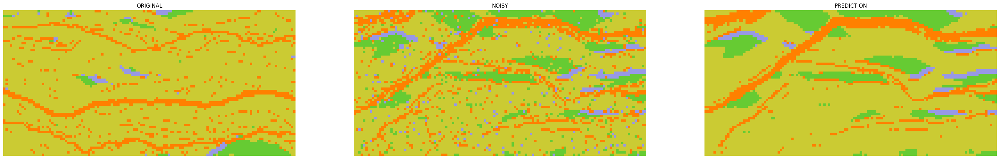

 84%|████████████████████████████████▌      | 417/499 [1:02:30<12:10,  8.91s/it]

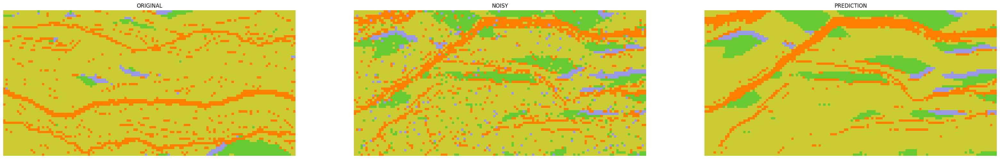

 84%|████████████████████████████████▋      | 418/499 [1:02:39<12:01,  8.91s/it]

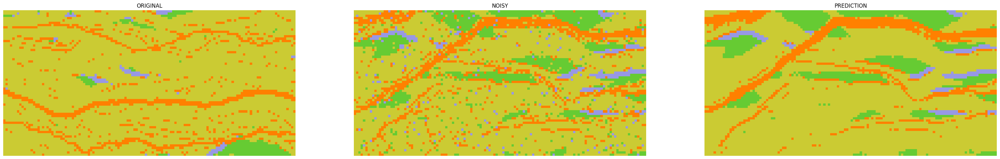

 84%|████████████████████████████████▋      | 419/499 [1:02:48<11:53,  8.91s/it]

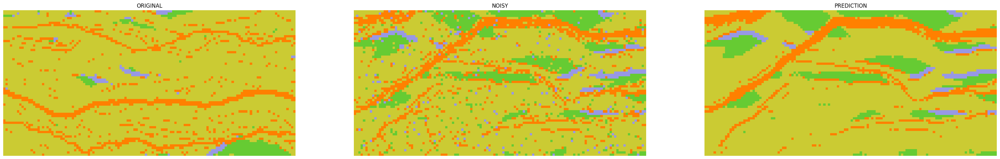

 84%|████████████████████████████████▊      | 420/499 [1:02:57<11:44,  8.92s/it]

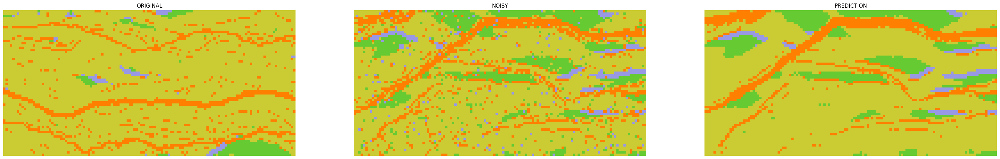

 84%|████████████████████████████████▉      | 421/499 [1:03:05<11:36,  8.93s/it]

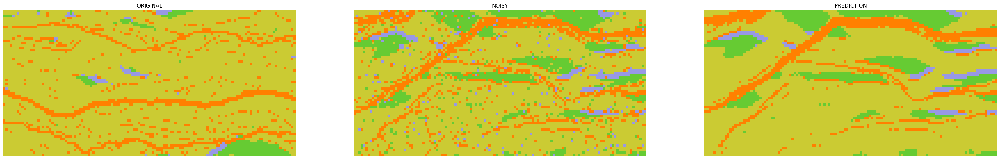

 85%|████████████████████████████████▉      | 422/499 [1:03:14<11:27,  8.92s/it]

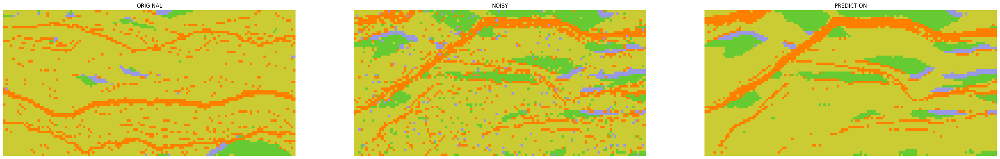

 85%|█████████████████████████████████      | 423/499 [1:03:23<11:18,  8.92s/it]

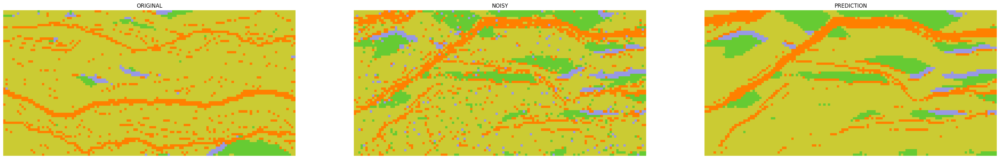

 85%|█████████████████████████████████▏     | 424/499 [1:03:32<11:09,  8.93s/it]

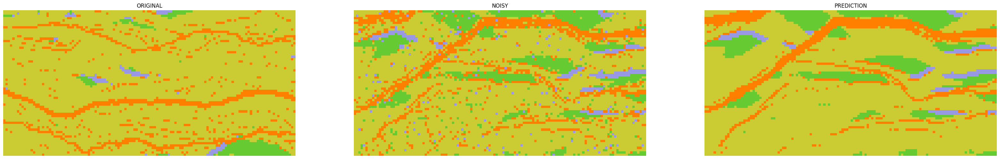

 85%|█████████████████████████████████▏     | 425/499 [1:03:41<10:59,  8.92s/it]

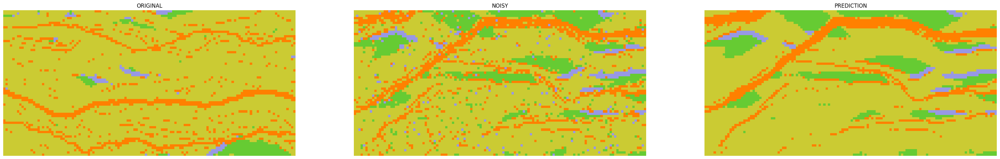

 85%|█████████████████████████████████▎     | 426/499 [1:03:50<10:51,  8.93s/it]

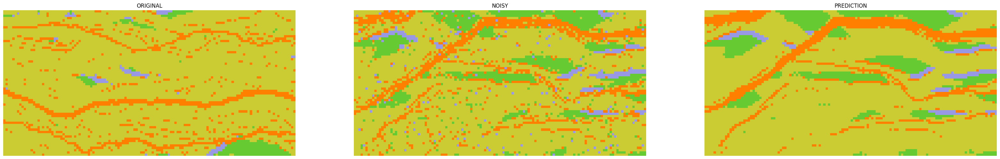

 86%|█████████████████████████████████▎     | 427/499 [1:04:00<11:05,  9.25s/it]

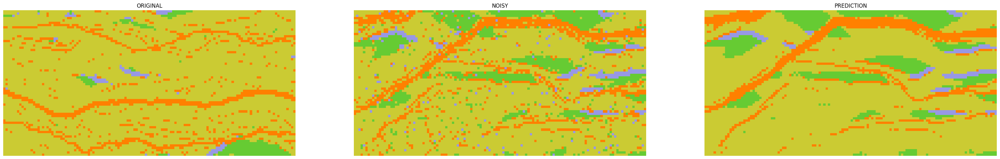

 86%|█████████████████████████████████▍     | 428/499 [1:04:09<10:51,  9.18s/it]

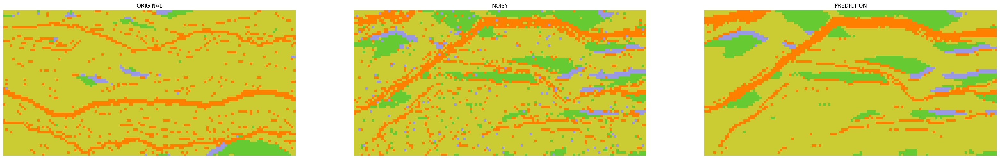

 86%|█████████████████████████████████▌     | 429/499 [1:04:18<10:36,  9.10s/it]

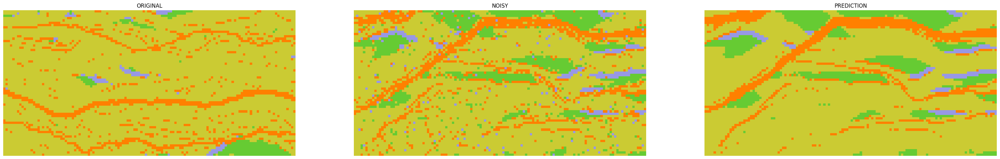

 86%|█████████████████████████████████▌     | 430/499 [1:04:27<10:24,  9.04s/it]

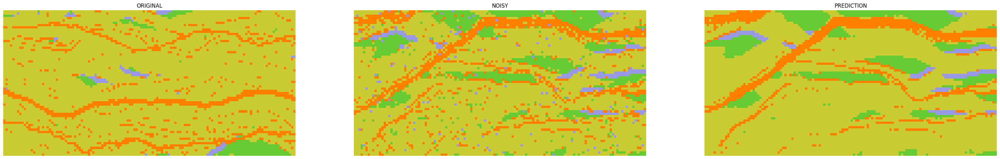

 86%|█████████████████████████████████▋     | 431/499 [1:04:36<10:13,  9.03s/it]

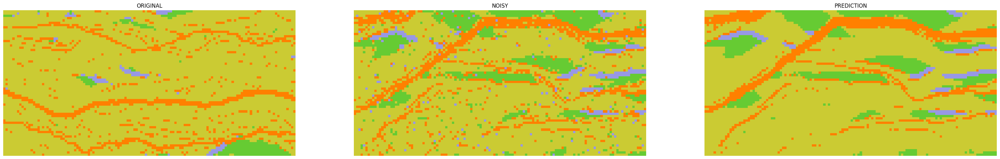

 87%|█████████████████████████████████▊     | 432/499 [1:04:45<10:03,  9.00s/it]

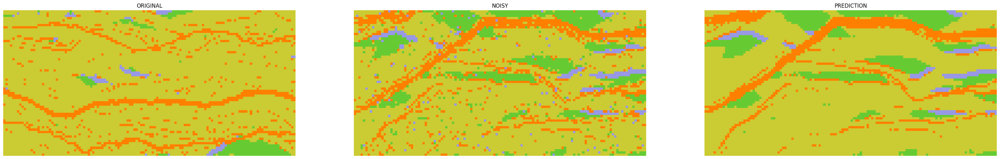

 87%|█████████████████████████████████▊     | 433/499 [1:04:54<09:53,  8.99s/it]

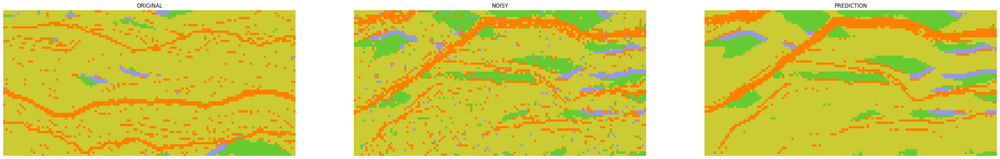

 87%|█████████████████████████████████▉     | 434/499 [1:05:03<09:43,  8.98s/it]

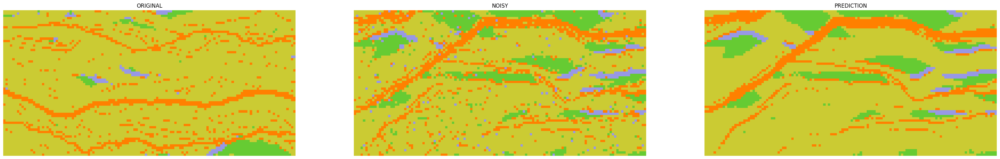

 87%|█████████████████████████████████▉     | 435/499 [1:05:12<09:33,  8.96s/it]

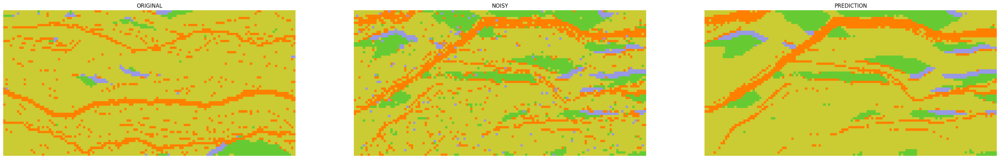

 87%|██████████████████████████████████     | 436/499 [1:05:21<09:24,  8.96s/it]

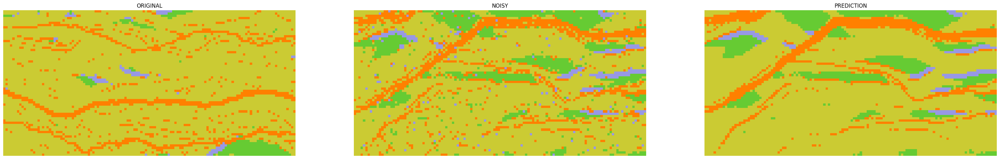

 88%|██████████████████████████████████▏    | 437/499 [1:05:30<09:15,  8.96s/it]

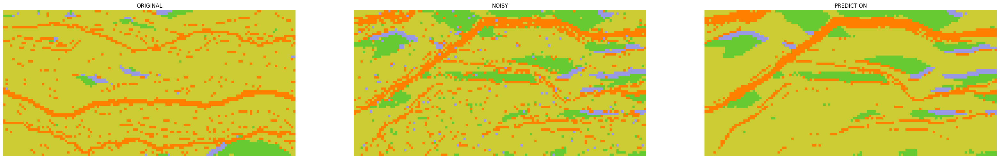

 88%|██████████████████████████████████▏    | 438/499 [1:05:39<09:06,  8.96s/it]

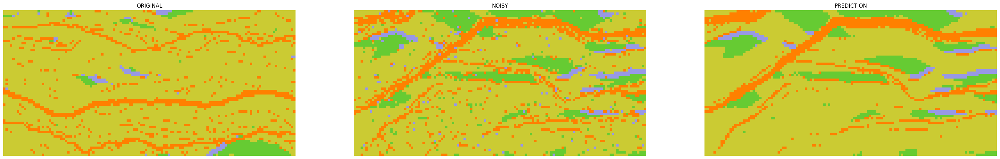

 88%|██████████████████████████████████▎    | 439/499 [1:05:48<08:57,  8.95s/it]

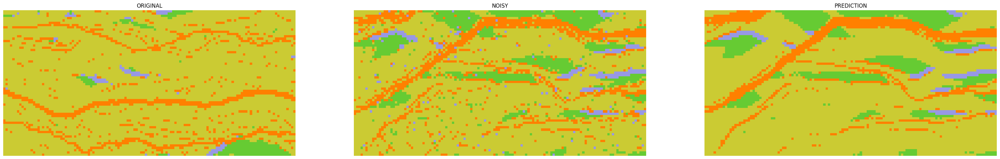

 88%|██████████████████████████████████▍    | 440/499 [1:05:56<08:48,  8.95s/it]

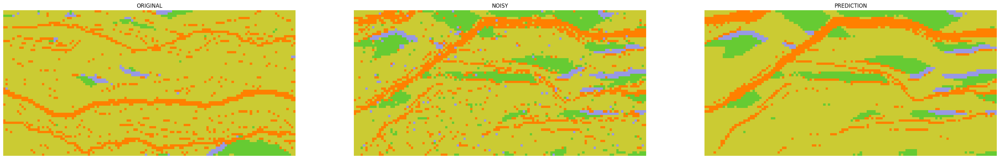

 88%|██████████████████████████████████▍    | 441/499 [1:06:05<08:36,  8.91s/it]

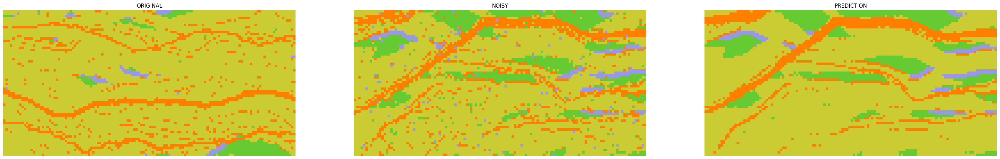

 89%|██████████████████████████████████▌    | 442/499 [1:06:14<08:28,  8.92s/it]

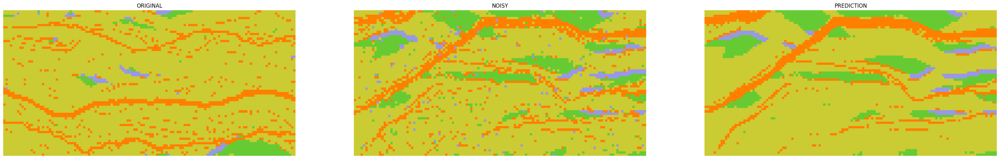

 89%|██████████████████████████████████▌    | 443/499 [1:06:23<08:18,  8.91s/it]

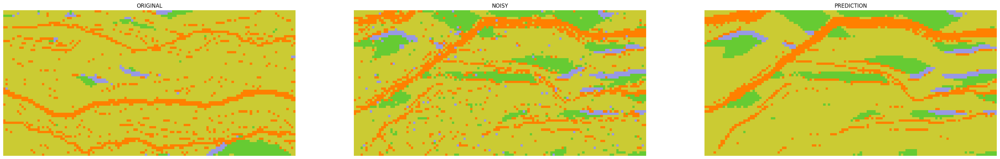

 89%|██████████████████████████████████▋    | 444/499 [1:06:32<08:10,  8.92s/it]

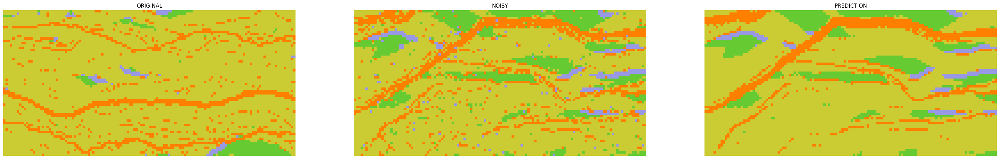

 89%|██████████████████████████████████▊    | 445/499 [1:06:41<08:01,  8.92s/it]

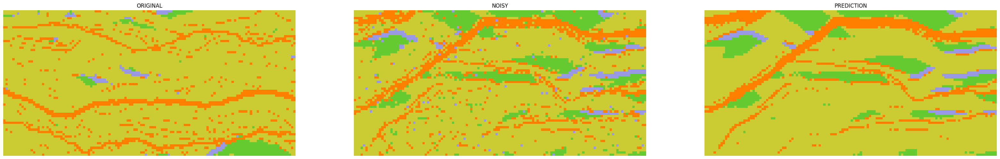

 89%|██████████████████████████████████▊    | 446/499 [1:06:50<07:53,  8.93s/it]

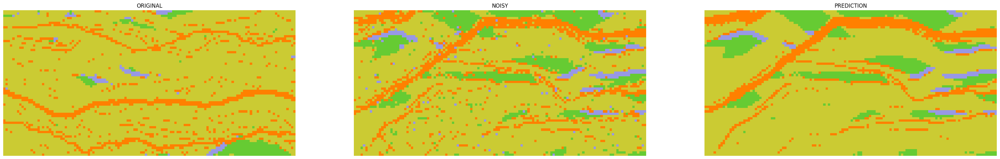

 90%|██████████████████████████████████▉    | 447/499 [1:06:59<07:44,  8.93s/it]

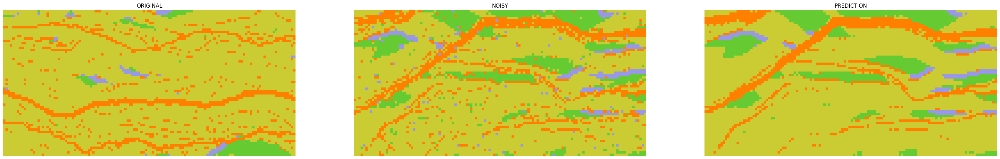

 90%|███████████████████████████████████    | 448/499 [1:07:08<07:34,  8.92s/it]

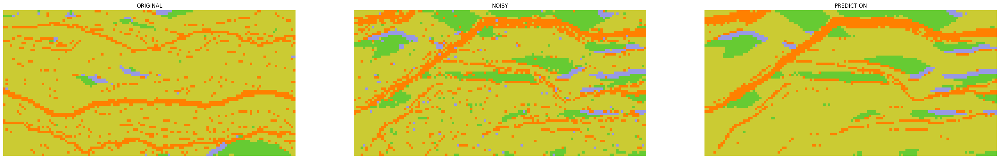

 90%|███████████████████████████████████    | 449/499 [1:07:17<07:26,  8.92s/it]

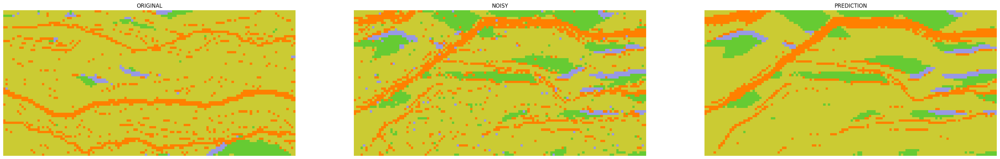

 90%|███████████████████████████████████▏   | 450/499 [1:07:26<07:17,  8.92s/it]

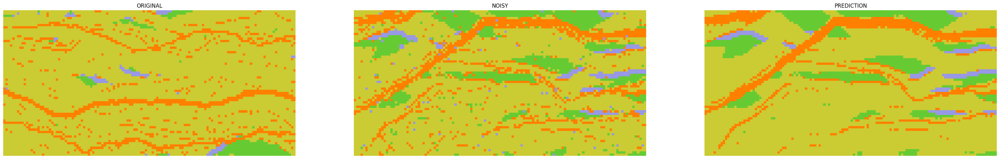

 90%|███████████████████████████████████▏   | 451/499 [1:07:35<07:08,  8.93s/it]

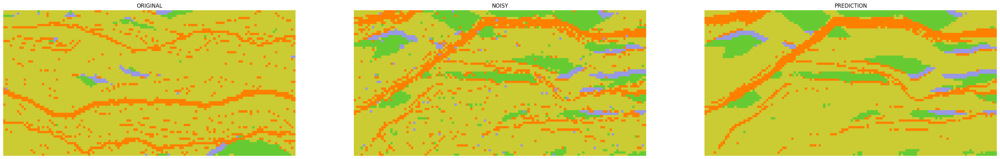

 91%|███████████████████████████████████▎   | 452/499 [1:07:43<06:59,  8.94s/it]

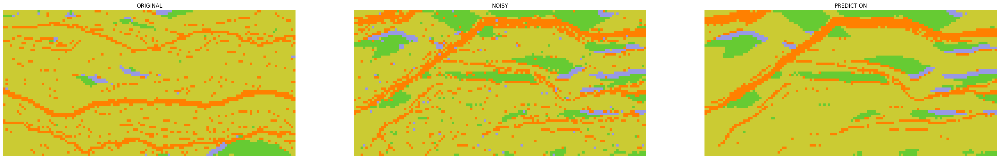

 91%|███████████████████████████████████▍   | 453/499 [1:07:52<06:50,  8.93s/it]

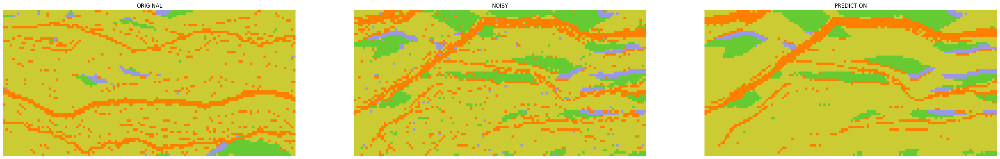

 91%|███████████████████████████████████▍   | 454/499 [1:08:01<06:41,  8.92s/it]

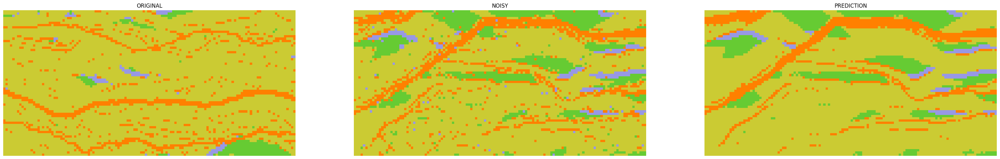

 91%|███████████████████████████████████▌   | 455/499 [1:08:10<06:32,  8.92s/it]

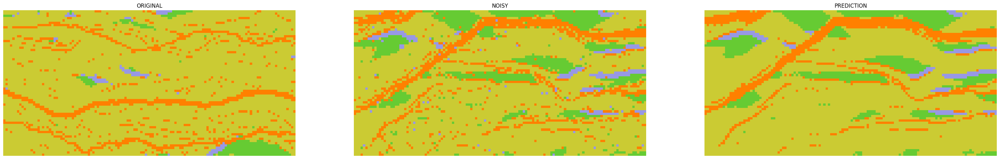

 91%|███████████████████████████████████▋   | 456/499 [1:08:19<06:23,  8.93s/it]

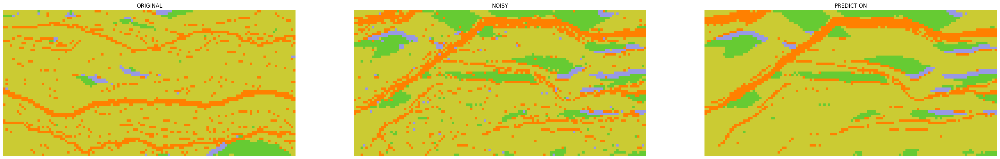

 92%|███████████████████████████████████▋   | 457/499 [1:08:28<06:14,  8.93s/it]

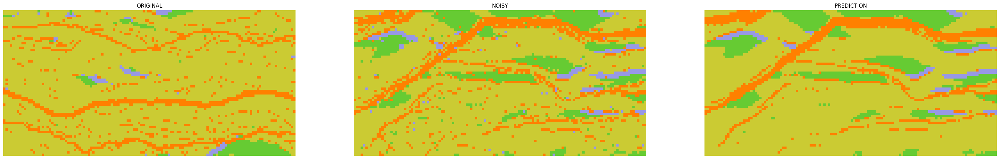

 92%|███████████████████████████████████▊   | 458/499 [1:08:37<06:05,  8.91s/it]

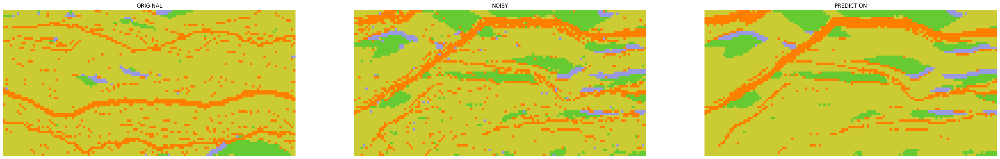

 92%|███████████████████████████████████▊   | 459/499 [1:08:46<05:56,  8.90s/it]

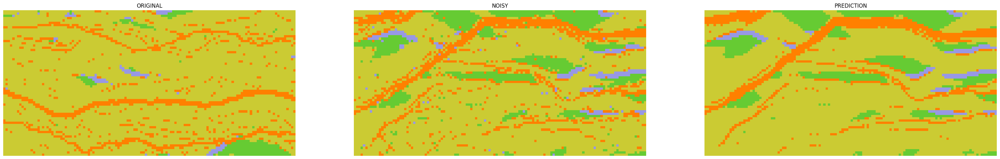

 92%|███████████████████████████████████▉   | 460/499 [1:08:55<05:47,  8.92s/it]

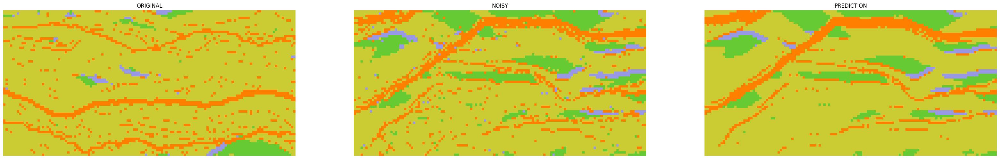

 92%|████████████████████████████████████   | 461/499 [1:09:04<05:39,  8.94s/it]

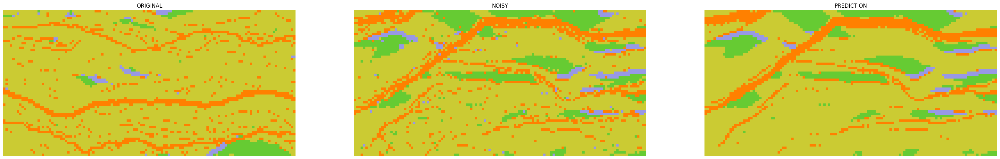

 93%|████████████████████████████████████   | 462/499 [1:09:13<05:30,  8.94s/it]

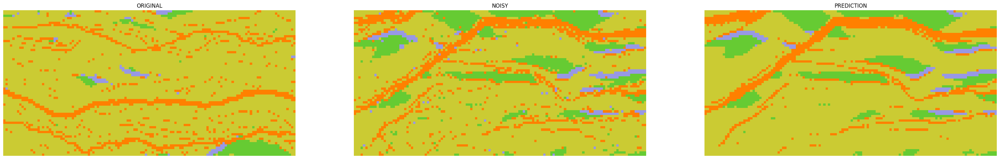

 93%|████████████████████████████████████▏  | 463/499 [1:09:22<05:21,  8.94s/it]

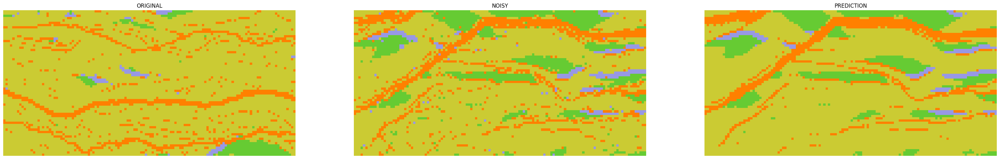

 93%|████████████████████████████████████▎  | 464/499 [1:09:31<05:13,  8.94s/it]

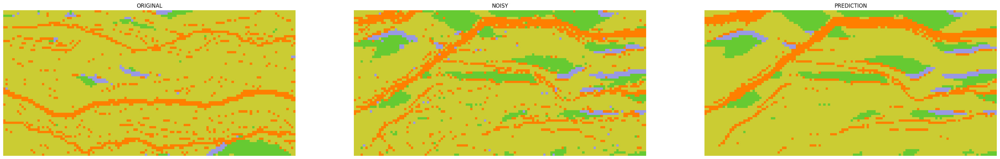

 93%|████████████████████████████████████▎  | 465/499 [1:09:40<05:03,  8.93s/it]

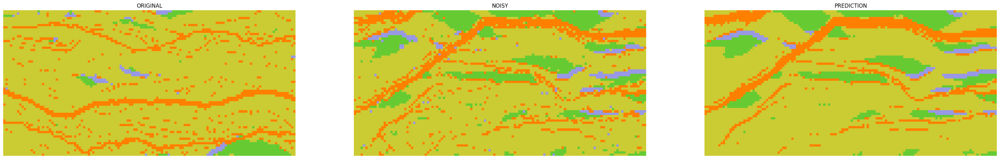

 93%|████████████████████████████████████▍  | 466/499 [1:09:48<04:54,  8.94s/it]

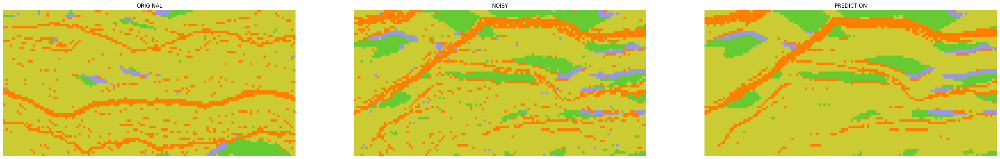

 94%|████████████████████████████████████▍  | 467/499 [1:09:57<04:46,  8.94s/it]

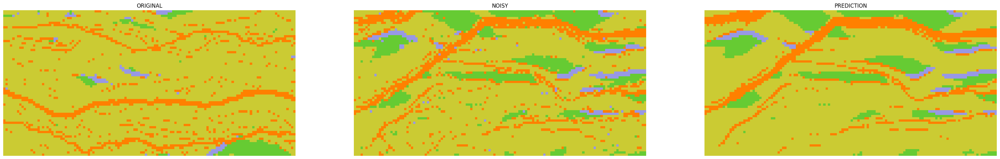

 94%|████████████████████████████████████▌  | 468/499 [1:10:07<04:46,  9.24s/it]

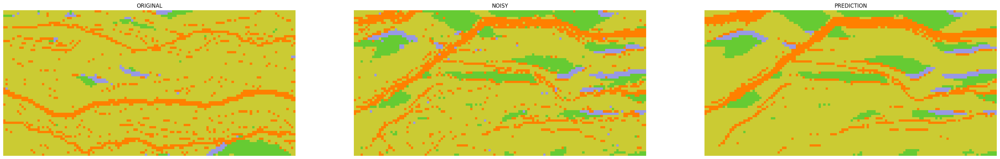

 94%|████████████████████████████████████▋  | 469/499 [1:10:16<04:34,  9.14s/it]

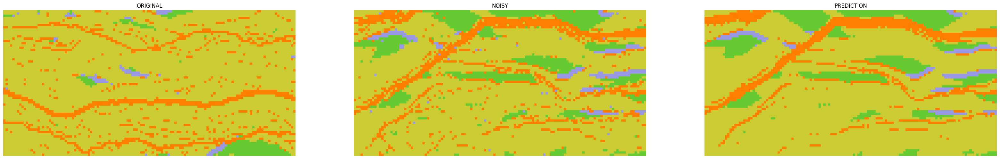

 94%|████████████████████████████████████▋  | 470/499 [1:10:25<04:23,  9.09s/it]

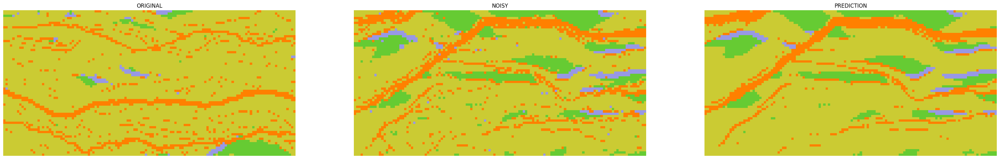

 94%|████████████████████████████████████▊  | 471/499 [1:10:34<04:13,  9.06s/it]

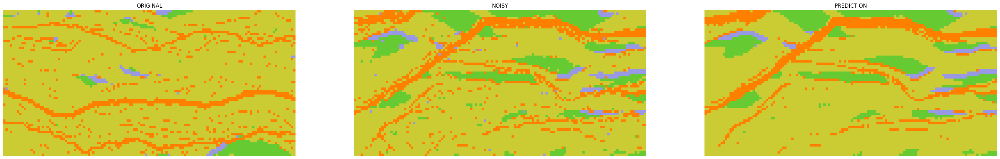

 95%|████████████████████████████████████▉  | 472/499 [1:10:43<04:03,  9.03s/it]

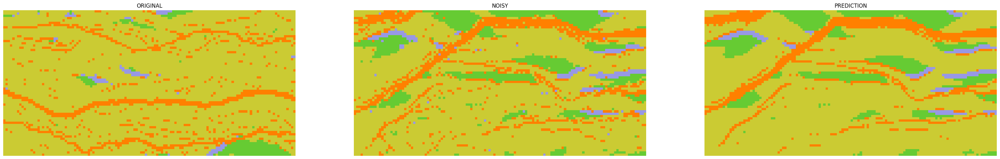

 95%|████████████████████████████████████▉  | 473/499 [1:10:52<03:54,  9.02s/it]

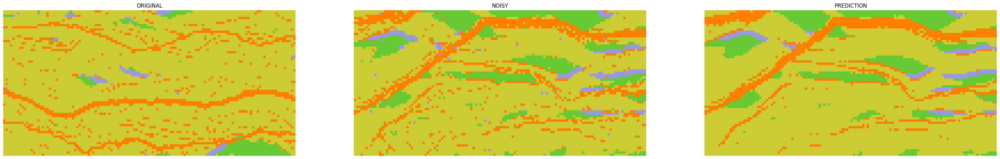

 95%|█████████████████████████████████████  | 474/499 [1:11:01<03:45,  9.02s/it]

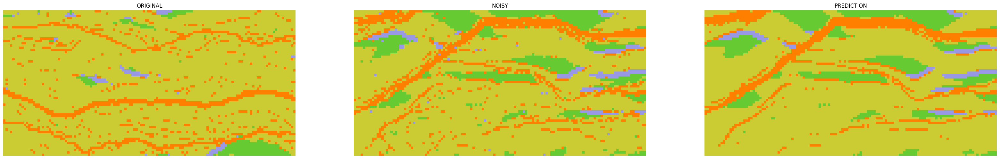

 95%|█████████████████████████████████████  | 475/499 [1:11:10<03:35,  9.00s/it]

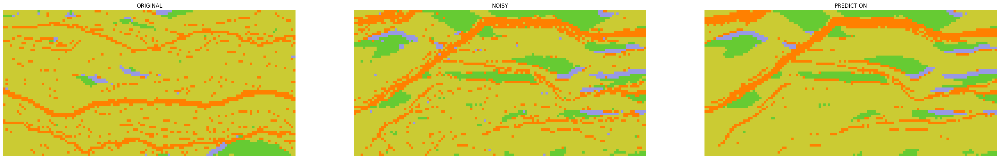

 95%|█████████████████████████████████████▏ | 476/499 [1:11:19<03:26,  8.99s/it]

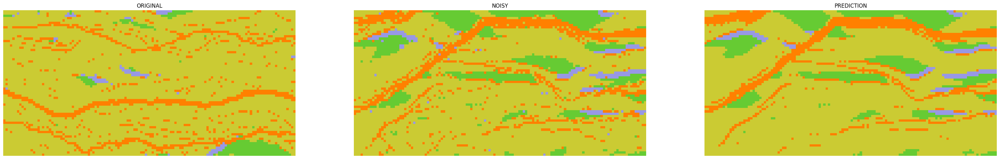

 96%|█████████████████████████████████████▎ | 477/499 [1:11:28<03:17,  8.99s/it]

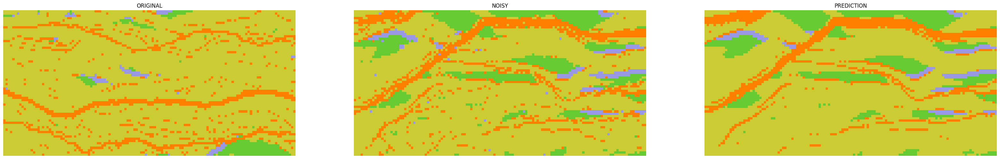

 96%|█████████████████████████████████████▎ | 478/499 [1:11:37<03:08,  8.96s/it]

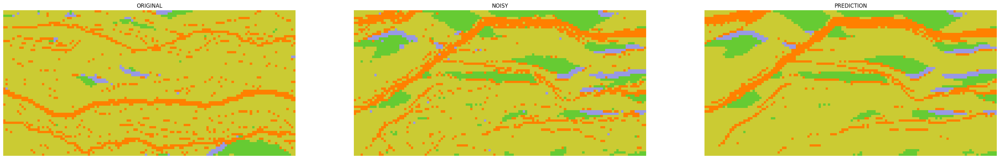

 96%|█████████████████████████████████████▍ | 479/499 [1:11:46<02:59,  8.97s/it]

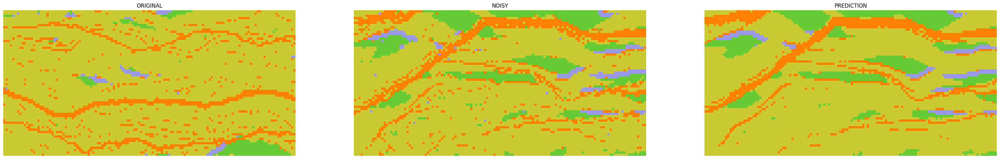

 96%|█████████████████████████████████████▌ | 480/499 [1:11:55<02:50,  8.95s/it]

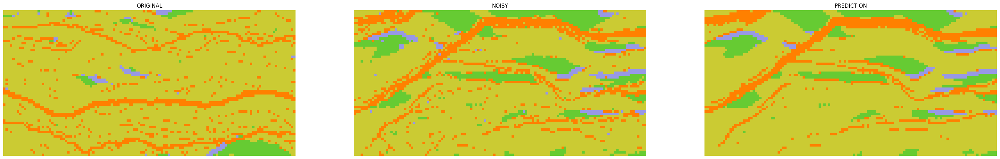

 96%|█████████████████████████████████████▌ | 481/499 [1:12:04<02:40,  8.93s/it]

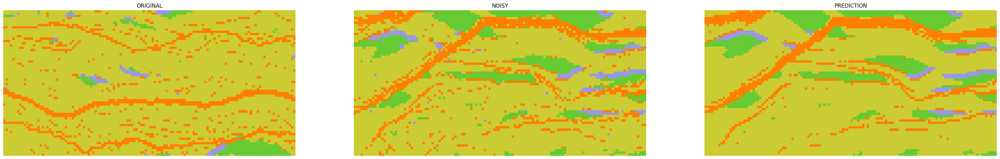

 97%|█████████████████████████████████████▋ | 482/499 [1:12:13<02:31,  8.92s/it]

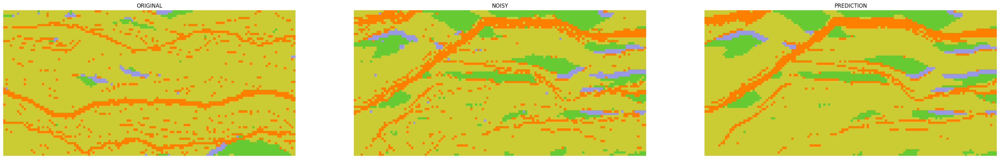

 97%|█████████████████████████████████████▋ | 483/499 [1:12:22<02:22,  8.92s/it]

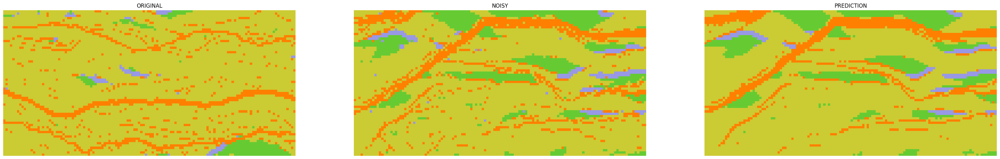

 97%|█████████████████████████████████████▊ | 484/499 [1:12:30<02:13,  8.93s/it]

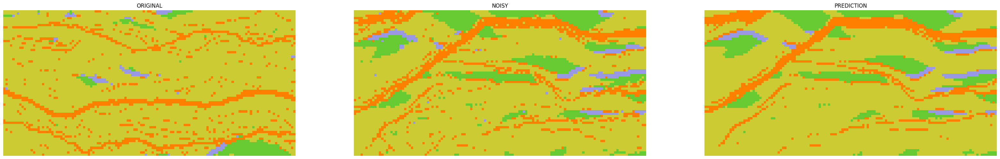

 97%|█████████████████████████████████████▉ | 485/499 [1:12:39<02:04,  8.92s/it]

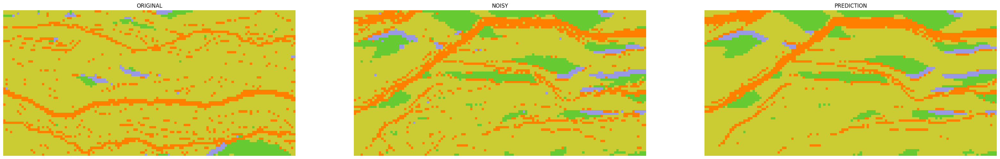

 97%|█████████████████████████████████████▉ | 486/499 [1:12:48<01:56,  8.94s/it]

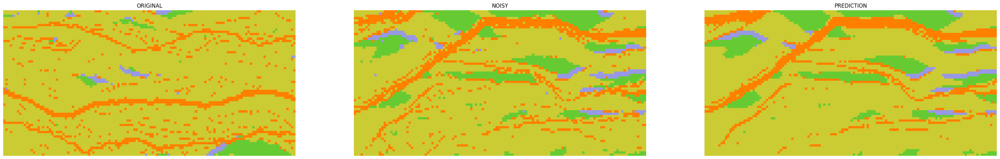

 98%|██████████████████████████████████████ | 487/499 [1:12:57<01:47,  8.95s/it]

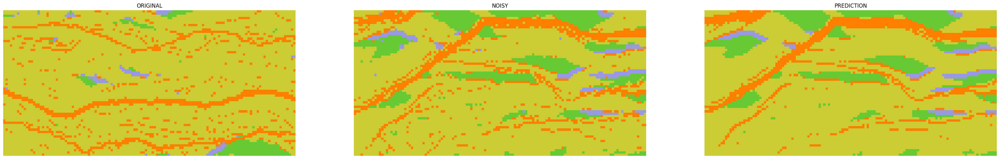

 98%|██████████████████████████████████████▏| 488/499 [1:13:06<01:38,  8.95s/it]

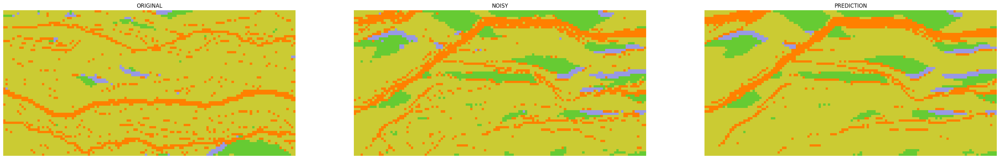

 98%|██████████████████████████████████████▏| 489/499 [1:13:15<01:29,  8.93s/it]

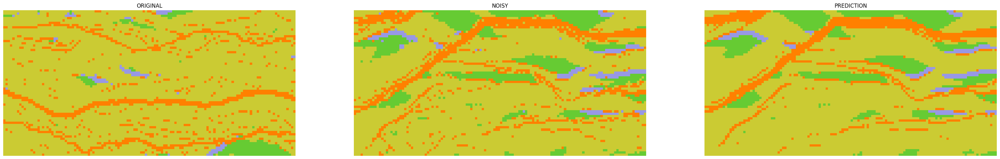

 98%|██████████████████████████████████████▎| 490/499 [1:13:24<01:20,  8.94s/it]

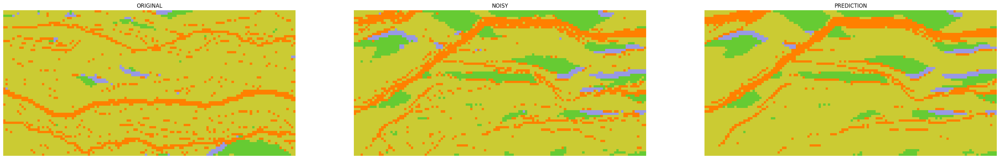

 98%|██████████████████████████████████████▎| 491/499 [1:13:33<01:11,  8.94s/it]

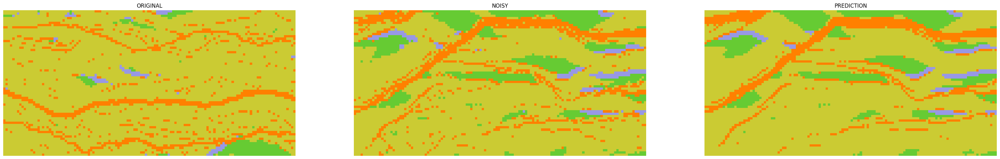

 99%|██████████████████████████████████████▍| 492/499 [1:13:42<01:02,  8.94s/it]

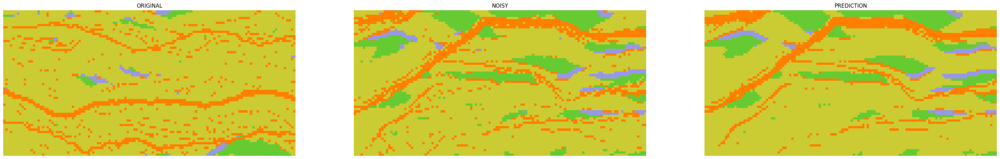

 99%|██████████████████████████████████████▌| 493/499 [1:13:51<00:53,  8.95s/it]

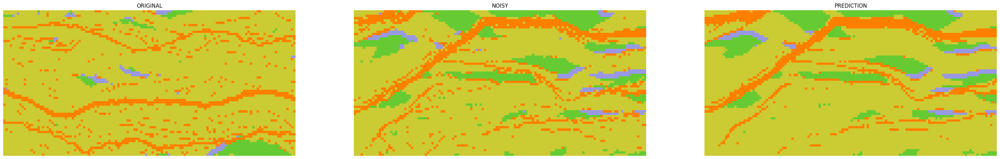

 99%|██████████████████████████████████████▌| 494/499 [1:14:00<00:44,  8.95s/it]

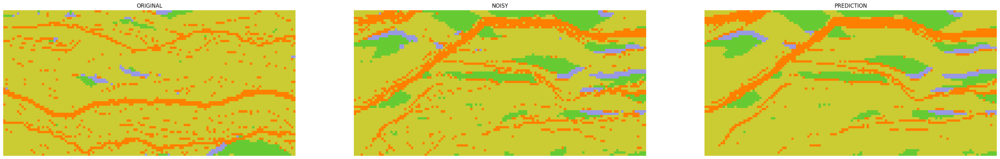

 99%|██████████████████████████████████████▋| 495/499 [1:14:09<00:35,  8.92s/it]

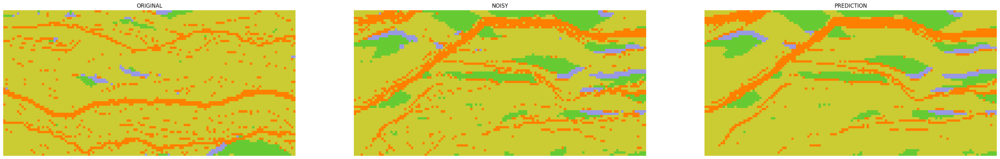

 99%|██████████████████████████████████████▊| 496/499 [1:14:18<00:26,  8.93s/it]

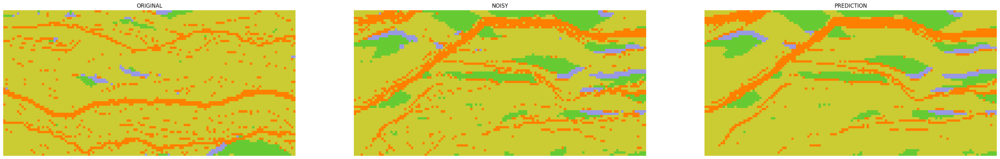

100%|██████████████████████████████████████▊| 497/499 [1:14:27<00:17,  8.93s/it]

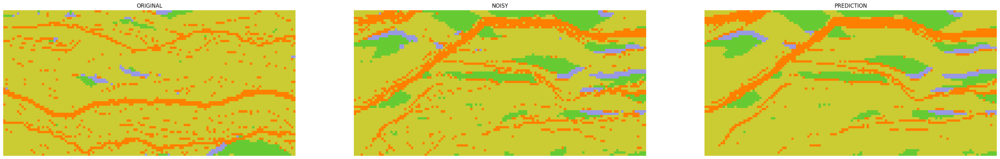

100%|██████████████████████████████████████▉| 498/499 [1:14:36<00:08,  8.92s/it]

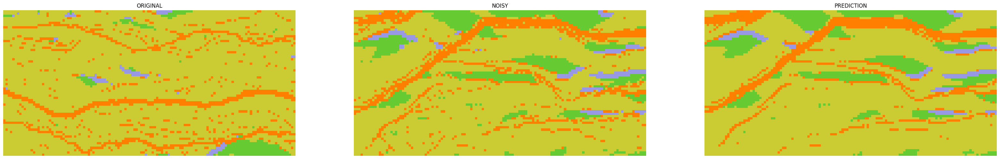

100%|███████████████████████████████████████| 499/499 [1:14:45<00:00,  8.99s/it]


In [54]:
from tqdm.autonotebook import tqdm

step_size = 0.002
steps = np.arange(0, 1, step_size, dtype=np.float64)
num_images = 500

init_x = tf.random.uniform((num_images, 64, 128), 0, 4, dtype=tf.dtypes.int32)
init_x = keras.utils.to_categorical(init_x)

plt.imshow(np.argmax(init_x[0], axis=-1).reshape((64, 128)),
            interpolation='nearest', cmap=cmap, norm=norm)
plt.show()

# important line:
# at the first sampling step, the "noisy image" is pure noise
# but its signal rate is assumed to be nonzero (min_signal_rate)
next_noisy_images = tf.cast(init_x, dtype=tf.float64)

for i, step in enumerate(tqdm(np.flip(steps[:499]))):
    noisy_images = next_noisy_images

    # separate the current noisy image to its components
    input_diffusion_times = steps[498 - i] * tf.ones((num_images, 1, 1, 1), dtype=tf.float64)

    pred_images = model.denoise(
        noisy_images, input_diffusion_times, training=False
    )
    for j in range(1):
        plt.figure(figsize=(40, 40))
        plt.subplot(1, 2, 1)
        plt.title('NOISY')
        plt.imshow(np.argmax(noisy_images[j].numpy(), axis=-1), interpolation='nearest', cmap=cmap, norm=norm)
        plt.axis("off")
        plt.subplot(1, 2, 2)
        plt.title('PREDICTION')
        plt.imshow(np.argmax(pred_images[j].numpy(), axis=-1), interpolation='nearest', cmap=cmap, norm=norm)
        plt.axis("off")
        plt.show()

        
    next_diffusion_times = steps[498 - (i + 1)] * tf.ones((num_images, 1, 1, 1), dtype=tf.float64)
    next_noisy_images, _, _, _ = tf.map_fn(lambda x: model.conditional_reverse_probability(x[0], x[1], x[2], x[3], sample=True),
                                           (pred_images, noisy_images, input_diffusion_times, next_diffusion_times), parallel_iterations=64)


/tmp/ipykernel_4033325/2885170212.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 10))


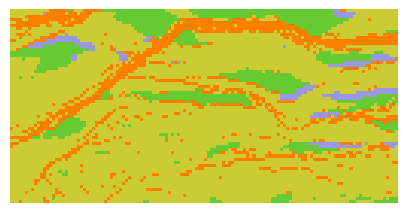

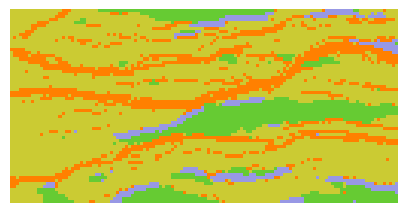

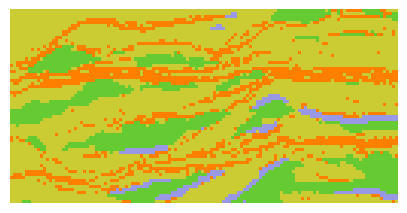

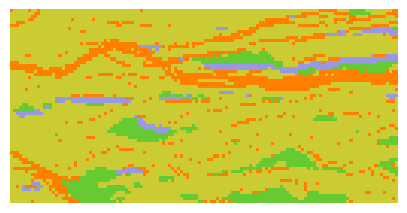

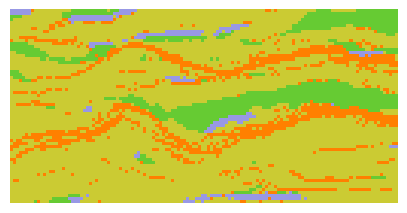

...

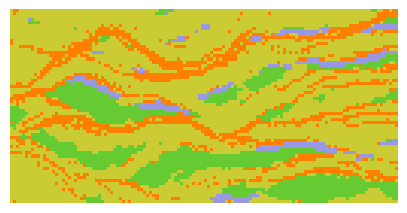

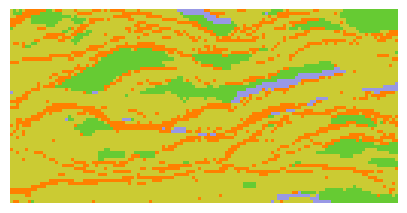

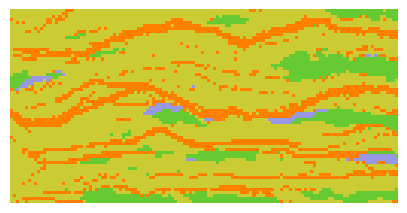

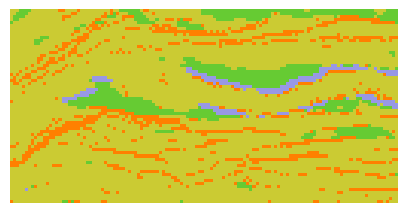

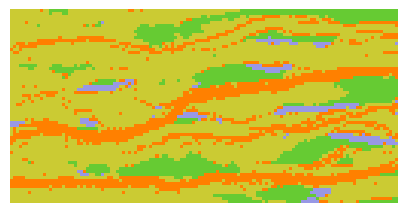

In [59]:
    for j in range(500):
        plt.figure(figsize=(5, 10))
        plt.imshow(np.argmax(next_noisy_images[j].numpy(), axis=-1), interpolation='nearest', cmap=cmap, norm=norm)
        plt.axis("off")

/tmp/ipykernel_4033325/1251166358.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 10))


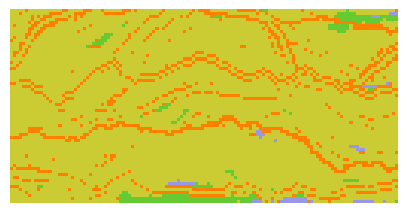

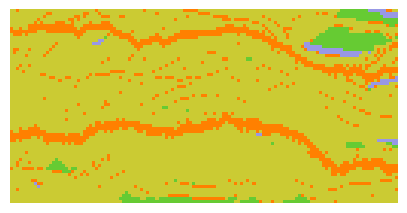

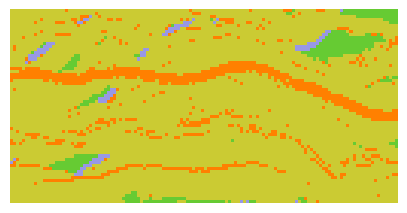

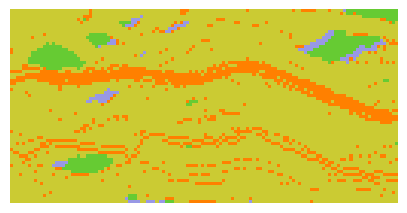

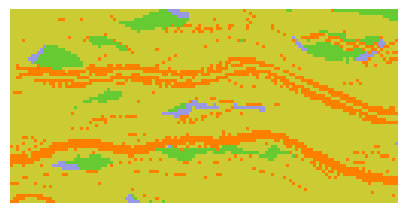

...

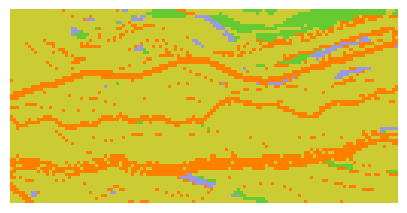

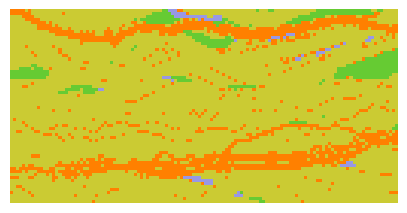

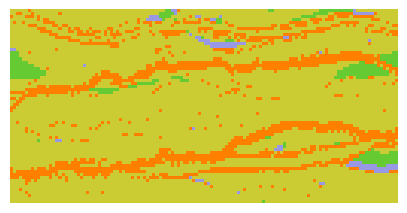

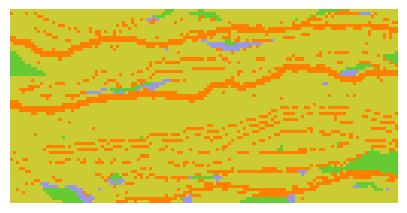

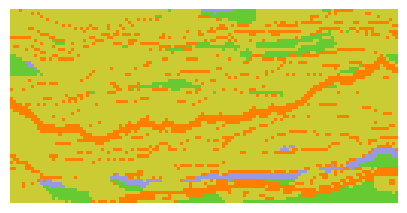

In [56]:
    for j in range(50):
        plt.figure(figsize=(5, 10))
        plt.imshow(np.argmax(x_test[j].numpy(), axis=-1), interpolation='nearest', cmap=cmap, norm=norm)
        plt.axis("off")

In [57]:
import os

# To save a trained model change this variable to True
SAVE_AND_TAR_RESULTS_WEIGHTS = True

if SAVE_AND_TAR_RESULTS_WEIGHTS:
    diffusion_checkpoint_path = "ddm_discrete_jump_markov_weights_conditional/cp-ddm_discrete_jump_markov.ckpt"
    diffusion_checkpoint_dir = os.path.dirname(diffusion_checkpoint_path)

    model.save_weights(diffusion_checkpoint_path)

    !tar -czvf ddm_discrete_jump_markov_weights_conditional.tar.gz ./ddm_discrete_jump_markov_weights_conditional

    unet_checkpoint_path = "unet_discrete_jump_markov_weights_conditional/cp-unet_discrete_jump_markov.ckpt"
    unet_checkpoint_dir = os.path.dirname(unet_checkpoint_path)

    model.network.save_weights(unet_checkpoint_path)

    !tar -czvf unet_discrete_jump_markov_weights_conditional.tar.gz ./unet_discrete_jump_markov_weights_conditional

    ema_unet_checkpoint_path = "ema_unet_discrete_jump_markov_weights_conditional/cp-ema_unet_discrete_jump_markov.ckpt"
    ema_unet_checkpoint_dir = os.path.dirname(ema_unet_checkpoint_path)

    model.ema_network.save_weights(ema_unet_checkpoint_path)

    !tar -czvf ema_unet_discrete_jump_markov_weights_conditional.tar.gz ./ema_unet_discrete_jump_markov_weights_conditional

./ddm_discrete_jump_markov_weights_2/
./ddm_discrete_jump_markov_weights_2/cp-ddm_discrete_jump_markov.ckpt.data-00000-of-00001
./ddm_discrete_jump_markov_weights_2/checkpoint
./ddm_discrete_jump_markov_weights_2/cp-ddm_discrete_jump_markov.ckpt.index
./unet_discrete_jump_markov_weights_2/
./unet_discrete_jump_markov_weights_2/cp-unet_discrete_jump_markov.ckpt.index
./unet_discrete_jump_markov_weights_2/checkpoint
./unet_discrete_jump_markov_weights_2/cp-unet_discrete_jump_markov.ckpt.data-00000-of-00001
./ema_unet_discrete_jump_markov_weights_2/
./ema_unet_discrete_jump_markov_weights_2/cp-ema_unet_discrete_jump_markov.ckpt.index
./ema_unet_discrete_jump_markov_weights_2/checkpoint
./ema_unet_discrete_jump_markov_weights_2/cp-ema_unet_discrete_jump_markov.ckpt.data-00000-of-00001
